# Ignore Warnings

In [1]:
import os
os.environ['TF_CPP_MIN_LOG_LEVEL'] = '3'
 
import warnings
warnings.filterwarnings(action='ignore')

# Import Important Libraries

In [2]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
from scipy.stats import skew
from scipy.stats import  kurtosis
from sklearn.preprocessing import MinMaxScaler
from sklearn.preprocessing import StandardScaler
from sklearn.preprocessing import LabelEncoder
from sklearn.preprocessing import OrdinalEncoder
from sklearn.preprocessing import OneHotEncoder

from sklearn.impute import SimpleImputer
from sklearn.impute import KNNImputer

from sklearn.tree import DecisionTreeClassifier
from sklearn.svm import SVC
from sklearn.linear_model import LogisticRegression
from sklearn.naive_bayes import GaussianNB
from sklearn.neighbors import KNeighborsClassifier
from sklearn.ensemble import RandomForestClassifier
from sklearn.neural_network import MLPClassifier

from sklearn.metrics import confusion_matrix
from sklearn.metrics import classification_report
from sklearn.metrics import accuracy_score
from sklearn.metrics import precision_score
from sklearn.metrics import recall_score
from sklearn.metrics import f1_score
from sklearn.metrics import ConfusionMatrixDisplay
from sklearn.model_selection import train_test_split

import tensorflow as tf

import gc

gc.collect()
sns.set_style("whitegrid")
plt.style.use('ggplot')
pd.set_option("display.precision", 4)


# Import The DataSet

In [3]:
Liver = pd.read_csv('Liver Patient Dataset (LPD).csv') 

# Rename Columns

In [4]:
Liver.columns

Index(['Age of the patient', 'Gender of the patient', 'Total Bilirubin',
       'Direct Bilirubin', 'Alkphos Alkaline Phosphotase',
       'Sgpt Alamine Aminotransferase', 'Sgot Aspartate Aminotransferase',
       'Total Protiens', 'ALB Albumin', 'A/G Ratio Albumin and Globulin Ratio',
       'Result'],
      dtype='object')

In [5]:
Liver = Liver.rename(columns={'Age of the patient': 'Age',
                        'Gender of the patient':'Gender',
                        'Total Bilirubin': 'Total_Bilirubin',
                        'Direct Bilirubin': 'Direct_Bilirubin',
                        'Alkphos Alkaline Phosphotase': 'Alkphos_Alkaline_Phosphotase',
                        'Sgpt Alamine Aminotransferase': 'Sgpt_Alamine_Aminotransferase',
                        'Sgot Aspartate Aminotransferase': 'Sgot_Aspartate_Aminotransferase',
                        'Total Protiens':'Total_Protiens',
                        'ALB Albumin': 'ALB_Albumin',
                        'A/G Ratio Albumin and Globulin Ratio': 'A/G_Ratio_Albumin_And_Globulin_Ratio',
                        'Result':'Liver_Disease'})

# Dataset Information

In [6]:
Liver.shape

(30691, 11)

In [7]:
Liver.dtypes

Age                                     float64
Gender                                   object
Total_Bilirubin                         float64
Direct_Bilirubin                        float64
Alkphos_Alkaline_Phosphotase            float64
Sgpt_Alamine_Aminotransferase           float64
Sgot_Aspartate_Aminotransferase         float64
Total_Protiens                          float64
ALB_Albumin                             float64
A/G_Ratio_Albumin_And_Globulin_Ratio    float64
Liver_Disease                            object
dtype: object

In [8]:
Liver.head(10)

,Age,Gender,Total_Bilirubin,Direct_Bilirubin,Alkphos_Alkaline_Phosphotase,Sgpt_Alamine_Aminotransferase,Sgot_Aspartate_Aminotransferase,Total_Protiens,ALB_Albumin,A/G_Ratio_Albumin_And_Globulin_Ratio,Liver_Disease
0,65.0,Female,0.7,0.1,187.0,16.0,18.0,6.8,3.3,0.90,Yes
1,62.0,Male,10.9,5.5,699.0,64.0,100.0,7.5,3.2,0.74,Yes
2,62.0,Male,7.3,4.1,490.0,60.0,68.0,7.0,3.3,0.89,Yes
3,58.0,Male,1.0,0.4,182.0,14.0,20.0,6.8,3.4,1.00,Yes
4,72.0,Male,3.9,2.0,195.0,27.0,59.0,7.3,2.4,0.40,Yes
5,46.0,Male,1.8,0.7,208.0,19.0,14.0,7.6,4.4,1.30,Yes
6,26.0,Female,0.9,0.2,154.0,NaN,12.0,7.0,3.5,1.00,Yes
7,29.0,Female,0.9,0.3,202.0,14.0,11.0,6.7,3.6,1.10,Yes
8,17.0,Male,0.9,0.3,202.0,22.0,19.0,7.4,4.1,1.20,No
9,55.0,Male,0.7,0.2,290.0,53.0,58.0,6.8,3.4,1.00,Yes


In [9]:
Liver.tail(10)

,Age,Gender,Total_Bilirubin,Direct_Bilirubin,Alkphos_Alkaline_Phosphotase,Sgpt_Alamine_Aminotransferase,Sgot_Aspartate_Aminotransferase,Total_Protiens,ALB_Albumin,A/G_Ratio_Albumin_And_Globulin_Ratio,Liver_Disease
30681,31.0,NaN,NaN,NaN,415.0,407.0,576.0,6.4,3.2,1.00,Yes
30682,24.0,NaN,NaN,NaN,208.0,17.0,15.0,7.0,3.6,1.00,No
30683,58.0,NaN,NaN,NaN,275.0,48.0,178.0,6.5,3.2,0.90,No
30684,51.0,Male,0.9,0.3,293.0,232.0,245.0,6.8,3.1,0.80,Yes
30685,50.0,Male,0.9,0.3,293.0,232.0,245.0,6.8,3.1,0.80,Yes
30686,50.0,Male,2.2,1.0,610.0,17.0,28.0,7.3,2.6,0.55,Yes
30687,55.0,Male,2.9,1.3,482.0,22.0,34.0,7.0,2.4,0.50,Yes
30688,54.0,Male,6.8,3.0,542.0,116.0,66.0,6.4,3.1,0.90,Yes
30689,48.0,Female,1.9,1.0,231.0,16.0,55.0,4.3,1.6,0.60,Yes
30690,30.0,Male,3.1,1.6,253.0,80.0,406.0,6.8,3.9,1.30,Yes


In [10]:
Liver.columns

Index(['Age', 'Gender', 'Total_Bilirubin', 'Direct_Bilirubin',
       'Alkphos_Alkaline_Phosphotase', 'Sgpt_Alamine_Aminotransferase',
       'Sgot_Aspartate_Aminotransferase', 'Total_Protiens', 'ALB_Albumin',
       'A/G_Ratio_Albumin_And_Globulin_Ratio', 'Liver_Disease'],
      dtype='object')

In [11]:
Liver.nunique()

Age                                      77
Gender                                    2
Total_Bilirubin                         113
Direct_Bilirubin                         80
Alkphos_Alkaline_Phosphotase            263
Sgpt_Alamine_Aminotransferase           152
Sgot_Aspartate_Aminotransferase         177
Total_Protiens                           58
ALB_Albumin                              40
A/G_Ratio_Albumin_And_Globulin_Ratio     69
Liver_Disease                             2
dtype: int64

In [12]:
Liver.shape

(30691, 11)

# Statistics Of Data

In [13]:
Liver.describe(include="object").T

,count,unique,top,freq
Gender,29789,2,Male,21986
Liver_Disease,30691,2,Yes,21917


In [14]:
Liver.describe(include= 'number').T

,count,mean,std,min,25%,50%,75%,max
Age,30689.0,44.1072,15.9810,4.0,32.0,45.0,55.0,90.0
Total_Bilirubin,30043.0,3.3703,6.2555,0.4,0.8,1.0,2.7,75.0
Direct_Bilirubin,30130.0,1.5280,2.8696,0.1,0.2,0.3,1.3,19.7
Alkphos_Alkaline_Phosphotase,29895.0,289.0754,238.5376,63.0,175.0,209.0,298.0,2110.0
Sgpt_Alamine_Aminotransferase,30153.0,81.4886,182.1588,10.0,23.0,35.0,62.0,2000.0
Sgot_Aspartate_Aminotransferase,30229.0,111.4700,280.8511,10.0,26.0,42.0,88.0,4929.0
Total_Protiens,30228.0,6.4802,1.0820,2.7,5.8,6.6,7.2,9.6
ALB_Albumin,30197.0,3.1301,0.7923,0.9,2.6,3.1,3.8,5.5
A/G_Ratio_Albumin_And_Globulin_Ratio,30132.0,0.9435,0.3232,0.3,0.7,0.9,1.1,2.8


# Skewness

In [15]:
Liver.columns

Index(['Age', 'Gender', 'Total_Bilirubin', 'Direct_Bilirubin',
       'Alkphos_Alkaline_Phosphotase', 'Sgpt_Alamine_Aminotransferase',
       'Sgot_Aspartate_Aminotransferase', 'Total_Protiens', 'ALB_Albumin',
       'A/G_Ratio_Albumin_And_Globulin_Ratio', 'Liver_Disease'],
      dtype='object')

**1.Age**

In [16]:
print("The Skewness Of Age Is:", skew(Liver['Age'],axis=0, bias=True, keepdims=True, nan_policy='omit'))


The Skewness Of Age Is: [0.02781639]


**2.Total Bilirubin**

In [17]:
print('The Skewness Of Total Bilirubin Is:', skew(Liver['Total_Bilirubin'], axis=0, bias=True, keepdims=True, nan_policy='omit'))

The Skewness Of Total Bilirubin Is: [4.66438245]


**3.Direct Bilirubin**

In [18]:
print('The Skewness Of Direct Bilirubin Is :', skew(Liver['Direct_Bilirubin'], axis=0, bias=True, keepdims=True, nan_policy='omit'))

The Skewness Of Direct Bilirubin Is : [3.15660771]


**4.Alkphos Alkaline Phosphotase**

In [19]:
print('The Skewness Of Alkphos Alkaline Phosphotase Is:', skew(Liver['Alkphos_Alkaline_Phosphotase'], axis=0, bias=True, keepdims=True, nan_policy='omit'))

The Skewness Of Alkphos Alkaline Phosphotase Is: [3.77737615]


**5. Sgpt Alamine Aminotransferase**

In [20]:
print('The Skewness Of Sgpt Alamine Aminotransferase Is:', skew(Liver['Sgpt_Alamine_Aminotransferase'],axis=0, bias=True, keepdims=True, nan_policy='omit'))

The Skewness Of Sgpt Alamine Aminotransferase Is: [6.45615538]


**6.Sgot Aspartate Aminotransferase**

In [21]:
print('The Skewness Of Sgot Aspartate Aminotransferase Is:', skew(Liver['Sgot_Aspartate_Aminotransferase'], axis=0, bias=True, keepdims=True, nan_policy='omit'))

The Skewness Of Sgot Aspartate Aminotransferase Is: [10.3441066]


**7.Total Protiens**

In [22]:
print('The Skewness Of Total Protiens Is:', skew(Liver['Total_Protiens'],axis=0, bias=True, keepdims=True, nan_policy='omit'))

The Skewness Of Total Protiens Is: [-0.2905292]


**8.ALB Albumin**

In [23]:
print('The Skewness Of ALB Albumin Is:', skew(Liver['ALB_Albumin'], axis=0, bias=True, keepdims=True, nan_policy='omit'))

The Skewness Of ALB Albumin Is: [-0.03898329]


**9.A/G Ratio Albumin And Globulin Ratio**

In [24]:
print('The Skewness Of A/G Ratio Albumin And Globulin Ratio Is:', skew(Liver['A/G_Ratio_Albumin_And_Globulin_Ratio'], axis=0, bias=True, keepdims=True, nan_policy='omit'))

The Skewness Of A/G Ratio Albumin And Globulin Ratio Is: [1.05757348]


# Kurtosis

**1.Age**

In [25]:
print('The Kurtisos Of Age Is:', kurtosis(Liver['Age'], axis=0, bias=True, keepdims=True, nan_policy='omit'))

The Kurtisos Of Age Is: [-0.48782738]


**2.Total Bilirubin**

In [26]:
print('The Kurtisos Of Total Bilirubin Is:', kurtosis(Liver['Total_Bilirubin'],axis=0, bias=True, keepdims=True, nan_policy='omit'))

The Kurtisos Of Total Bilirubin Is: [33.42168935]


**3.Direct Bilirubin**

In [27]:
print('The Kurtisos Of Direct Bilirubin Is:', kurtosis(Liver['Direct_Bilirubin'],axis=0, bias=True, keepdims=True, nan_policy='omit'))

The Kurtisos Of Direct Bilirubin Is: [10.87629878]


**4.Alkphos Alkaline Phosphotase**

In [28]:
print('The Kurtisos Of Alkphos Alkaline Phosphotase Is:', kurtosis(Liver['Alkphos_Alkaline_Phosphotase'], axis=0, bias=True, keepdims=True, nan_policy='omit'))

The Kurtisos Of Alkphos Alkaline Phosphotase Is: [17.98809092]


**5.Sgpt Alamine Aminotransferase**

In [29]:
print('The Kurtisos Of Sgpt Alamine Aminotransferase Is:', kurtosis(Liver['Sgpt_Alamine_Aminotransferase'], axis=0, bias=True, keepdims=True, nan_policy='omit'))

The Kurtisos Of Sgpt Alamine Aminotransferase Is: [49.18805164]


**6.Sgot Aspartate Aminotransferase**

In [30]:
print('The Kurtisos Of Sgot Aspartate Aminotransferase Is:', kurtosis(Liver['Sgot_Aspartate_Aminotransferase'], axis=0, bias=True, keepdims=True, nan_policy='omit'))

The Kurtisos Of Sgot Aspartate Aminotransferase Is: [149.33797057]


**7.Total Protiens**

In [31]:
print('The Kurtisos Of Total Protiens Is:', kurtosis(Liver['Total_Protiens'], axis=0, bias=True, keepdims=True, nan_policy='omit'))

The Kurtisos Of Total Protiens Is: [0.20549118]


**8.ALB Albumin**

In [32]:
print('The Kurtisos Of ALB Albumin Is:', kurtosis(Liver['ALB_Albumin'], axis=0, bias=True, keepdims=True, nan_policy='omit'))

The Kurtisos Of ALB Albumin Is: [-0.39060643]


**9.A/G Ratio Albumin And Globulin Ratio**

In [33]:
print('The Kurtisos Of A/G Ratio Albumin And GlobulinRatio Is:', kurtosis(Liver['A/G_Ratio_Albumin_And_Globulin_Ratio'], axis=0, bias=True, keepdims=True, nan_policy='omit'))

The Kurtisos Of A/G Ratio Albumin And GlobulinRatio Is: [3.5429994]


# Memory Optimization

In [34]:
Liver.info(memory_usage = "deep")

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 30691 entries, 0 to 30690
Data columns (total 11 columns):
 #   Column                                Non-Null Count  Dtype  
---  ------                                --------------  -----  
 0   Age                                   30689 non-null  float64
 1   Gender                                29789 non-null  object 
 2   Total_Bilirubin                       30043 non-null  float64
 3   Direct_Bilirubin                      30130 non-null  float64
 4   Alkphos_Alkaline_Phosphotase          29895 non-null  float64
 5   Sgpt_Alamine_Aminotransferase         30153 non-null  float64
 6   Sgot_Aspartate_Aminotransferase       30229 non-null  float64
 7   Total_Protiens                        30228 non-null  float64
 8   ALB_Albumin                           30197 non-null  float64
 9   A/G_Ratio_Albumin_And_Globulin_Ratio  30132 non-null  float64
 10  Liver_Disease                         30691 non-null  object 
dtypes: float64(9), 

In [35]:
for column in Liver:
 if Liver[column].dtype == 'float64':
    Liver[column]=pd.to_numeric(Liver[column], downcast='float')
 if Liver[column].dtype == 'int64':
    Liver[column]=pd.to_numeric(Liver[column], downcast='integer')

In [36]:
Liver.info(memory_usage = "deep")

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 30691 entries, 0 to 30690
Data columns (total 11 columns):
 #   Column                                Non-Null Count  Dtype  
---  ------                                --------------  -----  
 0   Age                                   30689 non-null  float32
 1   Gender                                29789 non-null  object 
 2   Total_Bilirubin                       30043 non-null  float32
 3   Direct_Bilirubin                      30130 non-null  float32
 4   Alkphos_Alkaline_Phosphotase          29895 non-null  float32
 5   Sgpt_Alamine_Aminotransferase         30153 non-null  float32
 6   Sgot_Aspartate_Aminotransferase       30229 non-null  float32
 7   Total_Protiens                        30228 non-null  float32
 8   ALB_Albumin                           30197 non-null  float32
 9   A/G_Ratio_Albumin_And_Globulin_Ratio  30132 non-null  float32
 10  Liver_Disease                         30691 non-null  object 
dtypes: float32(9), 

# Univariate Data Analysis

**1.Histogram**

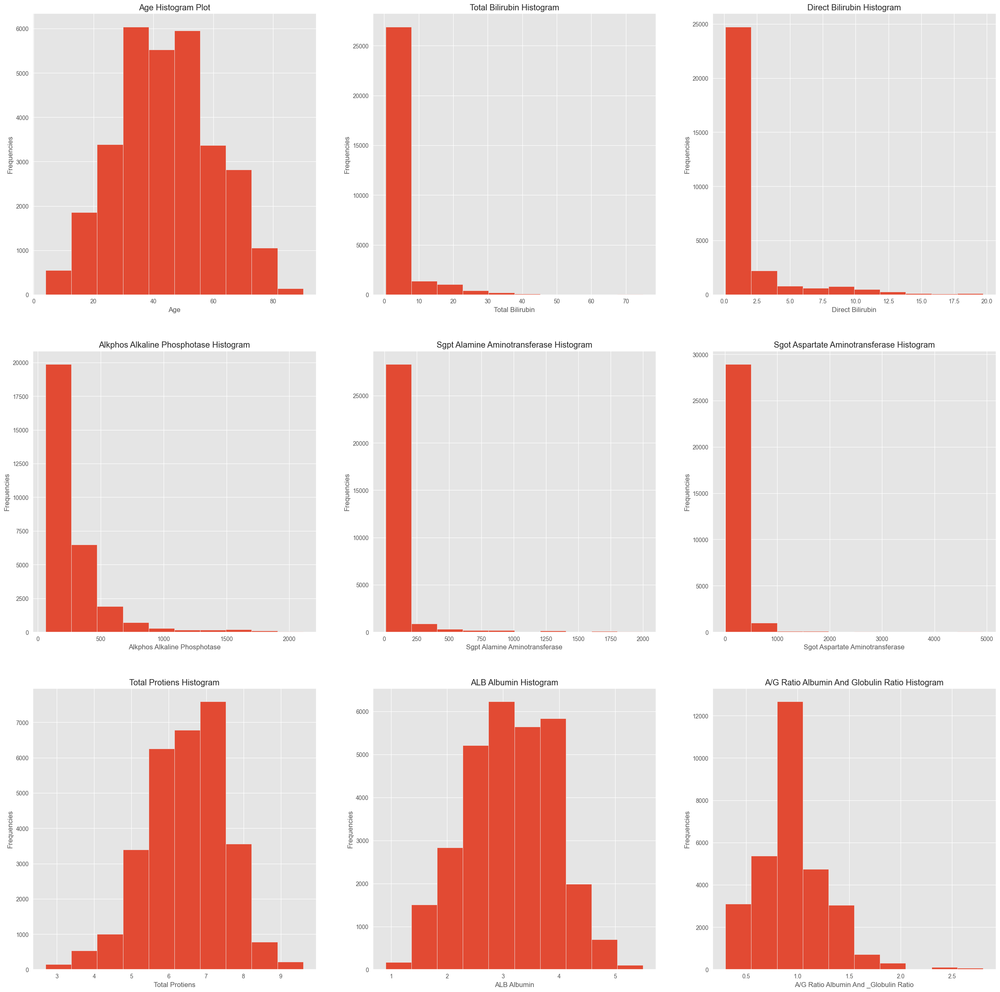

In [37]:
fig, ax = plt.subplots(nrows=3, ncols=3, figsize=(30, 30))
ax[0, 0].hist(Liver['Age']);
ax[0, 0].set(title = 'Age Histogram Plot', xlabel='Age', ylabel = 'Frequencies');

ax[0, 1].hist(Liver['Total_Bilirubin']);
ax[0, 1].set(title = 'Total Bilirubin Histogram', xlabel = "Total Bilirubin", ylabel = 'Frequencies');

ax[0, 2].hist(Liver['Direct_Bilirubin']);
ax[0, 2].set(title = 'Direct Bilirubin Histogram', xlabel = 'Direct Bilirubin', ylabel='Frequencies');

ax[1, 0].hist(Liver['Alkphos_Alkaline_Phosphotase']);
ax[1, 0].set(title = 'Alkphos Alkaline Phosphotase Histogram', xlabel = 'Alkphos Alkaline Phosphotase', ylabel = 'Frequencies');

ax[1, 1].hist(Liver['Sgpt_Alamine_Aminotransferase']);
ax[1, 1].set(title = 'Sgpt Alamine Aminotransferase Histogram', xlabel = 'Sgpt Alamine Aminotransferase', ylabel = 'Frequencies');

ax[1, 2].hist(Liver['Sgot_Aspartate_Aminotransferase']);
ax[1, 2].set(title = 'Sgot Aspartate Aminotransferase Histogram', xlabel = 'Sgot Aspartate Aminotransferase', ylabel = 'Frequencies');

ax[2, 0].hist(Liver['Total_Protiens']);
ax[2, 0].set(title = 'Total Protiens Histogram', xlabel = 'Total Protiens', ylabel = 'Frequencies');

ax[2, 1].hist(Liver['ALB_Albumin']);
ax[2, 1].set(title = 'ALB Albumin Histogram', xlabel = 'ALB Albumin', ylabel = 'Frequencies');

ax[2, 2].hist(Liver['A/G_Ratio_Albumin_And_Globulin_Ratio']);
ax[2, 2].set(title = 'A/G Ratio Albumin And Globulin Ratio Histogram', xlabel = 'A/G Ratio Albumin And _Globulin Ratio', ylabel = 'Frequencies');

**2.BoxenPlot**

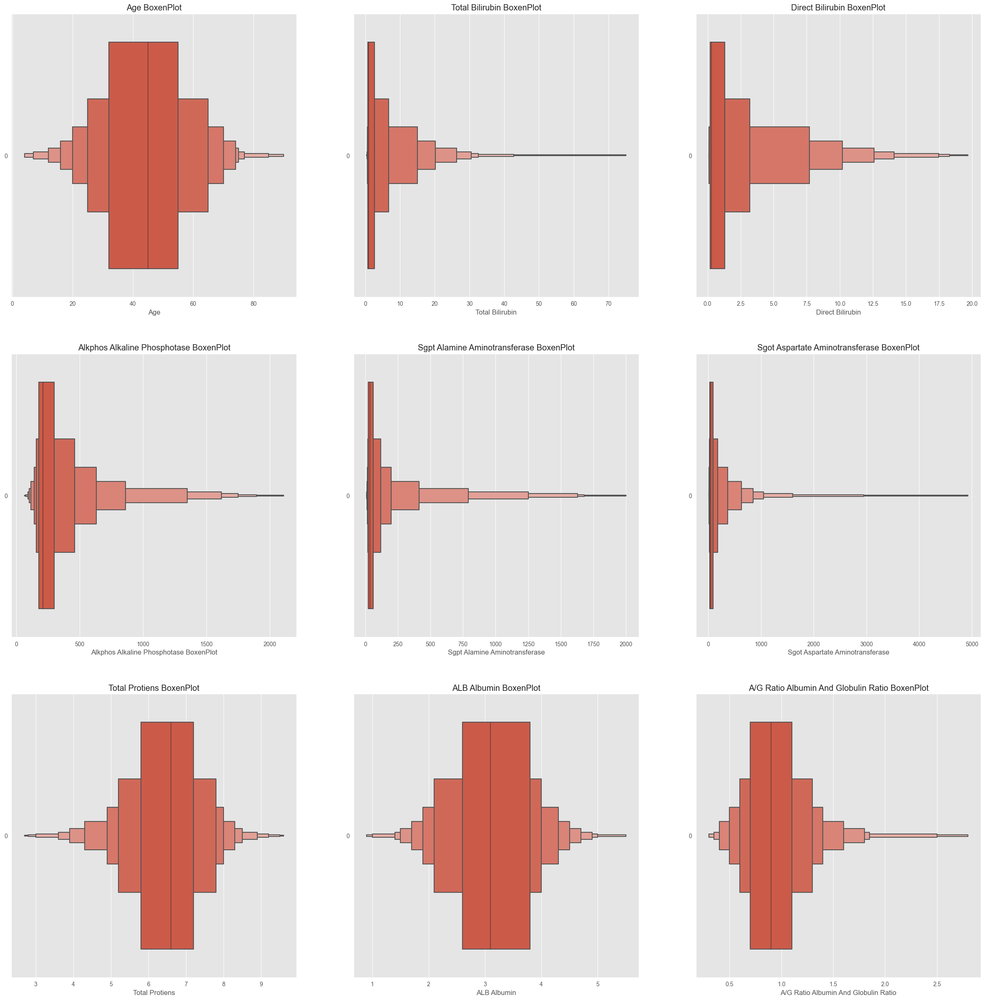

In [38]:
Fig, ((ax1, ax2, ax3), (ax4, ax5, ax6), (ax7, ax8, ax9)) = plt.subplots(nrows=3,
                                                                        ncols=3,
                                                                        figsize = (30, 30))

sns.boxenplot(Liver['Age'], ax=ax1, orient='h');
ax1.set(title = 'Age BoxenPlot', xlabel = 'Age');

sns.boxenplot(Liver['Total_Bilirubin'], ax=ax2,  orient='h');
ax2.set(title= 'Total Bilirubin BoxenPlot', xlabel='Total Bilirubin');

sns.boxenplot(Liver['Direct_Bilirubin'], ax=ax3, orient='h');
ax3.set(title='Direct Bilirubin BoxenPlot', xlabel='Direct Bilirubin');

sns.boxenplot(Liver['Alkphos_Alkaline_Phosphotase'], ax=ax4, orient='h');
ax4.set(title='Alkphos Alkaline Phosphotase BoxenPlot', xlabel='Alkphos Alkaline Phosphotase BoxenPlot');

sns.boxenplot(Liver['Sgpt_Alamine_Aminotransferase'], ax=ax5, orient='h');
ax5.set(title = 'Sgpt Alamine Aminotransferase BoxenPlot', xlabel='Sgpt Alamine Aminotransferase');

sns.boxenplot(Liver['Sgot_Aspartate_Aminotransferase'], ax=ax6, orient='h');
ax6.set(title='Sgot Aspartate Aminotransferase BoxenPlot', xlabel='Sgot Aspartate Aminotransferase');

sns.boxenplot(Liver['Total_Protiens'], ax=ax7, orient='h');
ax7.set(title='Total Protiens BoxenPlot', xlabel='Total Protiens');

sns.boxenplot(Liver['ALB_Albumin'], ax= ax8, orient='h');
ax8.set(title='ALB Albumin BoxenPlot', xlabel='ALB Albumin');


sns.boxenplot(Liver['A/G_Ratio_Albumin_And_Globulin_Ratio'], ax=ax9, orient='h');
ax9.set(title='A/G Ratio Albumin And Globulin Ratio BoxenPlot', xlabel='A/G Ratio Albumin And Globulin Ratio');

**3.StripPlot**

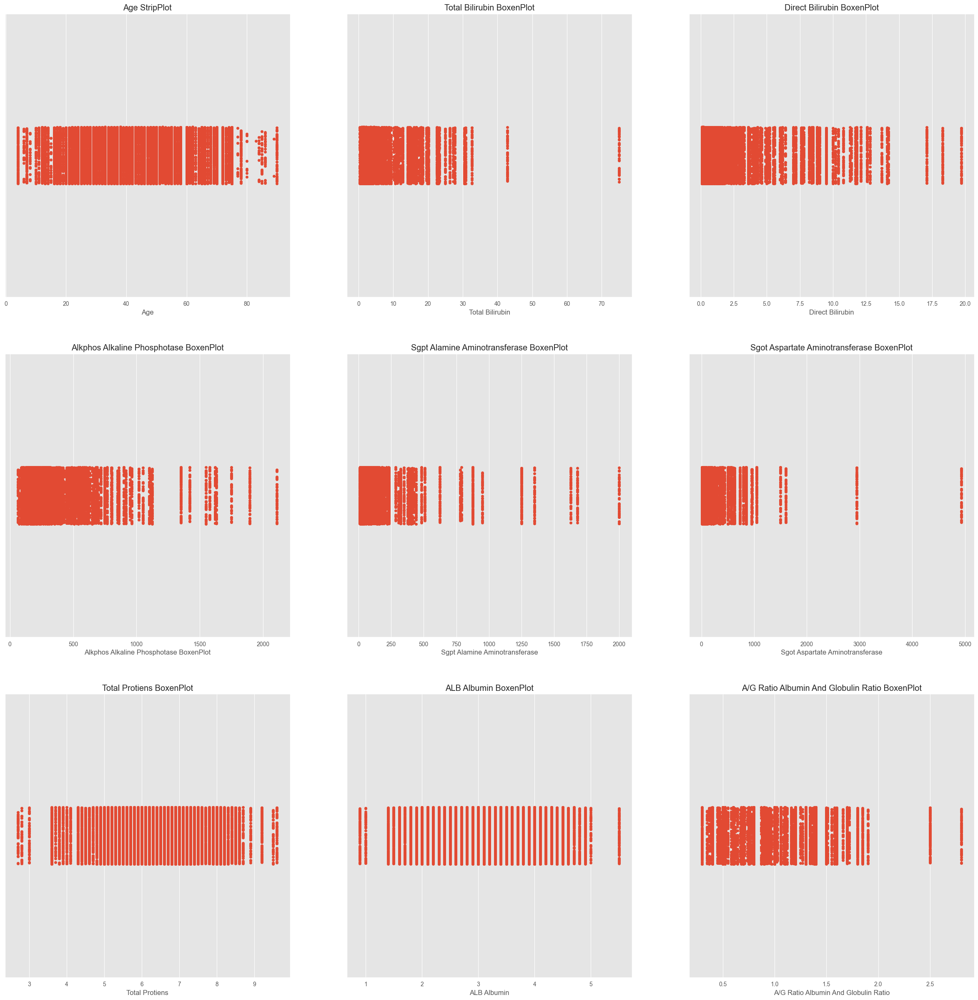

In [39]:
Fig, ((ax1, ax2, ax3), (ax4, ax5, ax6), (ax7, ax8, ax9)) = plt.subplots(nrows=3,
                                                                        ncols=3,
                                                                        figsize = (30, 30))

sns.stripplot(Liver['Age'], ax=ax1, orient='h');
ax1.set(title = 'Age StripPlot', xlabel = 'Age');

sns.stripplot(Liver['Total_Bilirubin'], ax=ax2, orient='h');
ax2.set(title= 'Total Bilirubin BoxenPlot', xlabel='Total Bilirubin');

sns.stripplot(Liver['Direct_Bilirubin'], ax=ax3, orient='h');
ax3.set(title='Direct Bilirubin BoxenPlot', xlabel='Direct Bilirubin');

sns.stripplot(Liver['Alkphos_Alkaline_Phosphotase'], ax=ax4, orient='h');
ax4.set(title='Alkphos Alkaline Phosphotase BoxenPlot', xlabel='Alkphos Alkaline Phosphotase BoxenPlot');

sns.stripplot(Liver['Sgpt_Alamine_Aminotransferase'], ax=ax5, orient='h');
ax5.set(title = 'Sgpt Alamine Aminotransferase BoxenPlot', xlabel='Sgpt Alamine Aminotransferase');

sns.stripplot(Liver['Sgot_Aspartate_Aminotransferase'], ax=ax6, orient='h');
ax6.set(title='Sgot Aspartate Aminotransferase BoxenPlot', xlabel='Sgot Aspartate Aminotransferase');

sns.stripplot(Liver['Total_Protiens'], ax=ax7, orient='h');
ax7.set(title='Total Protiens BoxenPlot', xlabel='Total Protiens');

sns.stripplot(Liver['ALB_Albumin'], ax= ax8, orient='h');
ax8.set(title='ALB Albumin BoxenPlot', xlabel='ALB Albumin');


sns.stripplot(Liver['A/G_Ratio_Albumin_And_Globulin_Ratio'], ax=ax9, orient='h');
ax9.set(title='A/G Ratio Albumin And Globulin Ratio BoxenPlot', xlabel='A/G Ratio Albumin And Globulin Ratio');

**4.CountPlot**

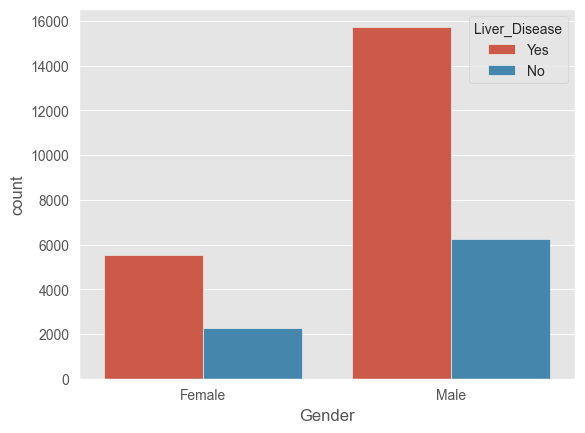

In [40]:
sns.countplot(x=Liver["Gender"], hue=Liver['Liver_Disease']);

**5.PieChart**

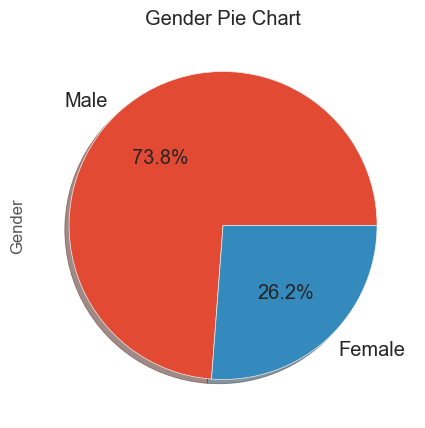

In [41]:
Liver['Gender'].value_counts().plot.pie(autopct = '%0.1f%%',
                                    textprops={'size':'x-large'},
                                    shadow = True,
                                    title = "Gender Pie Chart",
                                    figsize = (5,5),
                                    ylabel = 'Gender');

# Bivariate Data Analysis

**1.ScatterPlot**

*1.1 Age*

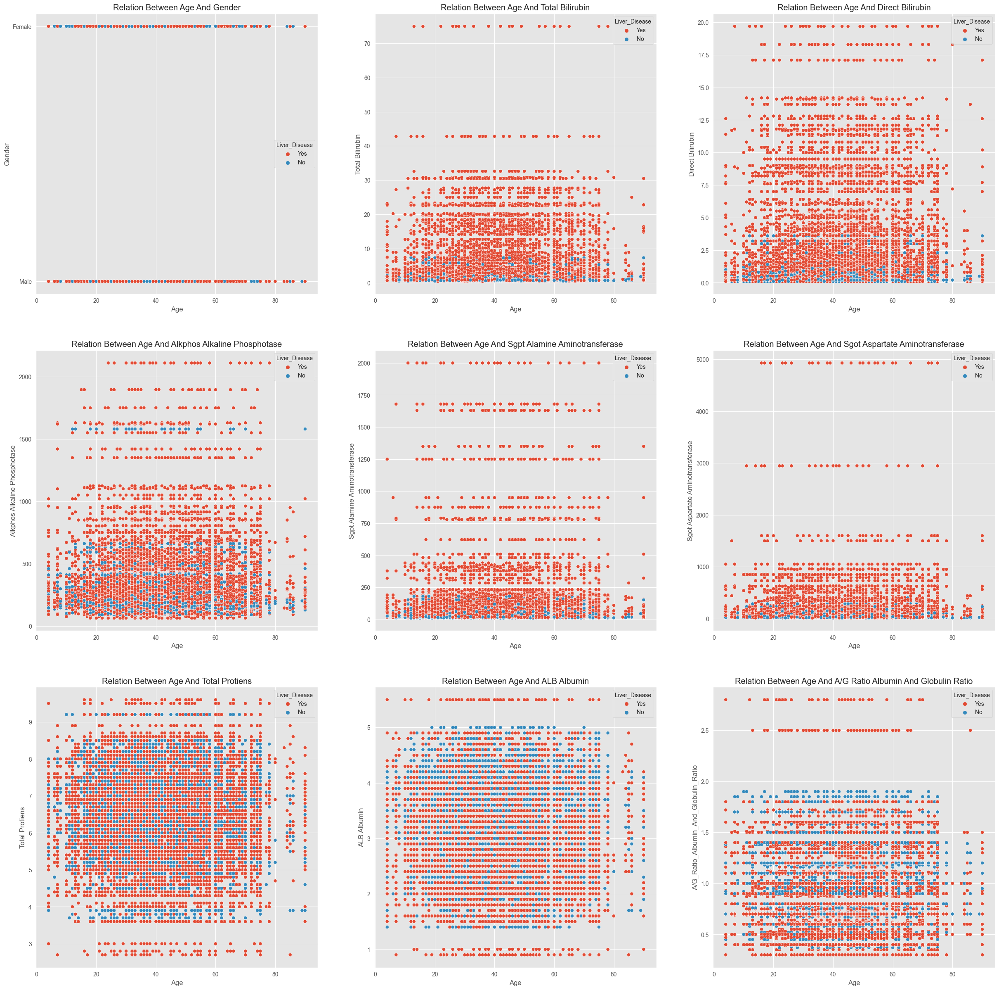

In [42]:
Fig, ((ax1, ax2, ax3),(ax4, ax5, ax6),(ax7, ax8, ax9)) = plt.subplots(nrows=3,
                                            ncols=3,
                                            figsize=(30 , 30))
sns.scatterplot(x =Liver['Age'], y=Liver['Gender'], ax=ax1, hue=Liver['Liver_Disease']);
ax1.set(title = "Relation Between Age And Gender" ,xlabel='Age', ylabel='Gender');

sns.scatterplot(x =Liver['Age'], y=Liver['Total_Bilirubin'], ax=ax2, hue=Liver['Liver_Disease']);
ax2.set(title = "Relation Between Age And Total Bilirubin" ,xlabel='Age', ylabel='Total Bilirubin');

sns.scatterplot(x =Liver['Age'], y=Liver['Direct_Bilirubin'], ax=ax3, hue=Liver['Liver_Disease']);
ax3.set(title = "Relation Between Age And Direct Bilirubin" ,xlabel='Age', ylabel='Direct Bilirubin');


sns.scatterplot(x= Liver['Age'], y=Liver['Alkphos_Alkaline_Phosphotase'], ax=ax4, hue=Liver['Liver_Disease']);
ax4.set(title='Relation Between Age And Alkphos Alkaline Phosphotase', xlabel='Age', ylabel='Alkphos Alkaline Phosphotase');

sns.scatterplot(x= Liver['Age'], y=Liver['Sgpt_Alamine_Aminotransferase'], ax=ax5, hue=Liver['Liver_Disease']);
ax5.set(title='Relation Between Age And Sgpt Alamine Aminotransferase', xlabel='Age', ylabel='Sgpt Alamine Aminotransferase');

sns.scatterplot(x= Liver['Age'], y=Liver['Sgot_Aspartate_Aminotransferase'], ax=ax6, hue=Liver['Liver_Disease']);
ax6.set(title='Relation Between Age And Sgot Aspartate Aminotransferase', xlabel='Age', ylabel='Sgot Aspartate Aminotransferase');

sns.scatterplot(x= Liver['Age'], y=Liver['Total_Protiens'], ax=ax7, hue=Liver['Liver_Disease']);
ax7.set(title='Relation Between Age And Total Protiens', xlabel='Age', ylabel='Total Protiens');

sns.scatterplot(x= Liver['Age'], y=Liver['ALB_Albumin'], ax=ax8, hue=Liver['Liver_Disease']);
ax8.set(title='Relation Between Age And ALB Albumin', xlabel='Age', ylabel='ALB Albumin');

sns.scatterplot(x= Liver['Age'], y=Liver['A/G_Ratio_Albumin_And_Globulin_Ratio'], ax=ax9, hue=Liver['Liver_Disease']);
ax9.set(title='Relation Between Age And A/G Ratio Albumin And Globulin Ratio', xlabel='Age', ylabel='A/G_Ratio_Albumin_And_Globulin_Ratio');

*1.2 Gender*

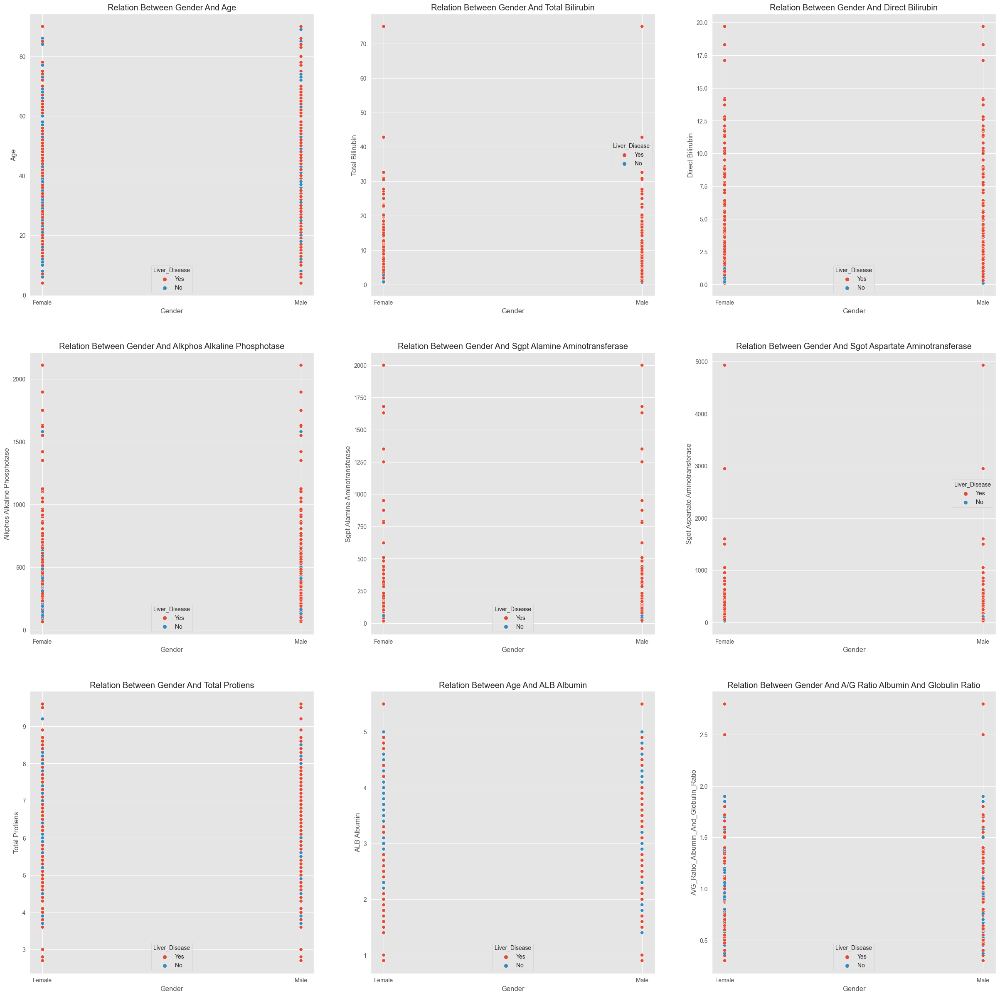

In [43]:
Fig, ((ax1, ax2, ax3),(ax4, ax5, ax6),(ax7, ax8, ax9)) = plt.subplots(nrows=3,
                                            ncols=3,
                                            figsize=(30 , 30))
sns.scatterplot(x =Liver['Gender'], y=Liver['Age'], ax=ax1, hue=Liver['Liver_Disease']);
ax1.set(title = "Relation Between Gender And Age" ,xlabel='Gender', ylabel='Age');

sns.scatterplot(x =Liver['Gender'], y=Liver['Total_Bilirubin'], ax=ax2, hue=Liver['Liver_Disease']);
ax2.set(title = "Relation Between Gender And Total Bilirubin" ,xlabel='Gender', ylabel='Total Bilirubin');

sns.scatterplot(x =Liver['Gender'], y=Liver['Direct_Bilirubin'], ax=ax3, hue=Liver['Liver_Disease']);
ax3.set(title = "Relation Between Gender And Direct Bilirubin" ,xlabel='Gender', ylabel='Direct Bilirubin');


sns.scatterplot(x= Liver['Gender'], y=Liver['Alkphos_Alkaline_Phosphotase'], ax=ax4, hue=Liver['Liver_Disease']);
ax4.set(title='Relation Between Gender And Alkphos Alkaline Phosphotase', xlabel='Gender', ylabel='Alkphos Alkaline Phosphotase');

sns.scatterplot(x= Liver['Gender'], y=Liver['Sgpt_Alamine_Aminotransferase'], ax=ax5, hue=Liver['Liver_Disease']);
ax5.set(title='Relation Between Gender And Sgpt Alamine Aminotransferase', xlabel='Gender', ylabel='Sgpt Alamine Aminotransferase');

sns.scatterplot(x= Liver['Gender'], y=Liver['Sgot_Aspartate_Aminotransferase'], ax=ax6, hue=Liver['Liver_Disease']);
ax6.set(title='Relation Between Gender And Sgot Aspartate Aminotransferase', xlabel='Gender', ylabel='Sgot Aspartate Aminotransferase');

sns.scatterplot(x= Liver['Gender'], y=Liver['Total_Protiens'], ax=ax7, hue=Liver['Liver_Disease']);
ax7.set(title='Relation Between Gender And Total Protiens', xlabel='Gender', ylabel='Total Protiens');

sns.scatterplot(x= Liver['Gender'], y=Liver['ALB_Albumin'], ax=ax8, hue=Liver['Liver_Disease']);
ax8.set(title='Relation Between Age And ALB Albumin', xlabel='Gender', ylabel='ALB Albumin');

sns.scatterplot(x= Liver['Gender'], y=Liver['A/G_Ratio_Albumin_And_Globulin_Ratio'], ax=ax9, hue=Liver['Liver_Disease']);
ax9.set(title='Relation Between Gender And A/G Ratio Albumin And Globulin Ratio', xlabel='Gender', ylabel='A/G_Ratio_Albumin_And_Globulin_Ratio');

*1.3 Total Bilirubin*

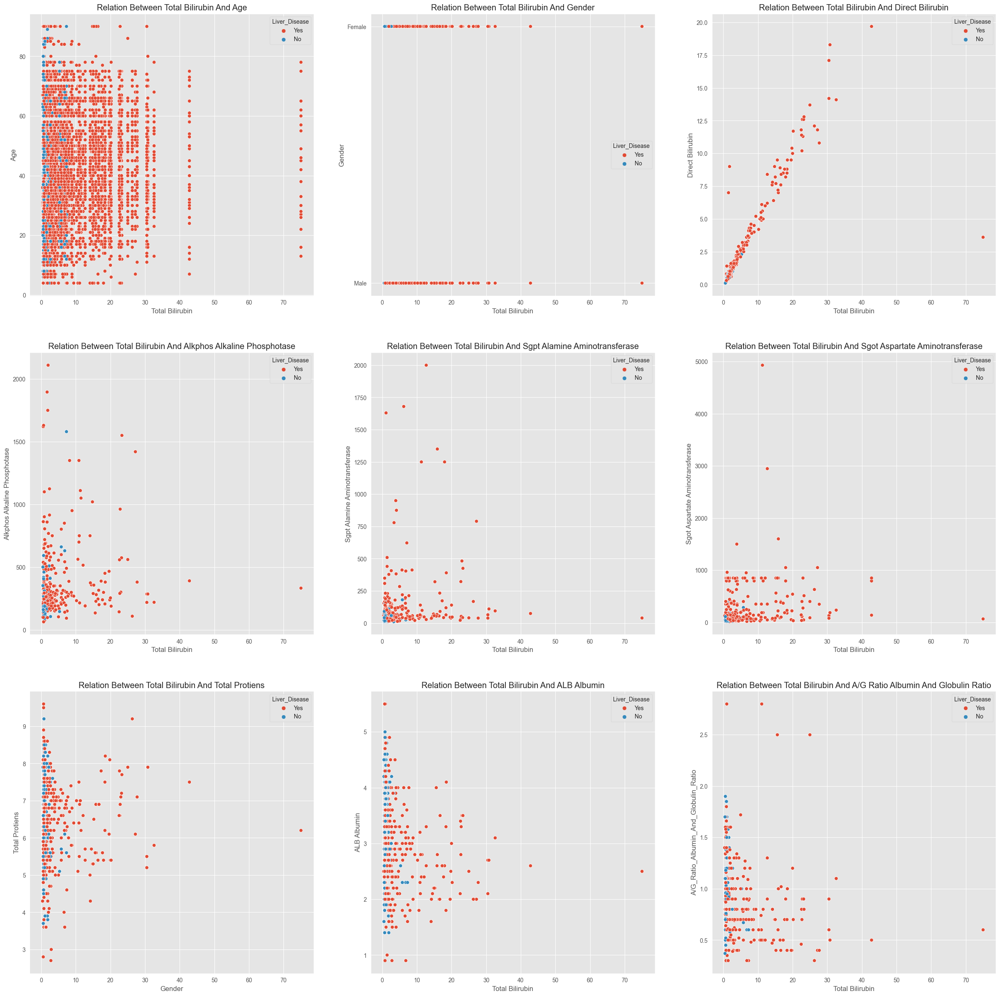

In [44]:
Fig, ((ax1, ax2, ax3),(ax4, ax5, ax6),(ax7, ax8, ax9)) = plt.subplots(nrows=3,
                                            ncols=3,
                                            figsize=(30 , 30))
sns.scatterplot(x =Liver['Total_Bilirubin'], y=Liver['Age'], ax=ax1, hue=Liver['Liver_Disease']);
ax1.set(title = "Relation Between Total Bilirubin And Age" ,xlabel='Total Bilirubin', ylabel='Age');

sns.scatterplot(x =Liver['Total_Bilirubin'], y=Liver['Gender'], ax=ax2, hue=Liver['Liver_Disease']);
ax2.set(title = "Relation Between Total Bilirubin And Gender" ,xlabel='Total Bilirubin', ylabel='Gender');

sns.scatterplot(x =Liver['Total_Bilirubin'], y=Liver['Direct_Bilirubin'], ax=ax3, hue=Liver['Liver_Disease']);
ax3.set(title = "Relation Between Total Bilirubin And Direct Bilirubin" ,xlabel='Total Bilirubin', ylabel='Direct Bilirubin');

sns.scatterplot(x= Liver['Total_Bilirubin'], y=Liver['Alkphos_Alkaline_Phosphotase'], ax=ax4, hue=Liver['Liver_Disease']);
ax4.set(title='Relation Between Total Bilirubin And Alkphos Alkaline Phosphotase', xlabel='Total Bilirubin', ylabel='Alkphos Alkaline Phosphotase');

sns.scatterplot(x= Liver['Total_Bilirubin'], y=Liver['Sgpt_Alamine_Aminotransferase'], ax=ax5, hue=Liver['Liver_Disease']);
ax5.set(title='Relation Between Total Bilirubin And Sgpt Alamine Aminotransferase', xlabel='Total Bilirubin', ylabel='Sgpt Alamine Aminotransferase');

sns.scatterplot(x= Liver['Total_Bilirubin'], y=Liver['Sgot_Aspartate_Aminotransferase'], ax=ax6, hue=Liver['Liver_Disease']);
ax6.set(title='Relation Between Total Bilirubin And Sgot Aspartate Aminotransferase', xlabel='Total Bilirubin', ylabel='Sgot Aspartate Aminotransferase');

sns.scatterplot(x= Liver['Total_Bilirubin'], y=Liver['Total_Protiens'], ax=ax7, hue=Liver['Liver_Disease']);
ax7.set(title='Relation Between Total Bilirubin And Total Protiens', xlabel='Gender', ylabel='Total Protiens');

sns.scatterplot(x= Liver['Total_Bilirubin'], y=Liver['ALB_Albumin'], ax=ax8, hue=Liver['Liver_Disease']);
ax8.set(title='Relation Between Total Bilirubin And ALB Albumin', xlabel='Total Bilirubin', ylabel='ALB Albumin');

sns.scatterplot(x= Liver['Total_Bilirubin'], y=Liver['A/G_Ratio_Albumin_And_Globulin_Ratio'], ax=ax9, hue=Liver['Liver_Disease']);
ax9.set(title='Relation Between Total Bilirubin And A/G Ratio Albumin And Globulin Ratio', xlabel='Total Bilirubin', ylabel='A/G_Ratio_Albumin_And_Globulin_Ratio');

*1.4 Direct Bilirubin*

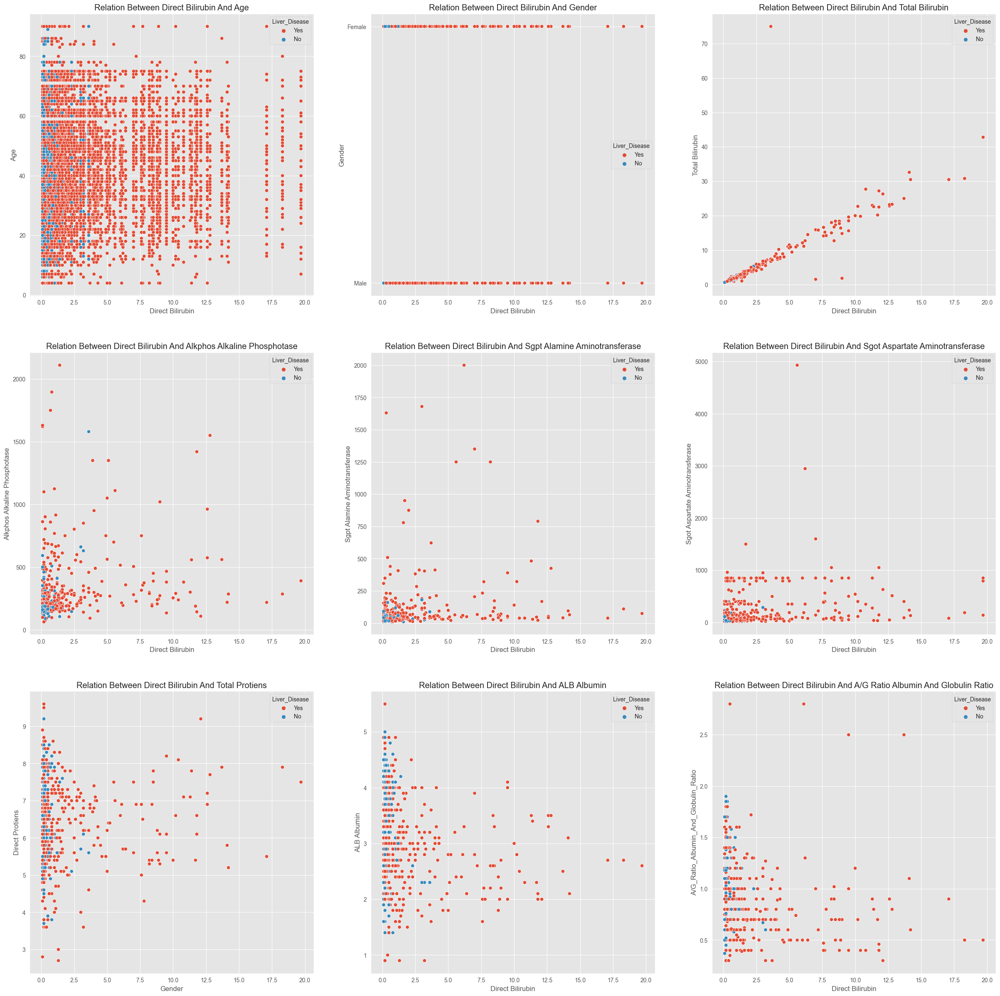

In [45]:
Fig, ((ax1, ax2, ax3),(ax4, ax5, ax6),(ax7, ax8, ax9)) = plt.subplots(nrows=3,
                                            ncols=3,
                                            figsize=(30 , 30))
sns.scatterplot(x =Liver['Direct_Bilirubin'], y=Liver['Age'], ax=ax1, hue=Liver['Liver_Disease']);
ax1.set(title = "Relation Between Direct Bilirubin And Age" ,xlabel='Direct Bilirubin', ylabel='Age');

sns.scatterplot(x =Liver['Direct_Bilirubin'], y=Liver['Gender'], ax=ax2, hue=Liver['Liver_Disease']);
ax2.set(title = "Relation Between Direct Bilirubin And Gender" ,xlabel='Direct Bilirubin', ylabel='Gender');

sns.scatterplot(x =Liver['Direct_Bilirubin'], y=Liver['Total_Bilirubin'], ax=ax3, hue=Liver['Liver_Disease']);
ax3.set(title = "Relation Between Direct Bilirubin And Total Bilirubin" ,xlabel='Direct Bilirubin', ylabel='Total Bilirubin');

sns.scatterplot(x= Liver['Direct_Bilirubin'], y=Liver['Alkphos_Alkaline_Phosphotase'], ax=ax4, hue=Liver['Liver_Disease']);
ax4.set(title='Relation Between Direct Bilirubin And Alkphos Alkaline Phosphotase', xlabel='Direct Bilirubin', ylabel='Alkphos Alkaline Phosphotase');

sns.scatterplot(x= Liver['Direct_Bilirubin'], y=Liver['Sgpt_Alamine_Aminotransferase'], ax=ax5, hue=Liver['Liver_Disease']);
ax5.set(title='Relation Between Direct Bilirubin And Sgpt Alamine Aminotransferase', xlabel='Direct Bilirubin', ylabel='Sgpt Alamine Aminotransferase');

sns.scatterplot(x= Liver['Direct_Bilirubin'], y=Liver['Sgot_Aspartate_Aminotransferase'], ax=ax6, hue=Liver['Liver_Disease']);
ax6.set(title='Relation Between Direct Bilirubin And Sgot Aspartate Aminotransferase', xlabel='Direct Bilirubin', ylabel='Sgot Aspartate Aminotransferase');

sns.scatterplot(x= Liver['Direct_Bilirubin'], y=Liver['Total_Protiens'], ax=ax7, hue=Liver['Liver_Disease']);
ax7.set(title='Relation Between Direct Bilirubin And Total Protiens', xlabel='Gender', ylabel='Direct Protiens');

sns.scatterplot(x= Liver['Direct_Bilirubin'], y=Liver['ALB_Albumin'], ax=ax8, hue=Liver['Liver_Disease']);
ax8.set(title='Relation Between Direct Bilirubin And ALB Albumin', xlabel='Direct Bilirubin', ylabel='ALB Albumin');

sns.scatterplot(x= Liver['Direct_Bilirubin'], y=Liver['A/G_Ratio_Albumin_And_Globulin_Ratio'], ax=ax9, hue=Liver['Liver_Disease']);
ax9.set(title='Relation Between Direct Bilirubin And A/G Ratio Albumin And Globulin Ratio', xlabel='Direct Bilirubin', ylabel='A/G_Ratio_Albumin_And_Globulin_Ratio');

*1.5 Alkphos Alkaline Phosphotase*

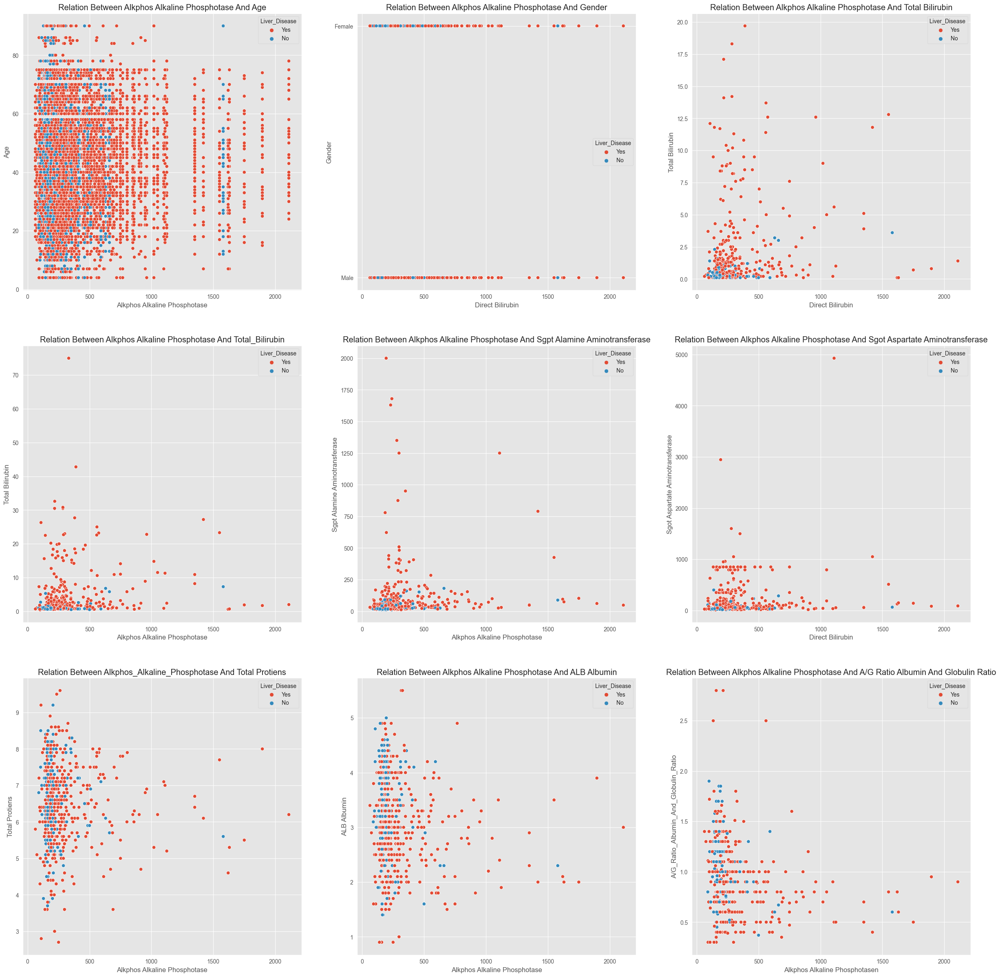

In [46]:
Fig, ((ax1, ax2, ax3),(ax4, ax5, ax6),(ax7, ax8, ax9)) = plt.subplots(nrows=3,
                                            ncols=3,
                                            figsize=(30 , 30))
sns.scatterplot(x =Liver['Alkphos_Alkaline_Phosphotase'], y=Liver['Age'], ax=ax1, hue=Liver['Liver_Disease']);
ax1.set(title = "Relation Between Alkphos Alkaline Phosphotase And Age" ,xlabel='Alkphos Alkaline Phosphotase', ylabel='Age');

sns.scatterplot(x =Liver['Alkphos_Alkaline_Phosphotase'], y=Liver['Gender'], ax=ax2, hue=Liver['Liver_Disease']);
ax2.set(title = "Relation Between Alkphos Alkaline Phosphotase And Gender" ,xlabel='Direct Bilirubin', ylabel='Gender');

sns.scatterplot(x =Liver['Alkphos_Alkaline_Phosphotase'], y=Liver['Direct_Bilirubin'], ax=ax3, hue=Liver['Liver_Disease']);
ax3.set(title = "Relation Between Alkphos Alkaline Phosphotase And Total Bilirubin" ,xlabel='Direct Bilirubin', ylabel='Total Bilirubin');

sns.scatterplot(x= Liver['Alkphos_Alkaline_Phosphotase'], y=Liver['Total_Bilirubin'], ax=ax4, hue=Liver['Liver_Disease']);
ax4.set(title='Relation Between Alkphos Alkaline Phosphotase And Total_Bilirubin', xlabel='Alkphos Alkaline Phosphotase', ylabel='Total Bilirubin');

sns.scatterplot(x= Liver['Alkphos_Alkaline_Phosphotase'], y=Liver['Sgpt_Alamine_Aminotransferase'], ax=ax5, hue=Liver['Liver_Disease']);
ax5.set(title='Relation Between Alkphos Alkaline Phosphotase And Sgpt Alamine Aminotransferase', xlabel='Alkphos Alkaline Phosphotase', ylabel='Sgpt Alamine Aminotransferase');

sns.scatterplot(x= Liver['Alkphos_Alkaline_Phosphotase'], y=Liver['Sgot_Aspartate_Aminotransferase'], ax=ax6, hue=Liver['Liver_Disease']);
ax6.set(title='Relation Between Alkphos Alkaline Phosphotase And Sgot Aspartate Aminotransferase', xlabel='Direct Bilirubin', ylabel='Sgot Aspartate Aminotransferase');

sns.scatterplot(x= Liver['Alkphos_Alkaline_Phosphotase'], y=Liver['Total_Protiens'], ax=ax7, hue=Liver['Liver_Disease']);
ax7.set(title='Relation Between Alkphos_Alkaline_Phosphotase And Total Protiens', xlabel='Alkphos Alkaline Phosphotase', ylabel='Total Protiens');

sns.scatterplot(x= Liver['Alkphos_Alkaline_Phosphotase'], y=Liver['ALB_Albumin'], ax=ax8, hue=Liver['Liver_Disease']);
ax8.set(title='Relation Between Alkphos Alkaline Phosphotase And ALB Albumin', xlabel='Alkphos Alkaline Phosphotase', ylabel='ALB Albumin');

sns.scatterplot(x= Liver['Alkphos_Alkaline_Phosphotase'], y=Liver['A/G_Ratio_Albumin_And_Globulin_Ratio'], ax=ax9, hue=Liver['Liver_Disease']);
ax9.set(title='Relation Between Alkphos Alkaline Phosphotase And A/G Ratio Albumin And Globulin Ratio', xlabel='Alkphos Alkaline Phosphotasen', ylabel='A/G_Ratio_Albumin_And_Globulin_Ratio');

*1.6 Sgpt Alamine Aminotransferase*

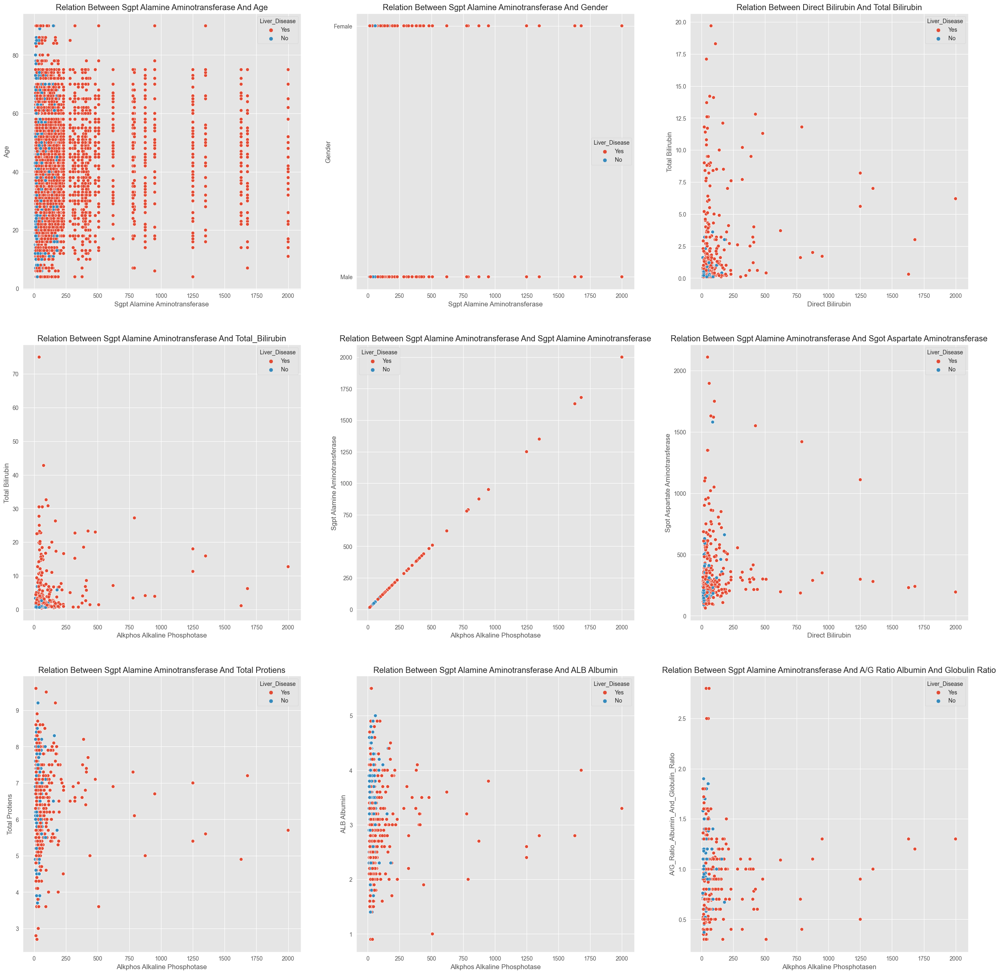

In [47]:
Fig, ((ax1, ax2, ax3),(ax4, ax5, ax6),(ax7, ax8, ax9)) = plt.subplots(nrows=3,
                                            ncols=3,
                                            figsize=(30 , 30))
sns.scatterplot(x =Liver['Sgpt_Alamine_Aminotransferase'], y=Liver['Age'], ax=ax1, hue=Liver['Liver_Disease']);
ax1.set(title = "Relation Between Sgpt Alamine Aminotransferase And Age" ,xlabel='Sgpt Alamine Aminotransferase', ylabel='Age');

sns.scatterplot(x =Liver['Sgpt_Alamine_Aminotransferase'], y=Liver['Gender'], ax=ax2, hue=Liver['Liver_Disease']);
ax2.set(title = "Relation Between Sgpt Alamine Aminotransferase And Gender" ,xlabel='Sgpt Alamine Aminotransferase', ylabel='Gender');

sns.scatterplot(x =Liver['Sgpt_Alamine_Aminotransferase'], y=Liver['Direct_Bilirubin'], ax=ax3, hue=Liver['Liver_Disease']);
ax3.set(title = "Relation Between Direct Bilirubin And Total Bilirubin" ,xlabel='Direct Bilirubin', ylabel='Total Bilirubin');

sns.scatterplot(x= Liver['Sgpt_Alamine_Aminotransferase'], y=Liver['Total_Bilirubin'], ax=ax4, hue=Liver['Liver_Disease']);
ax4.set(title='Relation Between Sgpt Alamine Aminotransferase And Total_Bilirubin', xlabel='Alkphos Alkaline Phosphotase', ylabel='Total Bilirubin');

sns.scatterplot(x= Liver['Sgpt_Alamine_Aminotransferase'], y=Liver['Sgpt_Alamine_Aminotransferase'], ax=ax5, hue=Liver['Liver_Disease']);
ax5.set(title='Relation Between Sgpt Alamine Aminotransferase And Sgpt Alamine Aminotransferase', xlabel='Alkphos Alkaline Phosphotase', ylabel='Sgpt Alamine Aminotransferase');

sns.scatterplot(x= Liver['Sgpt_Alamine_Aminotransferase'], y=Liver['Alkphos_Alkaline_Phosphotase'], ax=ax6, hue=Liver['Liver_Disease']);
ax6.set(title='Relation Between Sgpt Alamine Aminotransferase And Sgot Aspartate Aminotransferase', xlabel='Direct Bilirubin', ylabel='Sgot Aspartate Aminotransferase');

sns.scatterplot(x= Liver['Sgpt_Alamine_Aminotransferase'], y=Liver['Total_Protiens'], ax=ax7, hue=Liver['Liver_Disease']);
ax7.set(title='Relation Between Sgpt Alamine Aminotransferase And Total Protiens', xlabel='Alkphos Alkaline Phosphotase', ylabel='Total Protiens');

sns.scatterplot(x= Liver['Sgpt_Alamine_Aminotransferase'], y=Liver['ALB_Albumin'], ax=ax8, hue=Liver['Liver_Disease']);
ax8.set(title='Relation Between Sgpt Alamine Aminotransferase And ALB Albumin', xlabel='Alkphos Alkaline Phosphotase', ylabel='ALB Albumin');

sns.scatterplot(x= Liver['Sgpt_Alamine_Aminotransferase'], y=Liver['A/G_Ratio_Albumin_And_Globulin_Ratio'], ax=ax9, hue=Liver['Liver_Disease']);
ax9.set(title='Relation Between Sgpt Alamine Aminotransferase And A/G Ratio Albumin And Globulin Ratio', xlabel='Alkphos Alkaline Phosphotasen', ylabel='A/G_Ratio_Albumin_And_Globulin_Ratio');

*1.7 Sgot Aspartate Aminotransferase*

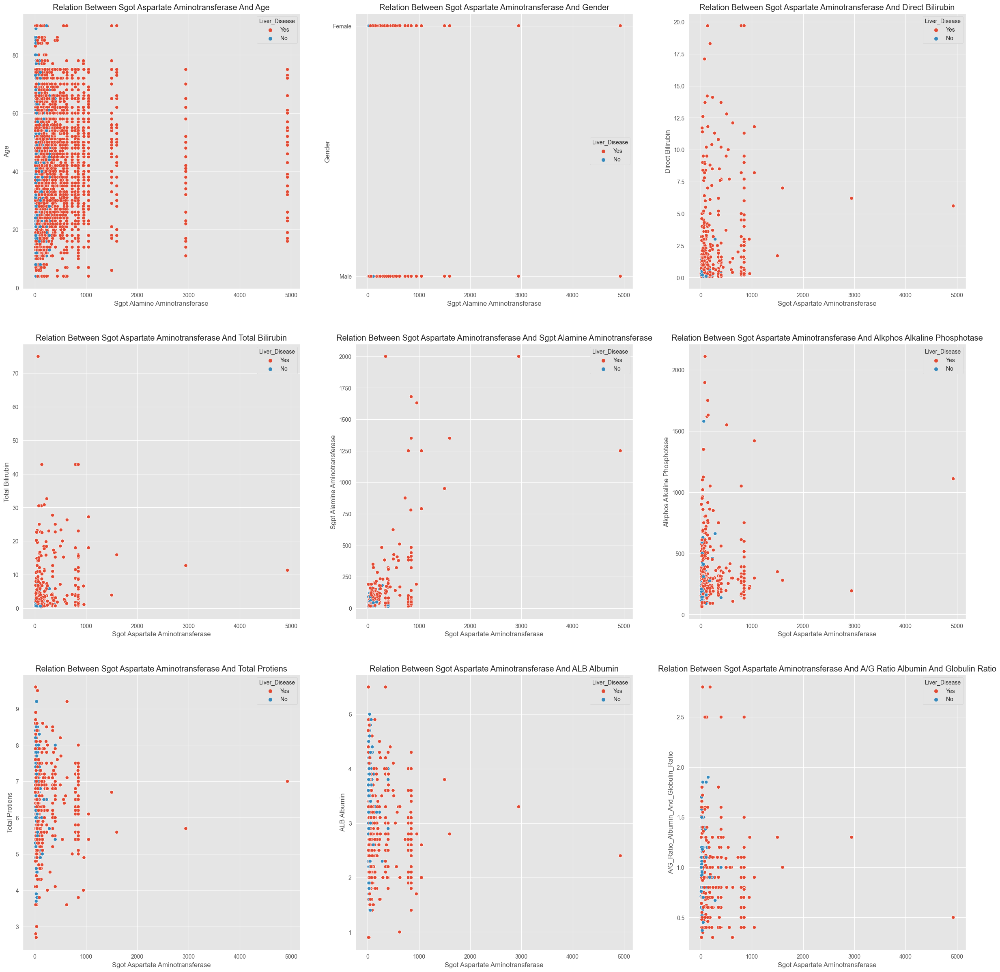

In [48]:
Fig, ((ax1, ax2, ax3),(ax4, ax5, ax6),(ax7, ax8, ax9)) = plt.subplots(nrows=3,
                                            ncols=3,
                                            figsize=(30 , 30))
sns.scatterplot(x =Liver['Sgot_Aspartate_Aminotransferase'], y=Liver['Age'], ax=ax1, hue=Liver['Liver_Disease']);
ax1.set(title = "Relation Between Sgot Aspartate Aminotransferase And Age" ,xlabel='Sgpt Alamine Aminotransferase', ylabel='Age');

sns.scatterplot(x =Liver['Sgot_Aspartate_Aminotransferase'], y=Liver['Gender'], ax=ax2, hue=Liver['Liver_Disease']);
ax2.set(title = "Relation Between Sgot Aspartate Aminotransferase And Gender" ,xlabel='Sgpt Alamine Aminotransferase', ylabel='Gender');

sns.scatterplot(x =Liver['Sgot_Aspartate_Aminotransferase'], y=Liver['Direct_Bilirubin'], ax=ax3, hue=Liver['Liver_Disease']);
ax3.set(title = "Relation Between Sgot Aspartate Aminotransferase And Direct Bilirubin" ,xlabel='Sgot Aspartate Aminotransferase', ylabel='Direct Bilirubin');

sns.scatterplot(x= Liver['Sgot_Aspartate_Aminotransferase'], y=Liver['Total_Bilirubin'], ax=ax4, hue=Liver['Liver_Disease']);
ax4.set(title='Relation Between Sgot Aspartate Aminotransferase And Total Bilirubin', xlabel='Sgot Aspartate Aminotransferase', ylabel='Total Bilirubin');

sns.scatterplot(x= Liver['Sgot_Aspartate_Aminotransferase'], y=Liver['Sgpt_Alamine_Aminotransferase'], ax=ax5, hue=Liver['Liver_Disease']);
ax5.set(title='Relation Between Sgot Aspartate Aminotransferase And Sgpt Alamine Aminotransferase', xlabel='Sgot Aspartate Aminotransferase', ylabel='Sgpt Alamine Aminotransferase');

sns.scatterplot(x= Liver['Sgot_Aspartate_Aminotransferase'], y=Liver['Alkphos_Alkaline_Phosphotase'], ax=ax6, hue=Liver['Liver_Disease']);
ax6.set(title='Relation Between Sgot Aspartate Aminotransferase And Alkphos Alkaline Phosphotase', xlabel='Sgot Aspartate Aminotransferase', ylabel='Alkphos Alkaline Phosphotase');

sns.scatterplot(x= Liver['Sgot_Aspartate_Aminotransferase'], y=Liver['Total_Protiens'], ax=ax7, hue=Liver['Liver_Disease']);
ax7.set(title='Relation Between Sgot Aspartate Aminotransferase And Total Protiens', xlabel='Sgot Aspartate Aminotransferase', ylabel='Total Protiens');

sns.scatterplot(x= Liver['Sgot_Aspartate_Aminotransferase'], y=Liver['ALB_Albumin'], ax=ax8, hue=Liver['Liver_Disease']);
ax8.set(title='Relation Between Sgot Aspartate Aminotransferase And ALB Albumin', xlabel='Sgot Aspartate Aminotransferase', ylabel='ALB Albumin');

sns.scatterplot(x= Liver['Sgot_Aspartate_Aminotransferase'], y=Liver['A/G_Ratio_Albumin_And_Globulin_Ratio'], ax=ax9, hue=Liver['Liver_Disease']);
ax9.set(title='Relation Between Sgot Aspartate Aminotransferase And A/G Ratio Albumin And Globulin Ratio', xlabel='Sgot Aspartate Aminotransferase', ylabel='A/G_Ratio_Albumin_And_Globulin_Ratio');

*1.8 Total Protiens*

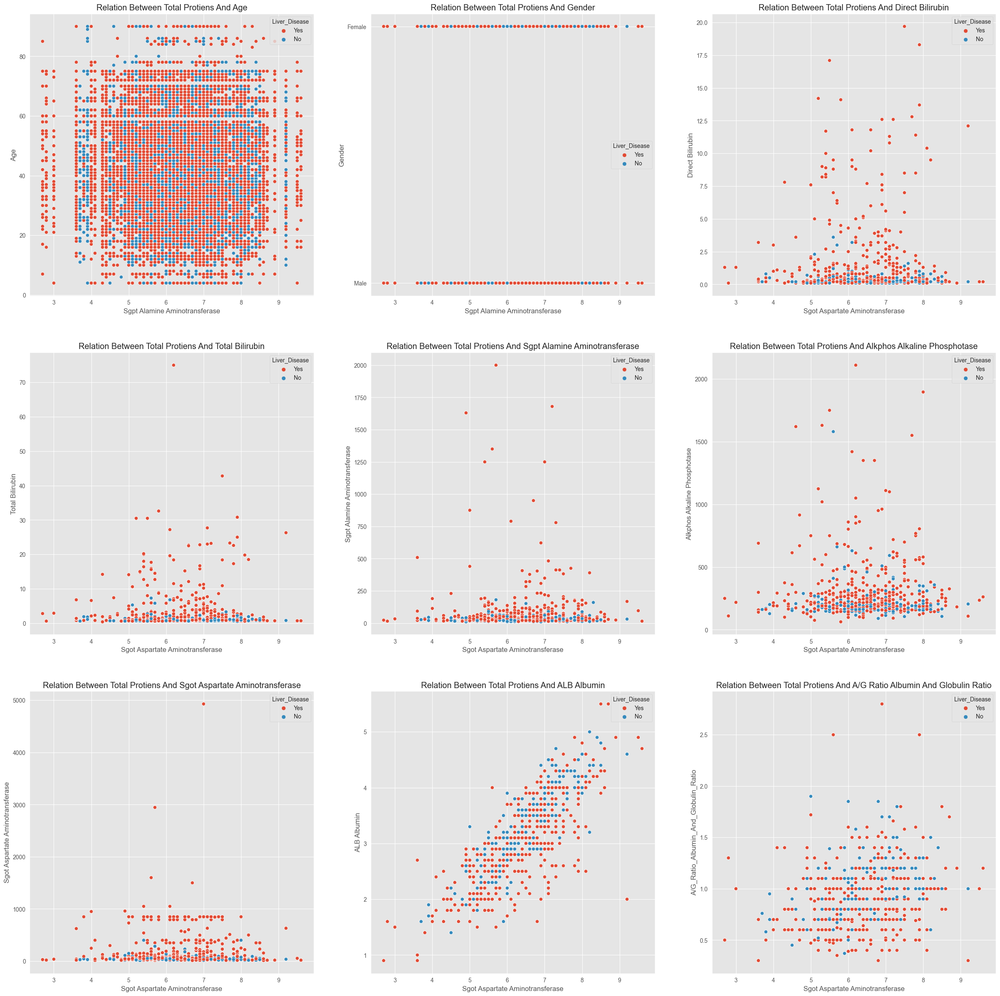

In [49]:
Fig, ((ax1, ax2, ax3),(ax4, ax5, ax6),(ax7, ax8, ax9)) = plt.subplots(nrows=3,
                                            ncols=3,
                                            figsize=(30 , 30))
sns.scatterplot(x =Liver['Total_Protiens'], y=Liver['Age'], ax=ax1, hue=Liver['Liver_Disease']);
ax1.set(title = "Relation Between Total Protiens And Age" ,xlabel='Sgpt Alamine Aminotransferase', ylabel='Age');

sns.scatterplot(x =Liver['Total_Protiens'], y=Liver['Gender'], ax=ax2, hue=Liver['Liver_Disease']);
ax2.set(title = "Relation Between Total Protiens And Gender" ,xlabel='Sgpt Alamine Aminotransferase', ylabel='Gender');

sns.scatterplot(x =Liver['Total_Protiens'], y=Liver['Direct_Bilirubin'], ax=ax3, hue=Liver['Liver_Disease']);
ax3.set(title = "Relation Between Total Protiens And Direct Bilirubin" ,xlabel='Sgot Aspartate Aminotransferase', ylabel='Direct Bilirubin');

sns.scatterplot(x= Liver['Total_Protiens'], y=Liver['Total_Bilirubin'], ax=ax4, hue=Liver['Liver_Disease']);
ax4.set(title='Relation Between Total Protiens And Total Bilirubin', xlabel='Sgot Aspartate Aminotransferase', ylabel='Total Bilirubin');

sns.scatterplot(x= Liver['Total_Protiens'], y=Liver['Sgpt_Alamine_Aminotransferase'], ax=ax5, hue=Liver['Liver_Disease']);
ax5.set(title='Relation Between Total Protiens And Sgpt Alamine Aminotransferase', xlabel='Sgot Aspartate Aminotransferase', ylabel='Sgpt Alamine Aminotransferase');

sns.scatterplot(x= Liver['Total_Protiens'], y=Liver['Alkphos_Alkaline_Phosphotase'], ax=ax6, hue=Liver['Liver_Disease']);
ax6.set(title='Relation Between Total Protiens And Alkphos Alkaline Phosphotase', xlabel='Sgot Aspartate Aminotransferase', ylabel='Alkphos Alkaline Phosphotase');

sns.scatterplot(x= Liver['Total_Protiens'], y=Liver['Sgot_Aspartate_Aminotransferase'], ax=ax7, hue=Liver['Liver_Disease']);
ax7.set(title='Relation Between Total Protiens And Sgot Aspartate Aminotransferase', xlabel='Sgot Aspartate Aminotransferase', ylabel='Sgot Aspartate Aminotransferase');

sns.scatterplot(x= Liver['Total_Protiens'], y=Liver['ALB_Albumin'], ax=ax8, hue=Liver['Liver_Disease']);
ax8.set(title='Relation Between Total Protiens And ALB Albumin', xlabel='Sgot Aspartate Aminotransferase', ylabel='ALB Albumin');

sns.scatterplot(x= Liver['Total_Protiens'], y=Liver['A/G_Ratio_Albumin_And_Globulin_Ratio'], ax=ax9, hue=Liver['Liver_Disease']);
ax9.set(title='Relation Between Total Protiens And A/G Ratio Albumin And Globulin Ratio', xlabel='Sgot Aspartate Aminotransferase', ylabel='A/G_Ratio_Albumin_And_Globulin_Ratio');

*1.9 ALB Albumin*

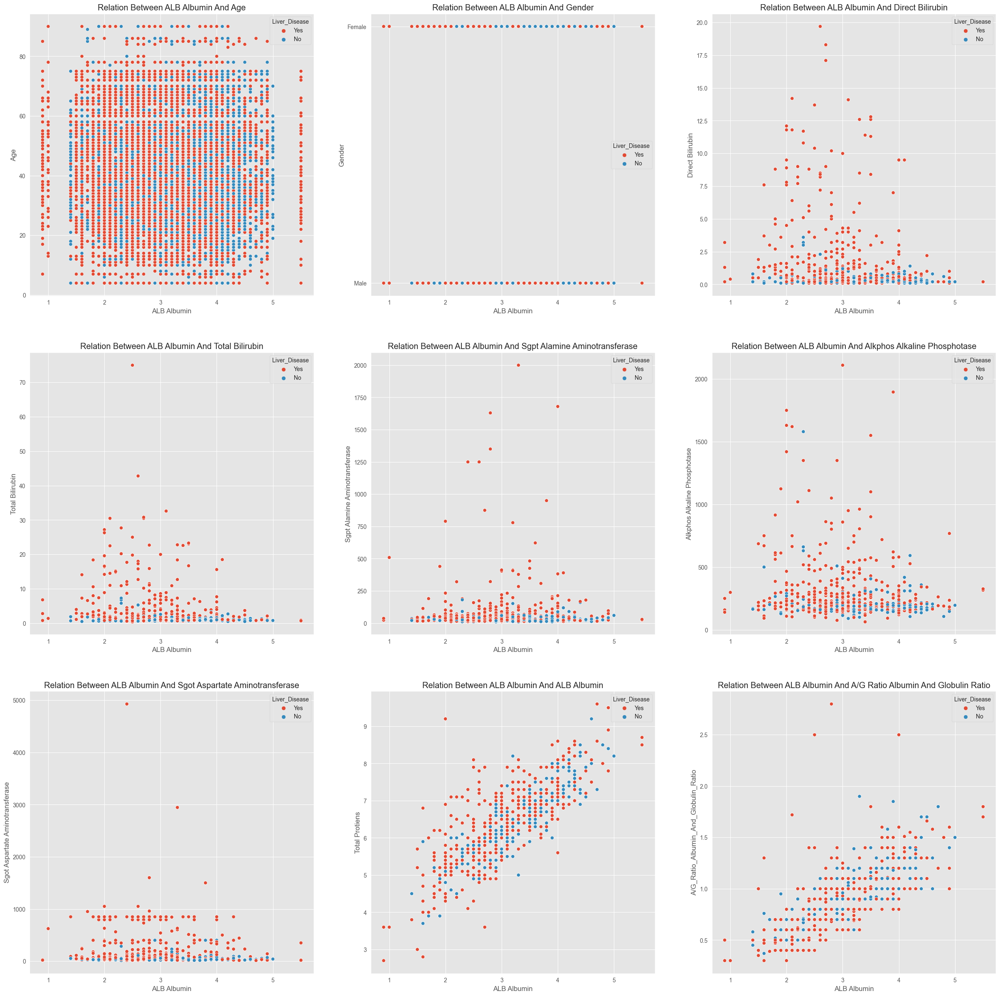

In [50]:
Fig, ((ax1, ax2, ax3),(ax4, ax5, ax6),(ax7, ax8, ax9)) = plt.subplots(nrows=3,
                                            ncols=3,
                                            figsize=(30 , 30))
sns.scatterplot(x =Liver['ALB_Albumin'], y=Liver['Age'], ax=ax1, hue=Liver['Liver_Disease']);
ax1.set(title = "Relation Between ALB Albumin And Age" ,xlabel='ALB Albumin', ylabel='Age');

sns.scatterplot(x =Liver['ALB_Albumin'], y=Liver['Gender'], ax=ax2, hue=Liver['Liver_Disease']);
ax2.set(title = "Relation Between ALB Albumin And Gender" ,xlabel='ALB Albumin', ylabel='Gender');

sns.scatterplot(x =Liver['ALB_Albumin'], y=Liver['Direct_Bilirubin'], ax=ax3, hue=Liver['Liver_Disease']);
ax3.set(title = "Relation Between ALB Albumin And Direct Bilirubin" ,xlabel='ALB Albumin', ylabel='Direct Bilirubin');

sns.scatterplot(x= Liver['ALB_Albumin'], y=Liver['Total_Bilirubin'], ax=ax4, hue=Liver['Liver_Disease']);
ax4.set(title='Relation Between ALB Albumin And Total Bilirubin', xlabel='ALB Albumin', ylabel='Total Bilirubin');

sns.scatterplot(x= Liver['ALB_Albumin'], y=Liver['Sgpt_Alamine_Aminotransferase'], ax=ax5, hue=Liver['Liver_Disease']);
ax5.set(title='Relation Between ALB Albumin And Sgpt Alamine Aminotransferase', xlabel='ALB Albumin', ylabel='Sgpt Alamine Aminotransferase');

sns.scatterplot(x= Liver['ALB_Albumin'], y=Liver['Alkphos_Alkaline_Phosphotase'], ax=ax6, hue=Liver['Liver_Disease']);
ax6.set(title='Relation Between ALB Albumin And Alkphos Alkaline Phosphotase', xlabel='ALB Albumin', ylabel='Alkphos Alkaline Phosphotase');

sns.scatterplot(x= Liver['ALB_Albumin'], y=Liver['Sgot_Aspartate_Aminotransferase'], ax=ax7, hue=Liver['Liver_Disease']);
ax7.set(title='Relation Between ALB Albumin And Sgot Aspartate Aminotransferase', xlabel='ALB Albumin', ylabel='Sgot Aspartate Aminotransferase');

sns.scatterplot(x= Liver['ALB_Albumin'], y=Liver['Total_Protiens'], ax=ax8, hue=Liver['Liver_Disease']);
ax8.set(title='Relation Between ALB Albumin And ALB Albumin', xlabel='ALB Albumin', ylabel='Total Protiens');

sns.scatterplot(x= Liver['ALB_Albumin'], y=Liver['A/G_Ratio_Albumin_And_Globulin_Ratio'], ax=ax9, hue=Liver['Liver_Disease']);
ax9.set(title='Relation Between ALB Albumin And A/G Ratio Albumin And Globulin Ratio', xlabel='ALB Albumin', ylabel='A/G_Ratio_Albumin_And_Globulin_Ratio');

*1.10 A/G Ratio Albumin And Globulin Ratio*

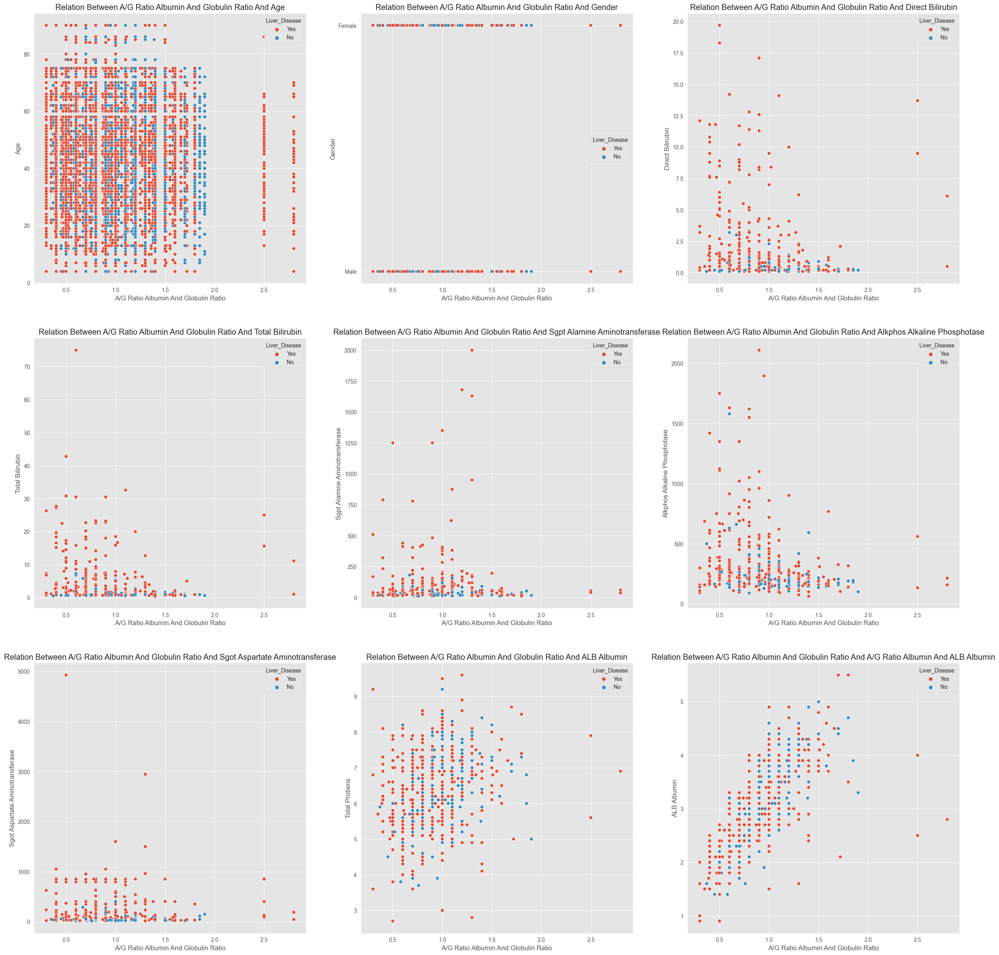

In [51]:
Fig, ((ax1, ax2, ax3),(ax4, ax5, ax6),(ax7, ax8, ax9)) = plt.subplots(nrows=3,
                                            ncols=3,
                                            figsize=(30 , 30))
sns.scatterplot(x =Liver['A/G_Ratio_Albumin_And_Globulin_Ratio'], y=Liver['Age'], ax=ax1, hue=Liver['Liver_Disease']);
ax1.set(title = "Relation Between A/G Ratio Albumin And Globulin Ratio And Age" ,xlabel='A/G Ratio Albumin And Globulin Ratio', ylabel='Age');

sns.scatterplot(x =Liver['A/G_Ratio_Albumin_And_Globulin_Ratio'], y=Liver['Gender'], ax=ax2, hue=Liver['Liver_Disease']);
ax2.set(title = "Relation Between A/G Ratio Albumin And Globulin Ratio And Gender" ,xlabel='A/G Ratio Albumin And Globulin Ratio', ylabel='Gender');

sns.scatterplot(x =Liver['A/G_Ratio_Albumin_And_Globulin_Ratio'], y=Liver['Direct_Bilirubin'], ax=ax3, hue=Liver['Liver_Disease']);
ax3.set(title = "Relation Between A/G Ratio Albumin And Globulin Ratio And Direct Bilirubin" ,xlabel='A/G Ratio Albumin And Globulin Ratio', ylabel='Direct Bilirubin');

sns.scatterplot(x= Liver['A/G_Ratio_Albumin_And_Globulin_Ratio'], y=Liver['Total_Bilirubin'], ax=ax4, hue=Liver['Liver_Disease']);
ax4.set(title='Relation Between A/G Ratio Albumin And Globulin Ratio And Total Bilirubin', xlabel='A/G Ratio Albumin And Globulin Ratio', ylabel='Total Bilirubin');

sns.scatterplot(x= Liver['A/G_Ratio_Albumin_And_Globulin_Ratio'], y=Liver['Sgpt_Alamine_Aminotransferase'], ax=ax5, hue=Liver['Liver_Disease']);
ax5.set(title='Relation Between A/G Ratio Albumin And Globulin Ratio And Sgpt Alamine Aminotransferase', xlabel='A/G Ratio Albumin And Globulin Ratio', ylabel='Sgpt Alamine Aminotransferase');

sns.scatterplot(x= Liver['A/G_Ratio_Albumin_And_Globulin_Ratio'], y=Liver['Alkphos_Alkaline_Phosphotase'], ax=ax6, hue=Liver['Liver_Disease']);
ax6.set(title='Relation Between A/G Ratio Albumin And Globulin Ratio And Alkphos Alkaline Phosphotase', xlabel='A/G Ratio Albumin And Globulin Ratio', ylabel='Alkphos Alkaline Phosphotase');

sns.scatterplot(x= Liver['A/G_Ratio_Albumin_And_Globulin_Ratio'], y=Liver['Sgot_Aspartate_Aminotransferase'], ax=ax7, hue=Liver['Liver_Disease']);
ax7.set(title='Relation Between A/G Ratio Albumin And Globulin Ratio And Sgot Aspartate Aminotransferase', xlabel='A/G Ratio Albumin And Globulin Ratio', ylabel='Sgot Aspartate Aminotransferase');

sns.scatterplot(x= Liver['A/G_Ratio_Albumin_And_Globulin_Ratio'], y=Liver['Total_Protiens'], ax=ax8, hue=Liver['Liver_Disease']);
ax8.set(title='Relation Between A/G Ratio Albumin And Globulin Ratio And ALB Albumin', xlabel='A/G Ratio Albumin And Globulin Ratio', ylabel='Total Protiens');

sns.scatterplot(x= Liver['A/G_Ratio_Albumin_And_Globulin_Ratio'], y=Liver['ALB_Albumin'], ax=ax9, hue=Liver['Liver_Disease']);
ax9.set(title='Relation Between A/G Ratio Albumin And Globulin Ratio And A/G Ratio Albumin And ALB Albumin', xlabel='A/G Ratio Albumin And Globulin Ratio', ylabel='ALB Albumin');

**2.LinePlot**

*2.1 Age*

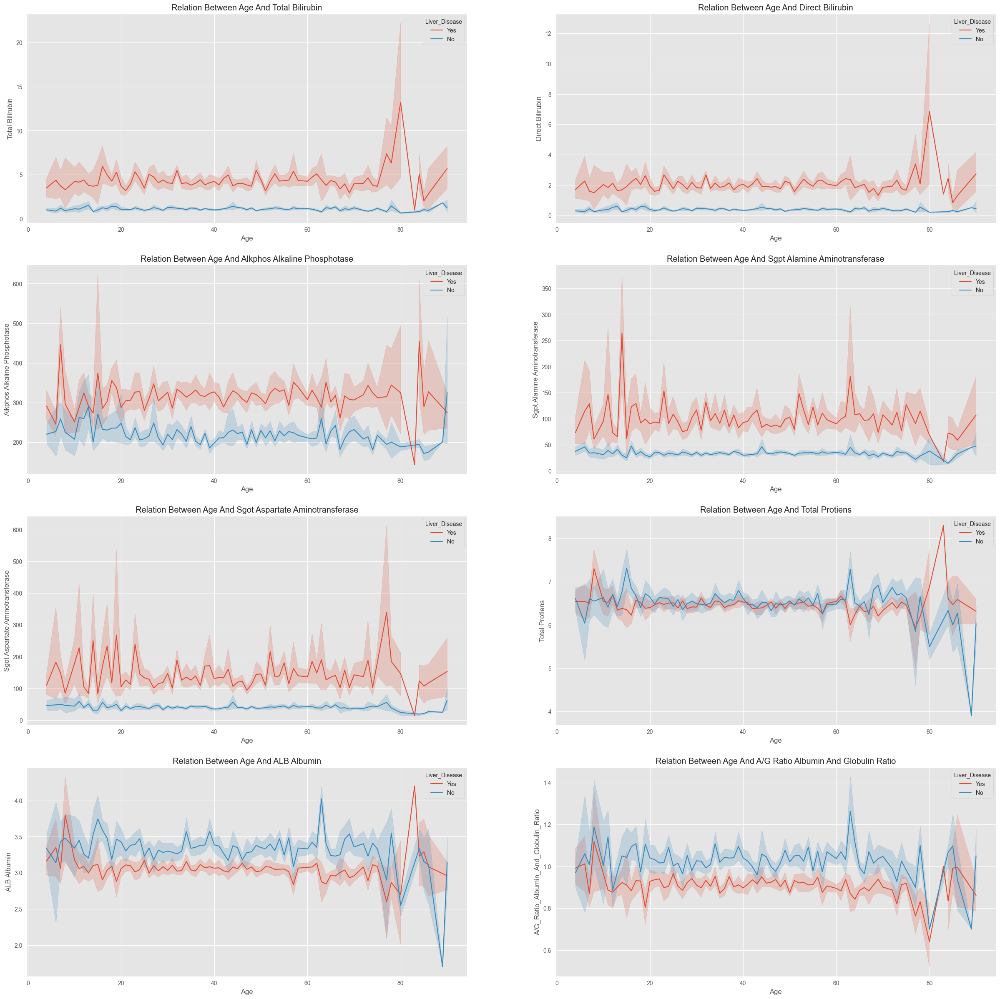

In [52]:
Fig, ((ax1, ax2), (ax3, ax4), (ax5, ax6), (ax7,ax8)) = plt.subplots(nrows=4,
                                            ncols=2,
                                            figsize=(30 , 30))

sns.lineplot(x =Liver['Age'], y=Liver['Total_Bilirubin'], ax=ax1, hue=Liver['Liver_Disease']);
ax1.set(title = "Relation Between Age And Total Bilirubin" ,xlabel='Age', ylabel='Total Bilirubin');

sns.lineplot(x =Liver['Age'], y=Liver['Direct_Bilirubin'], ax=ax2, hue=Liver['Liver_Disease']);
ax2.set(title = "Relation Between Age And Direct Bilirubin" ,xlabel='Age', ylabel='Direct Bilirubin');

sns.lineplot(x= Liver['Age'], y=Liver['Alkphos_Alkaline_Phosphotase'], ax=ax3, hue=Liver['Liver_Disease']);
ax3.set(title='Relation Between Age And Alkphos Alkaline Phosphotase', xlabel='Age', ylabel='Alkphos Alkaline Phosphotase');

sns.lineplot(x= Liver['Age'], y=Liver['Sgpt_Alamine_Aminotransferase'], ax=ax4, hue=Liver['Liver_Disease']);
ax4.set(title='Relation Between Age And Sgpt Alamine Aminotransferase', xlabel='Age', ylabel='Sgpt Alamine Aminotransferase');

sns.lineplot(x= Liver['Age'], y=Liver['Sgot_Aspartate_Aminotransferase'], ax=ax5, hue=Liver['Liver_Disease']);
ax5.set(title='Relation Between Age And Sgot Aspartate Aminotransferase', xlabel='Age', ylabel='Sgot Aspartate Aminotransferase');

sns.lineplot(x= Liver['Age'], y=Liver['Total_Protiens'], ax=ax6, hue=Liver['Liver_Disease']);
ax6.set(title='Relation Between Age And Total Protiens', xlabel='Age', ylabel='Total Protiens');

sns.lineplot(x= Liver['Age'], y=Liver['ALB_Albumin'], ax=ax7, hue=Liver['Liver_Disease']);
ax7.set(title='Relation Between Age And ALB Albumin', xlabel='Age', ylabel='ALB Albumin');

sns.lineplot(x= Liver['Age'], y=Liver['A/G_Ratio_Albumin_And_Globulin_Ratio'], ax=ax8, hue=Liver['Liver_Disease']);
ax8.set(title='Relation Between Age And A/G Ratio Albumin And Globulin Ratio', xlabel='Age', ylabel='A/G_Ratio_Albumin_And_Globulin_Ratio');

*2.2 Total Bilirubin*

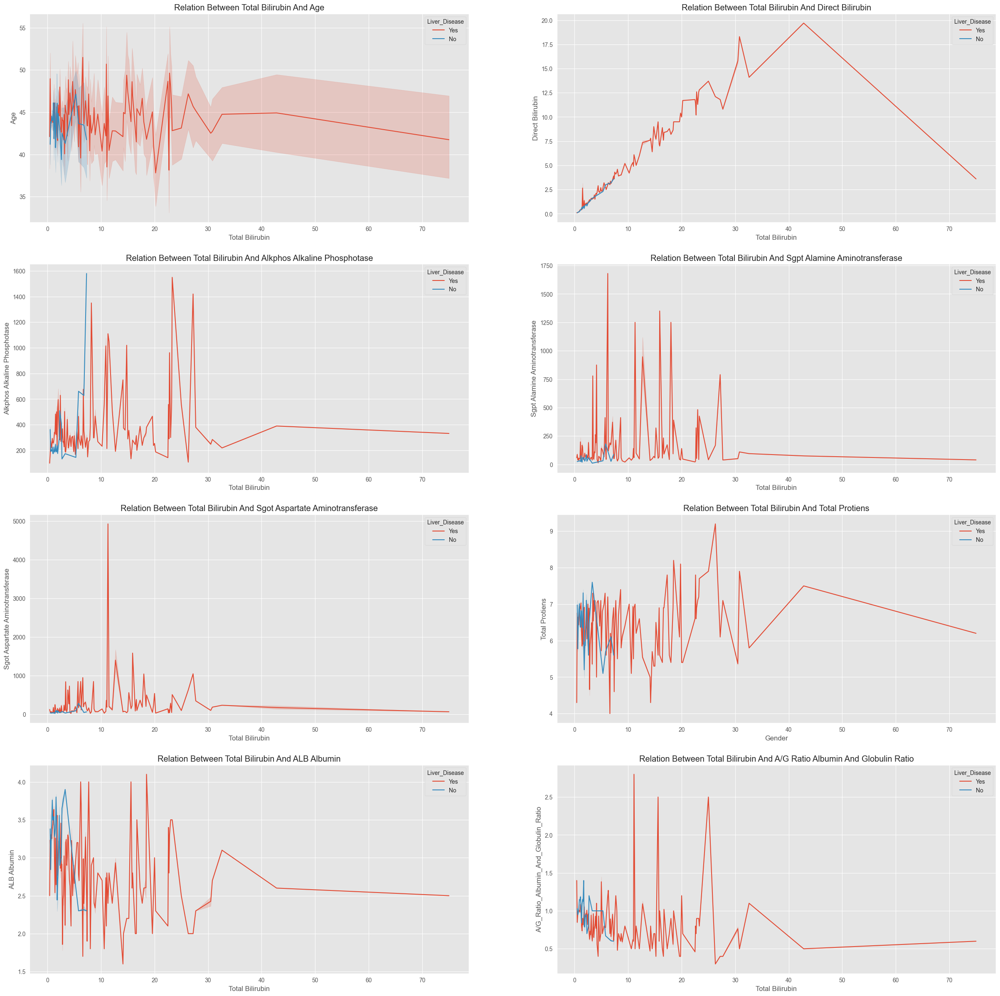

In [53]:
Fig, ((ax1, ax2), (ax3, ax4), (ax5, ax6), (ax7,ax8)) = plt.subplots(nrows=4,
                                            ncols=2,
                                            figsize=(30 , 30))
sns.lineplot(x =Liver['Total_Bilirubin'], y=Liver['Age'], ax=ax1, hue=Liver['Liver_Disease']);
ax1.set(title = "Relation Between Total Bilirubin And Age" ,xlabel='Total Bilirubin', ylabel='Age');

sns.lineplot(x =Liver['Total_Bilirubin'], y=Liver['Direct_Bilirubin'], ax=ax2, hue=Liver['Liver_Disease']);
ax2.set(title = "Relation Between Total Bilirubin And Direct Bilirubin" ,xlabel='Total Bilirubin', ylabel='Direct Bilirubin');

sns.lineplot(x= Liver['Total_Bilirubin'], y=Liver['Alkphos_Alkaline_Phosphotase'], ax=ax3, hue=Liver['Liver_Disease']);
ax3.set(title='Relation Between Total Bilirubin And Alkphos Alkaline Phosphotase', xlabel='Total Bilirubin', ylabel='Alkphos Alkaline Phosphotase');

sns.lineplot(x= Liver['Total_Bilirubin'], y=Liver['Sgpt_Alamine_Aminotransferase'], ax=ax4, hue=Liver['Liver_Disease']);
ax4.set(title='Relation Between Total Bilirubin And Sgpt Alamine Aminotransferase', xlabel='Total Bilirubin', ylabel='Sgpt Alamine Aminotransferase');

sns.lineplot(x= Liver['Total_Bilirubin'], y=Liver['Sgot_Aspartate_Aminotransferase'], ax=ax5, hue=Liver['Liver_Disease']);
ax5.set(title='Relation Between Total Bilirubin And Sgot Aspartate Aminotransferase', xlabel='Total Bilirubin', ylabel='Sgot Aspartate Aminotransferase');

sns.lineplot(x= Liver['Total_Bilirubin'], y=Liver['Total_Protiens'], ax=ax6, hue=Liver['Liver_Disease']);
ax6.set(title='Relation Between Total Bilirubin And Total Protiens', xlabel='Gender', ylabel='Total Protiens');

sns.lineplot(x= Liver['Total_Bilirubin'], y=Liver['ALB_Albumin'], ax=ax7, hue=Liver['Liver_Disease']);
ax7.set(title='Relation Between Total Bilirubin And ALB Albumin', xlabel='Total Bilirubin', ylabel='ALB Albumin');

sns.lineplot(x= Liver['Total_Bilirubin'], y=Liver['A/G_Ratio_Albumin_And_Globulin_Ratio'], ax=ax8, hue=Liver['Liver_Disease']);
ax8.set(title='Relation Between Total Bilirubin And A/G Ratio Albumin And Globulin Ratio', xlabel='Total Bilirubin', ylabel='A/G_Ratio_Albumin_And_Globulin_Ratio');

*2.3 Direct Bilirubin*

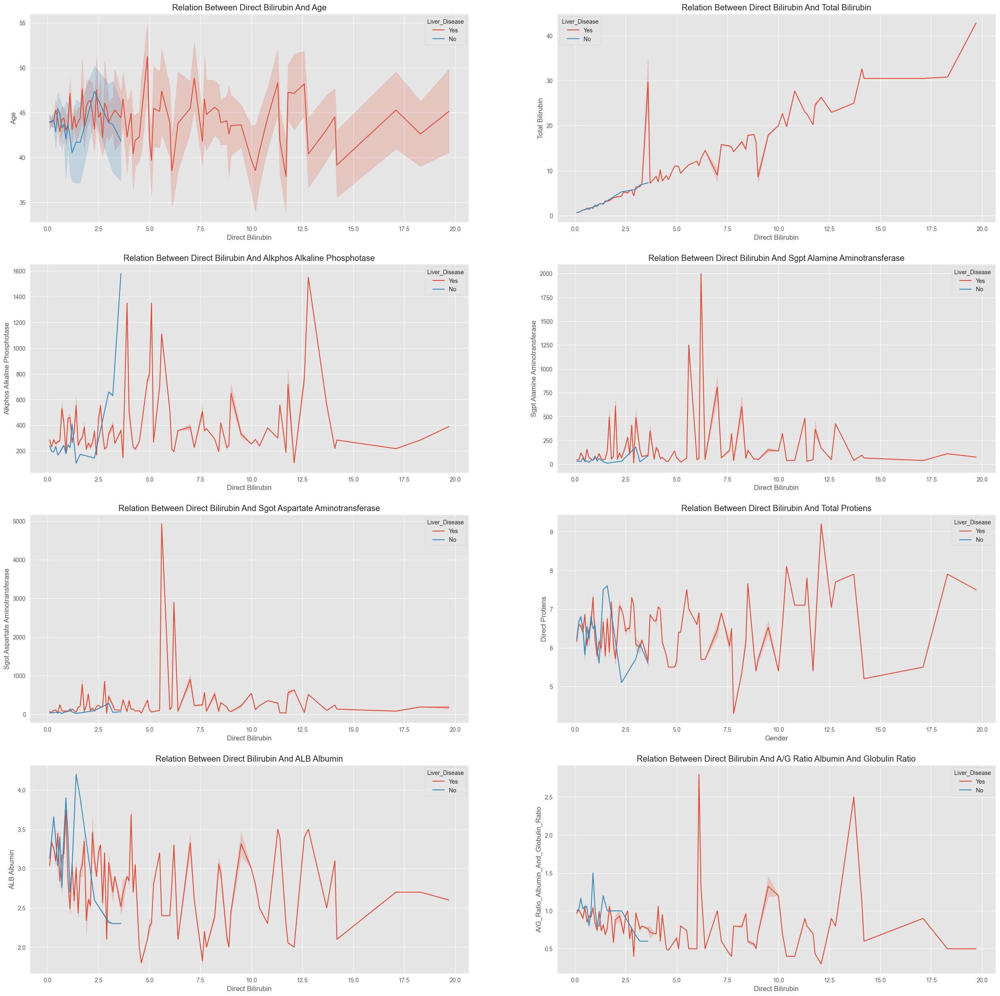

In [54]:
Fig, ((ax1, ax2), (ax3, ax4), (ax5, ax6), (ax7,ax8)) = plt.subplots(nrows=4,
                                            ncols=2,
                                            figsize=(30 , 30))
sns.lineplot(x =Liver['Direct_Bilirubin'], y=Liver['Age'], ax=ax1, hue=Liver['Liver_Disease']);
ax1.set(title = "Relation Between Direct Bilirubin And Age" ,xlabel='Direct Bilirubin', ylabel='Age');

sns.lineplot(x =Liver['Direct_Bilirubin'], y=Liver['Total_Bilirubin'], ax=ax2, hue=Liver['Liver_Disease']);
ax2.set(title = "Relation Between Direct Bilirubin And Total Bilirubin" ,xlabel='Direct Bilirubin', ylabel='Total Bilirubin');

sns.lineplot(x= Liver['Direct_Bilirubin'], y=Liver['Alkphos_Alkaline_Phosphotase'], ax=ax3, hue=Liver['Liver_Disease']);
ax3.set(title='Relation Between Direct Bilirubin And Alkphos Alkaline Phosphotase', xlabel='Direct Bilirubin', ylabel='Alkphos Alkaline Phosphotase');

sns.lineplot(x= Liver['Direct_Bilirubin'], y=Liver['Sgpt_Alamine_Aminotransferase'], ax=ax4, hue=Liver['Liver_Disease']);
ax4.set(title='Relation Between Direct Bilirubin And Sgpt Alamine Aminotransferase', xlabel='Direct Bilirubin', ylabel='Sgpt Alamine Aminotransferase');

sns.lineplot(x= Liver['Direct_Bilirubin'], y=Liver['Sgot_Aspartate_Aminotransferase'], ax=ax5, hue=Liver['Liver_Disease']);
ax5.set(title='Relation Between Direct Bilirubin And Sgot Aspartate Aminotransferase', xlabel='Direct Bilirubin', ylabel='Sgot Aspartate Aminotransferase');

sns.lineplot(x= Liver['Direct_Bilirubin'], y=Liver['Total_Protiens'], ax=ax6, hue=Liver['Liver_Disease']);
ax6.set(title='Relation Between Direct Bilirubin And Total Protiens', xlabel='Gender', ylabel='Direct Protiens');

sns.lineplot(x= Liver['Direct_Bilirubin'], y=Liver['ALB_Albumin'], ax=ax7, hue=Liver['Liver_Disease']);
ax7.set(title='Relation Between Direct Bilirubin And ALB Albumin', xlabel='Direct Bilirubin', ylabel='ALB Albumin');

sns.lineplot(x= Liver['Direct_Bilirubin'], y=Liver['A/G_Ratio_Albumin_And_Globulin_Ratio'], ax=ax8, hue=Liver['Liver_Disease']);
ax8.set(title='Relation Between Direct Bilirubin And A/G Ratio Albumin And Globulin Ratio', xlabel='Direct Bilirubin', ylabel='A/G_Ratio_Albumin_And_Globulin_Ratio');

*2.4 Alkphos Alkaline Phosphotase*

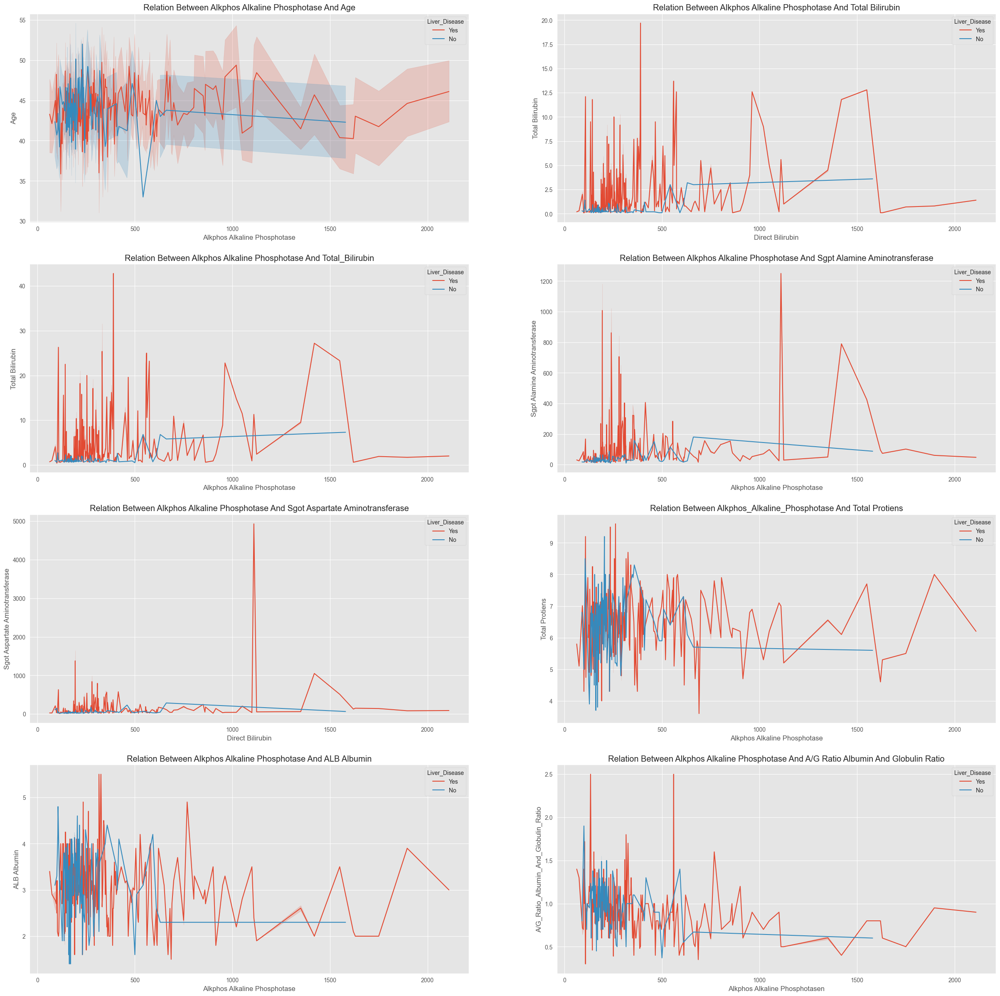

In [55]:
Fig, ((ax1, ax2), (ax3, ax4), (ax5, ax6), (ax7,ax8)) = plt.subplots(nrows=4,
                                            ncols=2,
                                            figsize=(30 , 30))
sns.lineplot(x =Liver['Alkphos_Alkaline_Phosphotase'], y=Liver['Age'], ax=ax1, hue=Liver['Liver_Disease']);
ax1.set(title = "Relation Between Alkphos Alkaline Phosphotase And Age" ,xlabel='Alkphos Alkaline Phosphotase', ylabel='Age');

sns.lineplot(x =Liver['Alkphos_Alkaline_Phosphotase'], y=Liver['Direct_Bilirubin'], ax=ax2, hue=Liver['Liver_Disease']);
ax2.set(title = "Relation Between Alkphos Alkaline Phosphotase And Total Bilirubin" ,xlabel='Direct Bilirubin', ylabel='Total Bilirubin');

sns.lineplot(x= Liver['Alkphos_Alkaline_Phosphotase'], y=Liver['Total_Bilirubin'], ax=ax3, hue=Liver['Liver_Disease']);
ax3.set(title='Relation Between Alkphos Alkaline Phosphotase And Total_Bilirubin', xlabel='Alkphos Alkaline Phosphotase', ylabel='Total Bilirubin');

sns.lineplot(x= Liver['Alkphos_Alkaline_Phosphotase'], y=Liver['Sgpt_Alamine_Aminotransferase'], ax=ax4, hue=Liver['Liver_Disease']);
ax4.set(title='Relation Between Alkphos Alkaline Phosphotase And Sgpt Alamine Aminotransferase', xlabel='Alkphos Alkaline Phosphotase', ylabel='Sgpt Alamine Aminotransferase');

sns.lineplot(x= Liver['Alkphos_Alkaline_Phosphotase'], y=Liver['Sgot_Aspartate_Aminotransferase'], ax=ax5, hue=Liver['Liver_Disease']);
ax5.set(title='Relation Between Alkphos Alkaline Phosphotase And Sgot Aspartate Aminotransferase', xlabel='Direct Bilirubin', ylabel='Sgot Aspartate Aminotransferase');

sns.lineplot(x= Liver['Alkphos_Alkaline_Phosphotase'], y=Liver['Total_Protiens'], ax=ax6, hue=Liver['Liver_Disease']);
ax6.set(title='Relation Between Alkphos_Alkaline_Phosphotase And Total Protiens', xlabel='Alkphos Alkaline Phosphotase', ylabel='Total Protiens');

sns.lineplot(x= Liver['Alkphos_Alkaline_Phosphotase'], y=Liver['ALB_Albumin'], ax=ax7, hue=Liver['Liver_Disease']);
ax7.set(title='Relation Between Alkphos Alkaline Phosphotase And ALB Albumin', xlabel='Alkphos Alkaline Phosphotase', ylabel='ALB Albumin');

sns.lineplot(x= Liver['Alkphos_Alkaline_Phosphotase'], y=Liver['A/G_Ratio_Albumin_And_Globulin_Ratio'], ax=ax8, hue=Liver['Liver_Disease']);
ax8.set(title='Relation Between Alkphos Alkaline Phosphotase And A/G Ratio Albumin And Globulin Ratio', xlabel='Alkphos Alkaline Phosphotasen', ylabel='A/G_Ratio_Albumin_And_Globulin_Ratio');

*2.5 Sgpt Alamine Aminotransferase*

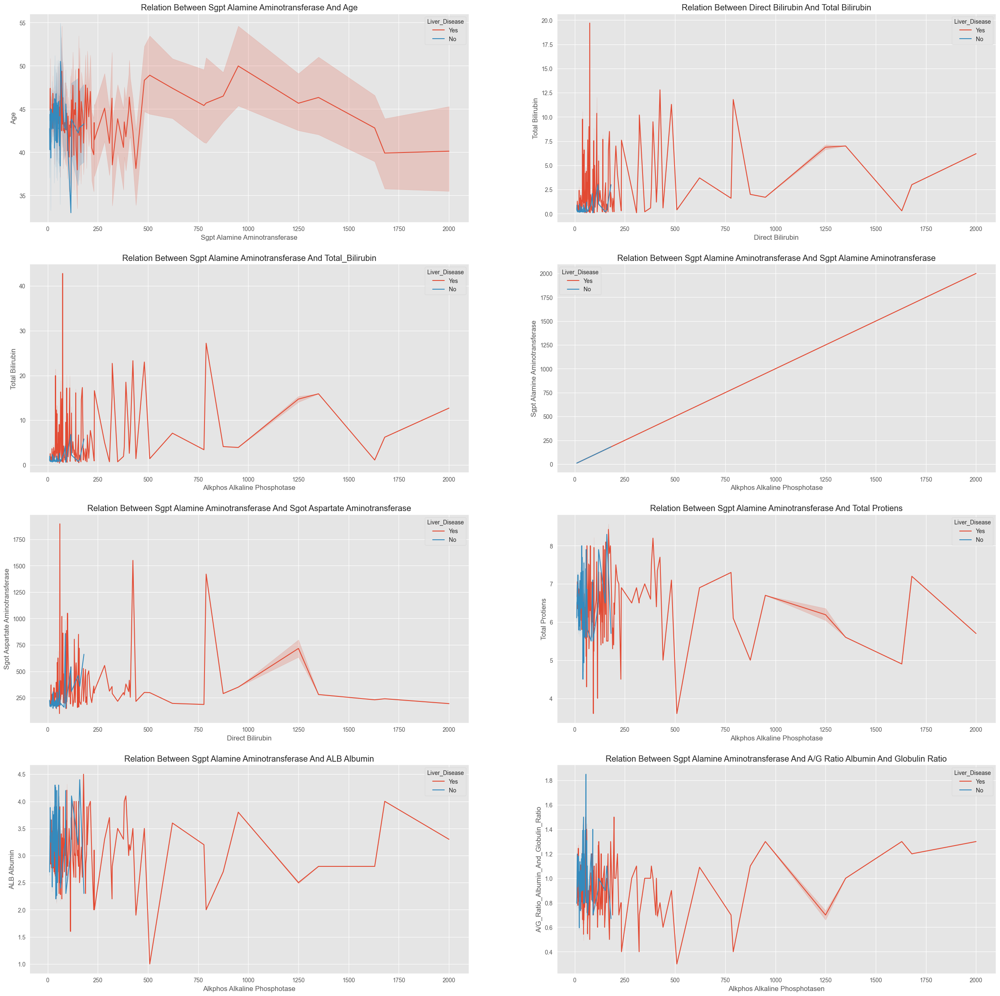

In [56]:
Fig, ((ax1, ax2), (ax3, ax4), (ax5, ax6), (ax7,ax8)) = plt.subplots(nrows=4,
                                            ncols=2,
                                            figsize=(30 , 30))
sns.lineplot(x =Liver['Sgpt_Alamine_Aminotransferase'], y=Liver['Age'], ax=ax1, hue=Liver['Liver_Disease']);
ax1.set(title = "Relation Between Sgpt Alamine Aminotransferase And Age" ,xlabel='Sgpt Alamine Aminotransferase', ylabel='Age');

sns.lineplot(x =Liver['Sgpt_Alamine_Aminotransferase'], y=Liver['Direct_Bilirubin'], ax=ax2, hue=Liver['Liver_Disease']);
ax2.set(title = "Relation Between Direct Bilirubin And Total Bilirubin" ,xlabel='Direct Bilirubin', ylabel='Total Bilirubin');

sns.lineplot(x= Liver['Sgpt_Alamine_Aminotransferase'], y=Liver['Total_Bilirubin'], ax=ax3, hue=Liver['Liver_Disease']);
ax3.set(title='Relation Between Sgpt Alamine Aminotransferase And Total_Bilirubin', xlabel='Alkphos Alkaline Phosphotase', ylabel='Total Bilirubin');

sns.lineplot(x= Liver['Sgpt_Alamine_Aminotransferase'], y=Liver['Sgpt_Alamine_Aminotransferase'], ax=ax4, hue=Liver['Liver_Disease']);
ax4.set(title='Relation Between Sgpt Alamine Aminotransferase And Sgpt Alamine Aminotransferase', xlabel='Alkphos Alkaline Phosphotase', ylabel='Sgpt Alamine Aminotransferase');

sns.lineplot(x= Liver['Sgpt_Alamine_Aminotransferase'], y=Liver['Alkphos_Alkaline_Phosphotase'], ax=ax5, hue=Liver['Liver_Disease']);
ax5.set(title='Relation Between Sgpt Alamine Aminotransferase And Sgot Aspartate Aminotransferase', xlabel='Direct Bilirubin', ylabel='Sgot Aspartate Aminotransferase');

sns.lineplot(x= Liver['Sgpt_Alamine_Aminotransferase'], y=Liver['Total_Protiens'], ax=ax6, hue=Liver['Liver_Disease']);
ax6.set(title='Relation Between Sgpt Alamine Aminotransferase And Total Protiens', xlabel='Alkphos Alkaline Phosphotase', ylabel='Total Protiens');

sns.lineplot(x= Liver['Sgpt_Alamine_Aminotransferase'], y=Liver['ALB_Albumin'], ax=ax7, hue=Liver['Liver_Disease']);
ax7.set(title='Relation Between Sgpt Alamine Aminotransferase And ALB Albumin', xlabel='Alkphos Alkaline Phosphotase', ylabel='ALB Albumin');

sns.lineplot(x= Liver['Sgpt_Alamine_Aminotransferase'], y=Liver['A/G_Ratio_Albumin_And_Globulin_Ratio'], ax=ax8, hue=Liver['Liver_Disease']);
ax8.set(title='Relation Between Sgpt Alamine Aminotransferase And A/G Ratio Albumin And Globulin Ratio', xlabel='Alkphos Alkaline Phosphotasen', ylabel='A/G_Ratio_Albumin_And_Globulin_Ratio');

*2.6 Sgot Aspartate Aminotransferase*

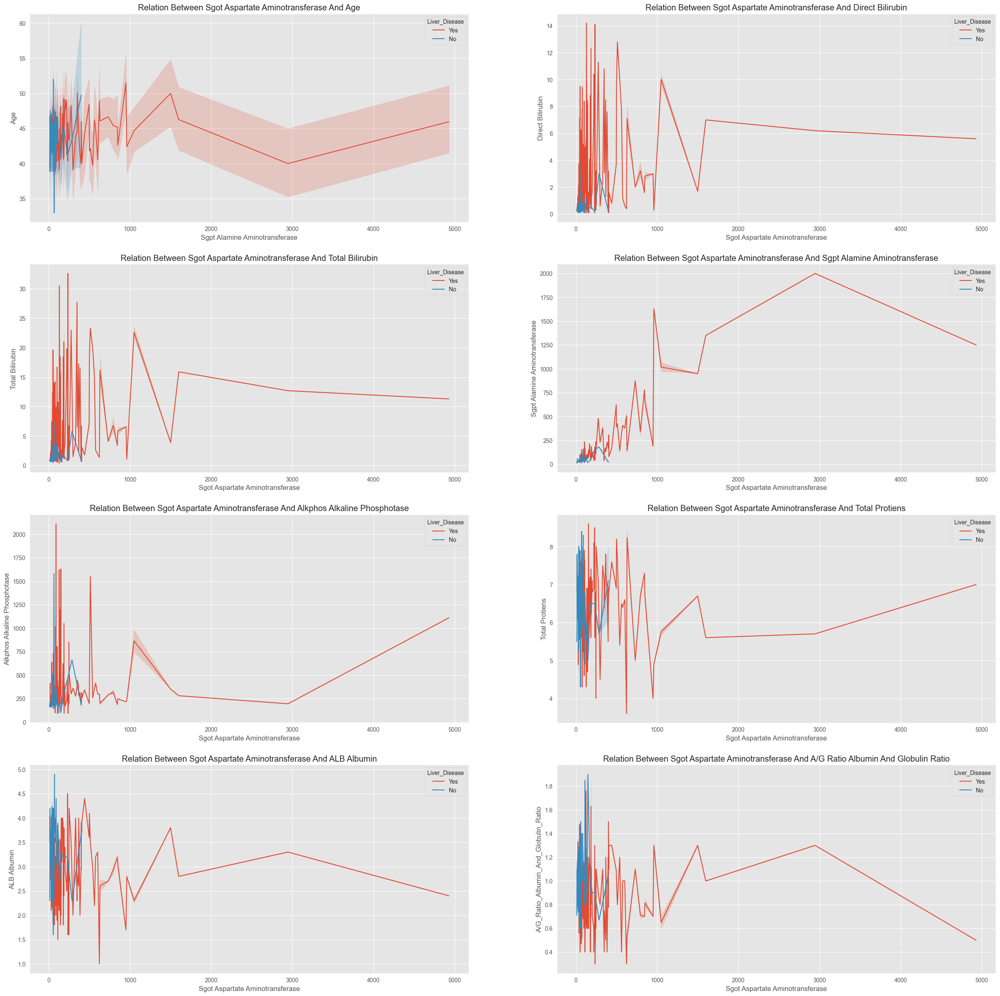

In [57]:
Fig, ((ax1, ax2), (ax3, ax4), (ax5, ax6), (ax7,ax8)) = plt.subplots(nrows=4,
                                            ncols=2,
                                            figsize=(30 , 30))
sns.lineplot(x =Liver['Sgot_Aspartate_Aminotransferase'], y=Liver['Age'], ax=ax1, hue=Liver['Liver_Disease']);
ax1.set(title = "Relation Between Sgot Aspartate Aminotransferase And Age" ,xlabel='Sgpt Alamine Aminotransferase', ylabel='Age');

sns.lineplot(x =Liver['Sgot_Aspartate_Aminotransferase'], y=Liver['Direct_Bilirubin'], ax=ax2, hue=Liver['Liver_Disease']);
ax2.set(title = "Relation Between Sgot Aspartate Aminotransferase And Direct Bilirubin" ,xlabel='Sgot Aspartate Aminotransferase', ylabel='Direct Bilirubin');

sns.lineplot(x= Liver['Sgot_Aspartate_Aminotransferase'], y=Liver['Total_Bilirubin'], ax=ax3, hue=Liver['Liver_Disease']);
ax3.set(title='Relation Between Sgot Aspartate Aminotransferase And Total Bilirubin', xlabel='Sgot Aspartate Aminotransferase', ylabel='Total Bilirubin');

sns.lineplot(x= Liver['Sgot_Aspartate_Aminotransferase'], y=Liver['Sgpt_Alamine_Aminotransferase'], ax=ax4, hue=Liver['Liver_Disease']);
ax4.set(title='Relation Between Sgot Aspartate Aminotransferase And Sgpt Alamine Aminotransferase', xlabel='Sgot Aspartate Aminotransferase', ylabel='Sgpt Alamine Aminotransferase');

sns.lineplot(x= Liver['Sgot_Aspartate_Aminotransferase'], y=Liver['Alkphos_Alkaline_Phosphotase'], ax=ax5, hue=Liver['Liver_Disease']);
ax5.set(title='Relation Between Sgot Aspartate Aminotransferase And Alkphos Alkaline Phosphotase', xlabel='Sgot Aspartate Aminotransferase', ylabel='Alkphos Alkaline Phosphotase');

sns.lineplot(x= Liver['Sgot_Aspartate_Aminotransferase'], y=Liver['Total_Protiens'], ax=ax6, hue=Liver['Liver_Disease']);
ax6.set(title='Relation Between Sgot Aspartate Aminotransferase And Total Protiens', xlabel='Sgot Aspartate Aminotransferase', ylabel='Total Protiens');

sns.lineplot(x= Liver['Sgot_Aspartate_Aminotransferase'], y=Liver['ALB_Albumin'], ax=ax7, hue=Liver['Liver_Disease']);
ax7.set(title='Relation Between Sgot Aspartate Aminotransferase And ALB Albumin', xlabel='Sgot Aspartate Aminotransferase', ylabel='ALB Albumin');

sns.lineplot(x= Liver['Sgot_Aspartate_Aminotransferase'], y=Liver['A/G_Ratio_Albumin_And_Globulin_Ratio'], ax=ax8, hue=Liver['Liver_Disease']);
ax8.set(title='Relation Between Sgot Aspartate Aminotransferase And A/G Ratio Albumin And Globulin Ratio', xlabel='Sgot Aspartate Aminotransferase', ylabel='A/G_Ratio_Albumin_And_Globulin_Ratio');

*2.7 Total Protiens*

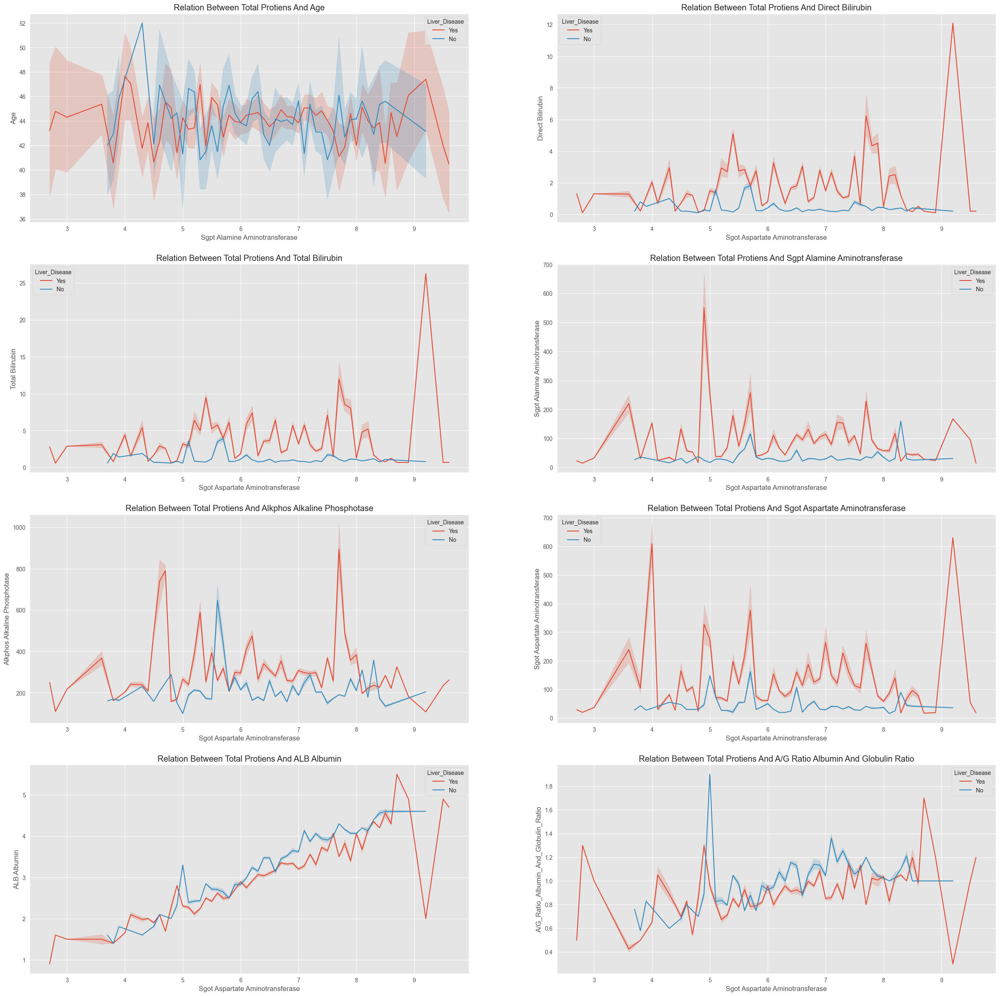

In [58]:
Fig, ((ax1, ax2), (ax3, ax4), (ax5, ax6), (ax7,ax8)) = plt.subplots(nrows=4,
                                            ncols=2,
                                            figsize=(30 , 30))
sns.lineplot(x =Liver['Total_Protiens'], y=Liver['Age'], ax=ax1, hue=Liver['Liver_Disease']);
ax1.set(title = "Relation Between Total Protiens And Age" ,xlabel='Sgpt Alamine Aminotransferase', ylabel='Age');

sns.lineplot(x =Liver['Total_Protiens'], y=Liver['Direct_Bilirubin'], ax=ax2, hue=Liver['Liver_Disease']);
ax2.set(title = "Relation Between Total Protiens And Direct Bilirubin" ,xlabel='Sgot Aspartate Aminotransferase', ylabel='Direct Bilirubin');

sns.lineplot(x= Liver['Total_Protiens'], y=Liver['Total_Bilirubin'], ax=ax3, hue=Liver['Liver_Disease']);
ax3.set(title='Relation Between Total Protiens And Total Bilirubin', xlabel='Sgot Aspartate Aminotransferase', ylabel='Total Bilirubin');

sns.lineplot(x= Liver['Total_Protiens'], y=Liver['Sgpt_Alamine_Aminotransferase'], ax=ax4, hue=Liver['Liver_Disease']);
ax4.set(title='Relation Between Total Protiens And Sgpt Alamine Aminotransferase', xlabel='Sgot Aspartate Aminotransferase', ylabel='Sgpt Alamine Aminotransferase');

sns.lineplot(x= Liver['Total_Protiens'], y=Liver['Alkphos_Alkaline_Phosphotase'], ax=ax5, hue=Liver['Liver_Disease']);
ax5.set(title='Relation Between Total Protiens And Alkphos Alkaline Phosphotase', xlabel='Sgot Aspartate Aminotransferase', ylabel='Alkphos Alkaline Phosphotase');

sns.lineplot(x= Liver['Total_Protiens'], y=Liver['Sgot_Aspartate_Aminotransferase'], ax=ax6, hue=Liver['Liver_Disease']);
ax6.set(title='Relation Between Total Protiens And Sgot Aspartate Aminotransferase', xlabel='Sgot Aspartate Aminotransferase', ylabel='Sgot Aspartate Aminotransferase');

sns.lineplot(x= Liver['Total_Protiens'], y=Liver['ALB_Albumin'], ax=ax7, hue=Liver['Liver_Disease']);
ax7.set(title='Relation Between Total Protiens And ALB Albumin', xlabel='Sgot Aspartate Aminotransferase', ylabel='ALB Albumin');

sns.lineplot(x= Liver['Total_Protiens'], y=Liver['A/G_Ratio_Albumin_And_Globulin_Ratio'], ax=ax8, hue=Liver['Liver_Disease']);
ax8.set(title='Relation Between Total Protiens And A/G Ratio Albumin And Globulin Ratio', xlabel='Sgot Aspartate Aminotransferase', ylabel='A/G_Ratio_Albumin_And_Globulin_Ratio');

*2.8 ALB Albumin*

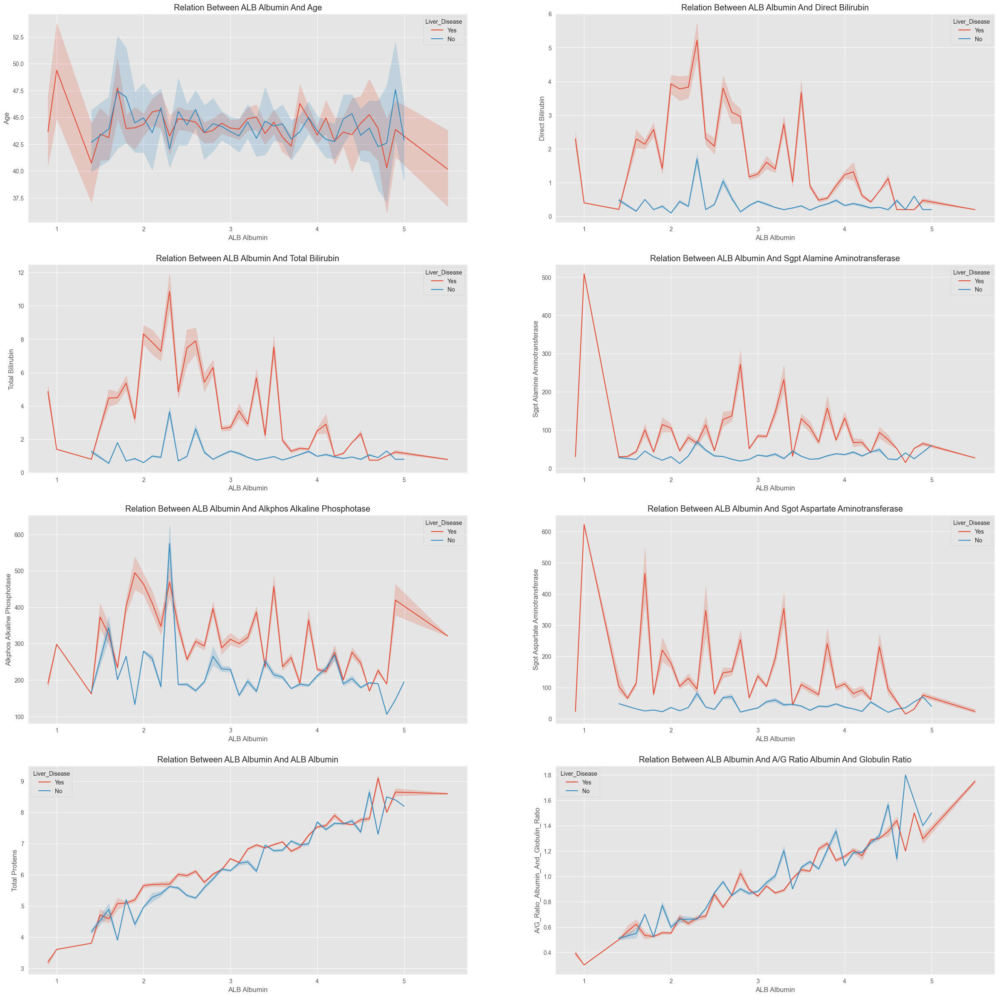

In [59]:
Fig, ((ax1, ax2), (ax3, ax4), (ax5, ax6), (ax7,ax8)) = plt.subplots(nrows=4,
                                            ncols=2,
                                            figsize=(30 , 30))
sns.lineplot(x =Liver['ALB_Albumin'], y=Liver['Age'], ax=ax1, hue=Liver['Liver_Disease']);
ax1.set(title = "Relation Between ALB Albumin And Age" ,xlabel='ALB Albumin', ylabel='Age');

sns.lineplot(x =Liver['ALB_Albumin'], y=Liver['Direct_Bilirubin'], ax=ax2, hue=Liver['Liver_Disease']);
ax2.set(title = "Relation Between ALB Albumin And Direct Bilirubin" ,xlabel='ALB Albumin', ylabel='Direct Bilirubin');

sns.lineplot(x= Liver['ALB_Albumin'], y=Liver['Total_Bilirubin'], ax=ax3, hue=Liver['Liver_Disease']);
ax3.set(title='Relation Between ALB Albumin And Total Bilirubin', xlabel='ALB Albumin', ylabel='Total Bilirubin');

sns.lineplot(x= Liver['ALB_Albumin'], y=Liver['Sgpt_Alamine_Aminotransferase'], ax=ax4, hue=Liver['Liver_Disease']);
ax4.set(title='Relation Between ALB Albumin And Sgpt Alamine Aminotransferase', xlabel='ALB Albumin', ylabel='Sgpt Alamine Aminotransferase');

sns.lineplot(x= Liver['ALB_Albumin'], y=Liver['Alkphos_Alkaline_Phosphotase'], ax=ax5, hue=Liver['Liver_Disease']);
ax5.set(title='Relation Between ALB Albumin And Alkphos Alkaline Phosphotase', xlabel='ALB Albumin', ylabel='Alkphos Alkaline Phosphotase');

sns.lineplot(x= Liver['ALB_Albumin'], y=Liver['Sgot_Aspartate_Aminotransferase'], ax=ax6, hue=Liver['Liver_Disease']);
ax6.set(title='Relation Between ALB Albumin And Sgot Aspartate Aminotransferase', xlabel='ALB Albumin', ylabel='Sgot Aspartate Aminotransferase');

sns.lineplot(x= Liver['ALB_Albumin'], y=Liver['Total_Protiens'], ax=ax7, hue=Liver['Liver_Disease']);
ax7.set(title='Relation Between ALB Albumin And ALB Albumin', xlabel='ALB Albumin', ylabel='Total Protiens');

sns.lineplot(x= Liver['ALB_Albumin'], y=Liver['A/G_Ratio_Albumin_And_Globulin_Ratio'], ax=ax8, hue=Liver['Liver_Disease']);
ax8.set(title='Relation Between ALB Albumin And A/G Ratio Albumin And Globulin Ratio', xlabel='ALB Albumin', ylabel='A/G_Ratio_Albumin_And_Globulin_Ratio');

*2.9 A/G Ratio Albumin And Globulin Ratio*

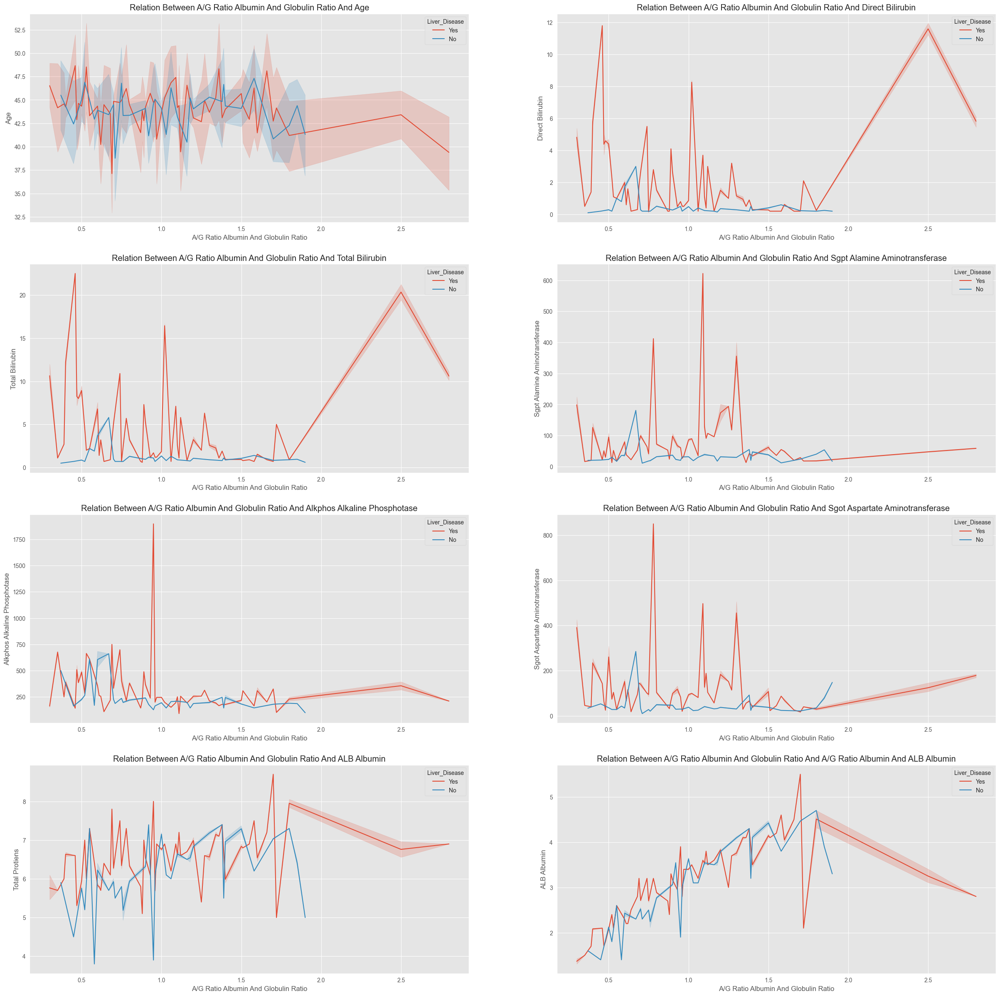

In [60]:
Fig, ((ax1, ax2), (ax3, ax4), (ax5, ax6), (ax7,ax8)) = plt.subplots(nrows=4,
                                            ncols=2,
                                            figsize=(30 , 30))
sns.lineplot(x =Liver['A/G_Ratio_Albumin_And_Globulin_Ratio'], y=Liver['Age'], ax=ax1, hue=Liver['Liver_Disease']);
ax1.set(title = "Relation Between A/G Ratio Albumin And Globulin Ratio And Age" ,xlabel='A/G Ratio Albumin And Globulin Ratio', ylabel='Age');

sns.lineplot(x =Liver['A/G_Ratio_Albumin_And_Globulin_Ratio'], y=Liver['Direct_Bilirubin'], ax=ax2, hue=Liver['Liver_Disease']);
ax2.set(title = "Relation Between A/G Ratio Albumin And Globulin Ratio And Direct Bilirubin" ,xlabel='A/G Ratio Albumin And Globulin Ratio', ylabel='Direct Bilirubin');

sns.lineplot(x= Liver['A/G_Ratio_Albumin_And_Globulin_Ratio'], y=Liver['Total_Bilirubin'], ax=ax3, hue=Liver['Liver_Disease']);
ax3.set(title='Relation Between A/G Ratio Albumin And Globulin Ratio And Total Bilirubin', xlabel='A/G Ratio Albumin And Globulin Ratio', ylabel='Total Bilirubin');

sns.lineplot(x= Liver['A/G_Ratio_Albumin_And_Globulin_Ratio'], y=Liver['Sgpt_Alamine_Aminotransferase'], ax=ax4, hue=Liver['Liver_Disease']);
ax4.set(title='Relation Between A/G Ratio Albumin And Globulin Ratio And Sgpt Alamine Aminotransferase', xlabel='A/G Ratio Albumin And Globulin Ratio', ylabel='Sgpt Alamine Aminotransferase');

sns.lineplot(x= Liver['A/G_Ratio_Albumin_And_Globulin_Ratio'], y=Liver['Alkphos_Alkaline_Phosphotase'], ax=ax5, hue=Liver['Liver_Disease']);
ax5.set(title='Relation Between A/G Ratio Albumin And Globulin Ratio And Alkphos Alkaline Phosphotase', xlabel='A/G Ratio Albumin And Globulin Ratio', ylabel='Alkphos Alkaline Phosphotase');

sns.lineplot(x= Liver['A/G_Ratio_Albumin_And_Globulin_Ratio'], y=Liver['Sgot_Aspartate_Aminotransferase'], ax=ax6, hue=Liver['Liver_Disease']);
ax6.set(title='Relation Between A/G Ratio Albumin And Globulin Ratio And Sgot Aspartate Aminotransferase', xlabel='A/G Ratio Albumin And Globulin Ratio', ylabel='Sgot Aspartate Aminotransferase');

sns.lineplot(x= Liver['A/G_Ratio_Albumin_And_Globulin_Ratio'], y=Liver['Total_Protiens'], ax=ax7, hue=Liver['Liver_Disease']);
ax7.set(title='Relation Between A/G Ratio Albumin And Globulin Ratio And ALB Albumin', xlabel='A/G Ratio Albumin And Globulin Ratio', ylabel='Total Protiens');

sns.lineplot(x= Liver['A/G_Ratio_Albumin_And_Globulin_Ratio'], y=Liver['ALB_Albumin'], ax=ax8, hue=Liver['Liver_Disease']);
ax8.set(title='Relation Between A/G Ratio Albumin And Globulin Ratio And A/G Ratio Albumin And ALB Albumin', xlabel='A/G Ratio Albumin And Globulin Ratio', ylabel='ALB Albumin');

**3.BoxPlot**

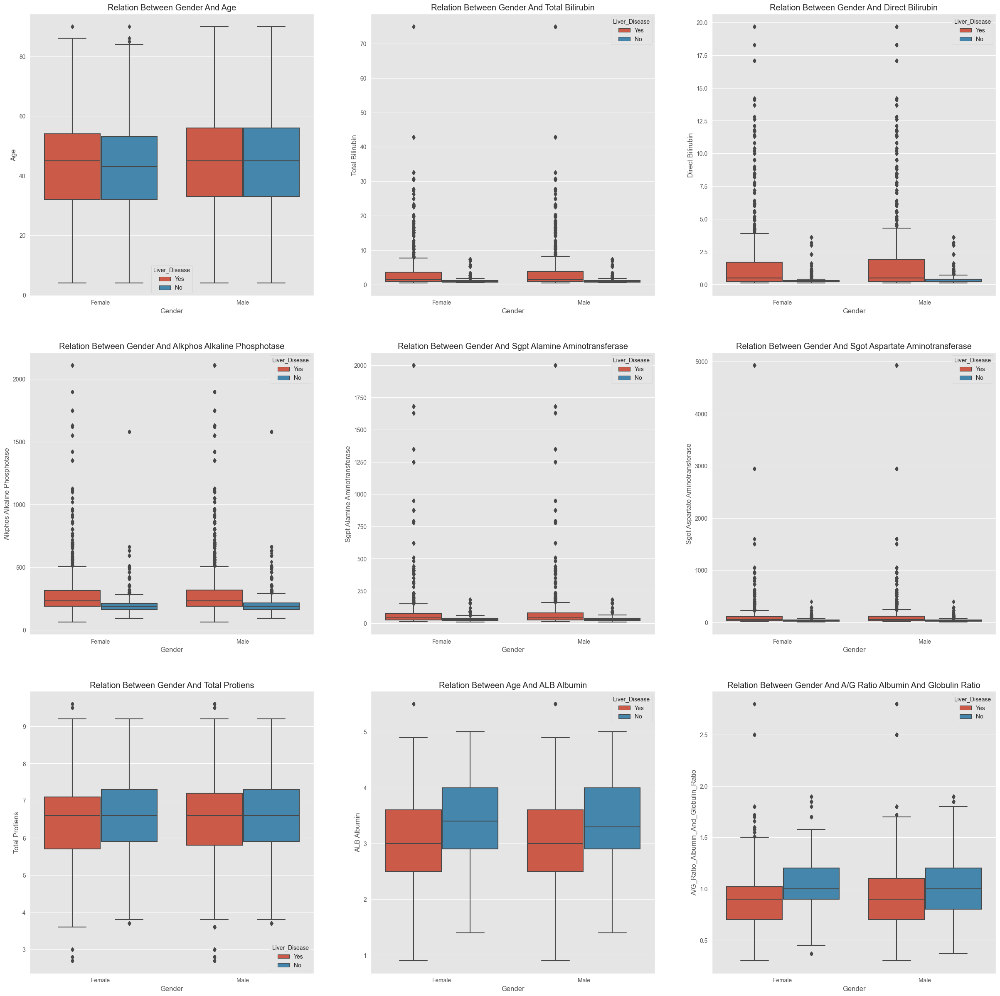

In [61]:
Fig, ((ax1, ax2, ax3),(ax4, ax5, ax6),(ax7, ax8, ax9)) = plt.subplots(nrows=3,
                                            ncols=3,
                                            figsize=(30 , 30))
sns.boxplot(x =Liver['Gender'], y=Liver['Age'], ax=ax1, hue=Liver['Liver_Disease']);
ax1.set(title = "Relation Between Gender And Age" ,xlabel='Gender', ylabel='Age');

sns.boxplot(x =Liver['Gender'], y=Liver['Total_Bilirubin'], ax=ax2, hue=Liver['Liver_Disease']);
ax2.set(title = "Relation Between Gender And Total Bilirubin" ,xlabel='Gender', ylabel='Total Bilirubin');

sns.boxplot(x =Liver['Gender'], y=Liver['Direct_Bilirubin'], ax=ax3, hue=Liver['Liver_Disease']);
ax3.set(title = "Relation Between Gender And Direct Bilirubin" ,xlabel='Gender', ylabel='Direct Bilirubin');


sns.boxplot(x= Liver['Gender'], y=Liver['Alkphos_Alkaline_Phosphotase'], ax=ax4, hue=Liver['Liver_Disease']);
ax4.set(title='Relation Between Gender And Alkphos Alkaline Phosphotase', xlabel='Gender', ylabel='Alkphos Alkaline Phosphotase');

sns.boxplot(x= Liver['Gender'], y=Liver['Sgpt_Alamine_Aminotransferase'], ax=ax5, hue=Liver['Liver_Disease']);
ax5.set(title='Relation Between Gender And Sgpt Alamine Aminotransferase', xlabel='Gender', ylabel='Sgpt Alamine Aminotransferase');

sns.boxplot(x= Liver['Gender'], y=Liver['Sgot_Aspartate_Aminotransferase'], ax=ax6, hue=Liver['Liver_Disease']);
ax6.set(title='Relation Between Gender And Sgot Aspartate Aminotransferase', xlabel='Gender', ylabel='Sgot Aspartate Aminotransferase');

sns.boxplot(x= Liver['Gender'], y=Liver['Total_Protiens'], ax=ax7, hue=Liver['Liver_Disease']);
ax7.set(title='Relation Between Gender And Total Protiens', xlabel='Gender', ylabel='Total Protiens');

sns.boxplot(x= Liver['Gender'], y=Liver['ALB_Albumin'], ax=ax8, hue=Liver['Liver_Disease']);
ax8.set(title='Relation Between Age And ALB Albumin', xlabel='Gender', ylabel='ALB Albumin');

sns.boxplot(x= Liver['Gender'], y=Liver['A/G_Ratio_Albumin_And_Globulin_Ratio'], ax=ax9, hue=Liver['Liver_Disease']);
ax9.set(title='Relation Between Gender And A/G Ratio Albumin And Globulin Ratio', xlabel='Gender', ylabel='A/G_Ratio_Albumin_And_Globulin_Ratio');

# Multivariate Data Analysis

**1.Heatmap**

In [62]:
Liver.corr().abs()

,Age,Total_Bilirubin,Direct_Bilirubin,Alkphos_Alkaline_Phosphotase,Sgpt_Alamine_Aminotransferase,Sgot_Aspartate_Aminotransferase,Total_Protiens,ALB_Albumin,A/G_Ratio_Albumin_And_Globulin_Ratio
Age,1.0000,0.0016,0.0015,0.0008,0.0007,0.0061,0.0080,0.0152,0.0181
Total_Bilirubin,0.0016,1.0000,0.8870,0.1972,0.2079,0.2403,0.0012,0.2225,0.1980
Direct_Bilirubin,0.0015,0.8870,1.0000,0.2210,0.2228,0.2562,0.0065,0.2291,0.1894
Alkphos_Alkaline_Phosphotase,0.0008,0.1972,0.2210,1.0000,0.1241,0.1607,0.0223,0.1611,0.2286
Sgpt_Alamine_Aminotransferase,0.0007,0.2079,0.2228,0.1241,1.0000,0.7834,0.0414,0.0263,0.0024
Sgot_Aspartate_Aminotransferase,0.0061,0.2403,0.2562,0.1607,0.7834,1.0000,0.0245,0.0834,0.0669
Total_Protiens,0.0080,0.0012,0.0065,0.0223,0.0414,0.0245,1.0000,0.7756,0.2263
ALB_Albumin,0.0152,0.2225,0.2291,0.1611,0.0263,0.0834,0.7756,1.0000,0.6828
A/G_Ratio_Albumin_And_Globulin_Ratio,0.0181,0.1980,0.1894,0.2286,0.0024,0.0669,0.2263,0.6828,1.0000


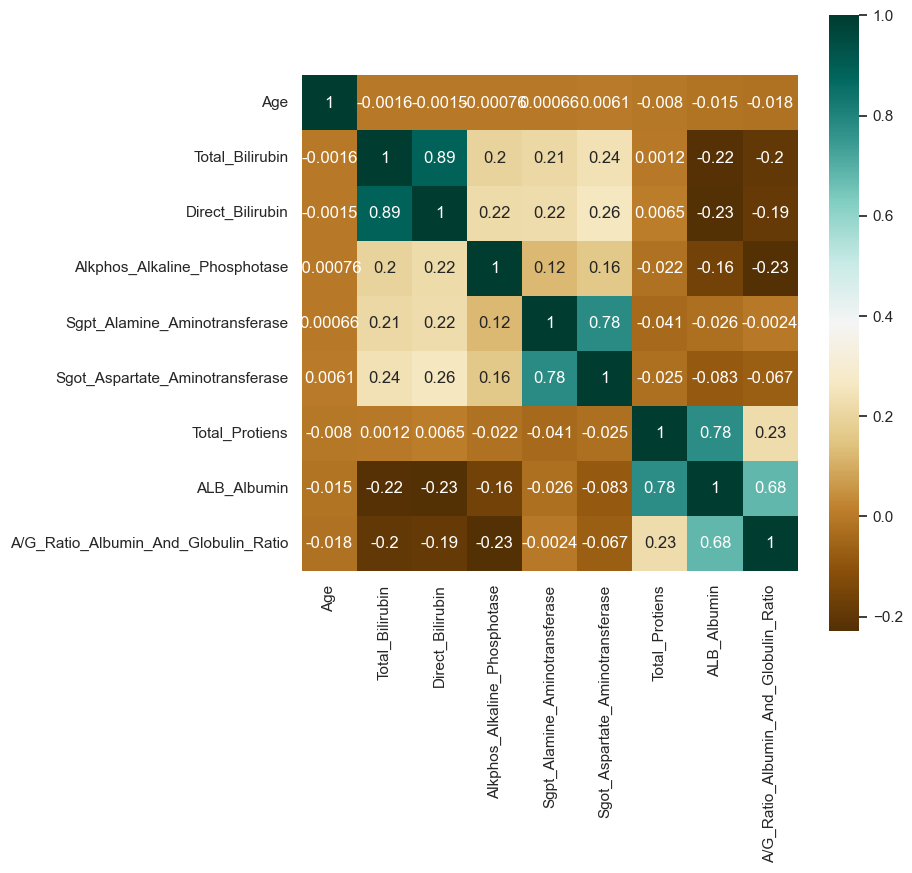

In [63]:
sns.set (rc = {'figure.figsize':(8, 8)})
sns.heatmap(Liver.corr(), square=True,annot=True, cmap="BrBG",);

**2.PairPlot**

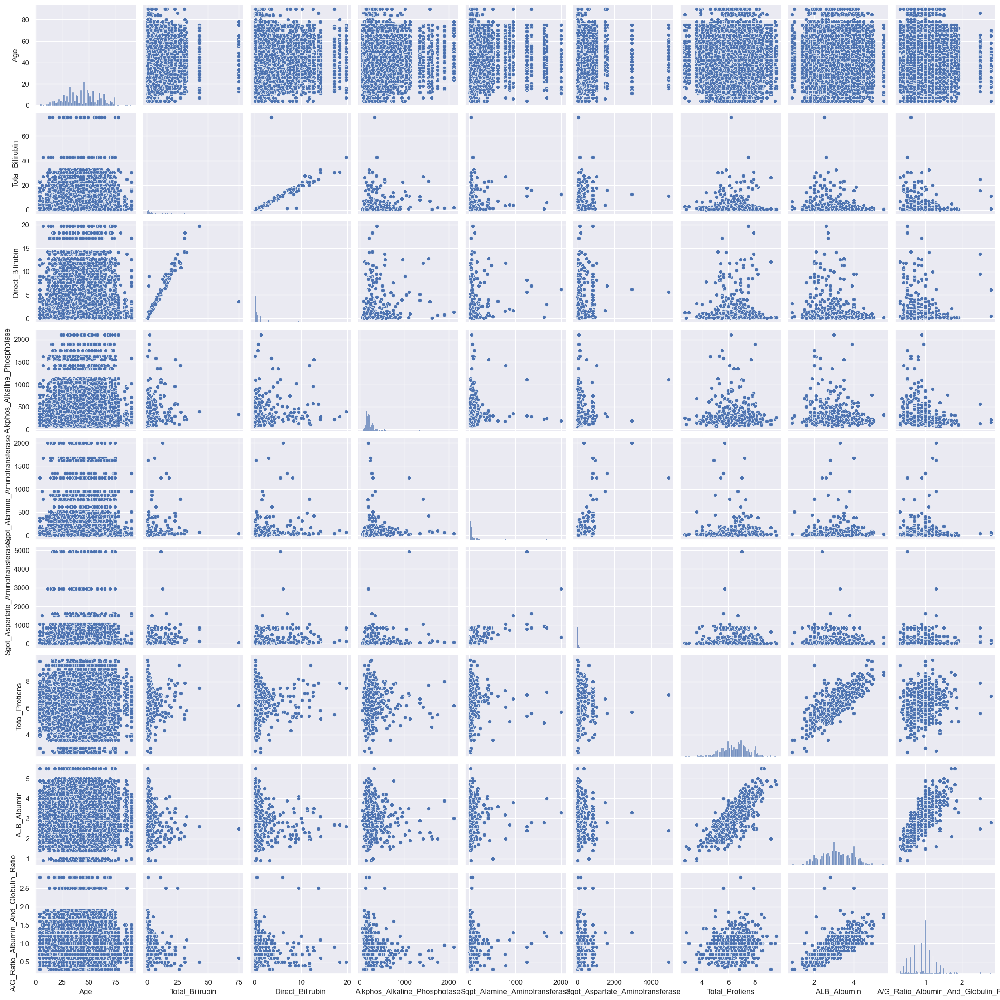

In [64]:
sns.set (rc = {'figure.figsize':(30, 30)})
sns.pairplot(Liver);

# Data Of Liver Disease Patients

In [65]:
LiverDisease = Liver[Liver['Liver_Disease'] == 'Yes']

In [66]:
LiverDisease

,Age,Gender,Total_Bilirubin,Direct_Bilirubin,Alkphos_Alkaline_Phosphotase,Sgpt_Alamine_Aminotransferase,Sgot_Aspartate_Aminotransferase,Total_Protiens,ALB_Albumin,A/G_Ratio_Albumin_And_Globulin_Ratio,Liver_Disease
0,65.0,Female,0.7,0.1,187.0,16.0,18.0,6.8,3.3,0.90,Yes
1,62.0,Male,10.9,5.5,699.0,64.0,100.0,7.5,3.2,0.74,Yes
2,62.0,Male,7.3,4.1,490.0,60.0,68.0,7.0,3.3,0.89,Yes
3,58.0,Male,1.0,0.4,182.0,14.0,20.0,6.8,3.4,1.00,Yes
4,72.0,Male,3.9,2.0,195.0,27.0,59.0,7.3,2.4,0.40,Yes
...,...,...,...,...,...,...,...,...,...,...,...
30686,50.0,Male,2.2,1.0,610.0,17.0,28.0,7.3,2.6,0.55,Yes
30687,55.0,Male,2.9,1.3,482.0,22.0,34.0,7.0,2.4,0.50,Yes
30688,54.0,Male,6.8,3.0,542.0,116.0,66.0,6.4,3.1,0.90,Yes
30689,48.0,Female,1.9,1.0,231.0,16.0,55.0,4.3,1.6,0.60,Yes


**1.Analysis Age Feature**

In [67]:
MaxAge1 = LiverDisease['Age'].max()
MinAge1 = LiverDisease['Age'].min()
MedianAge1 = LiverDisease['Age'].median()
AvgAge1 = sum(LiverDisease['Age']) / len(LiverDisease['Age'])

In [68]:
print('The Maximum Age Of Liver Disease Patients Is {:.1f} Years Old. \
      \nThe Minimum Age Of Liver Disease Patien Is {:.1f} Years Old.\
        \nThe Median Age Of Liver Disease Patient Is {:.1f} Years Old. \
         \nThe Average Age Of Liver Disease Patient Is {:.1f} Years Old'\
         .format(MaxAge1, MinAge1, MedianAge1, AvgAge1))

The Maximum Age Of Liver Disease Patients Is 90.0 Years Old.       
The Minimum Age Of Liver Disease Patien Is 4.0 Years Old.        
The Median Age Of Liver Disease Patient Is 45.0 Years Old.          
The Average Age Of Liver Disease Patient Is nan Years Old


In [69]:
print('{} Are Number Of Patients Younger Than 20 Years Old.\
    \n{} Are Number Of Patients Between 20 Years Old And 39 Years Old. \
    \n{} Are Number Of Patients Between 40 Years Old And 59 Years Old. \
      \n{} Are Number Of Patient Equal Or Older Than 60 Years Old'\
          .format(len(LiverDisease[LiverDisease['Age'].map(lambda x: x <20)]),\
              len(LiverDisease[LiverDisease['Age'].map(lambda x: x >=20 and x <40)]),\
                  len(LiverDisease[LiverDisease['Age'].map(lambda x: x >=40 and x <60)]),\
                      len(LiverDisease[LiverDisease['Age'].map(lambda x: x >=60)])))

1347 Are Number Of Patients Younger Than 20 Years Old.    
7217 Are Number Of Patients Between 20 Years Old And 39 Years Old.     
8871 Are Number Of Patients Between 40 Years Old And 59 Years Old.       
4480 Are Number Of Patient Equal Or Older Than 60 Years Old


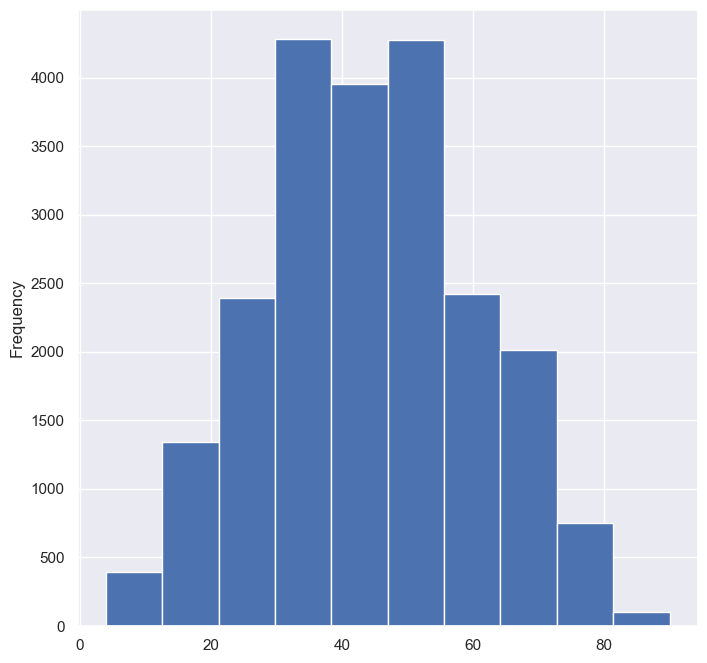

In [70]:
LiverDisease['Age'].plot(kind='hist', figsize=(8, 8), xlabel='Age');

**2.Analysis Gender Feature**

In [71]:
print('{} Is Number Of Male Liver Disease Patient. \
    \n{} Is Number Of Female Liver Disease Patient'.format(LiverDisease['Gender'].value_counts()['Male'], \
    LiverDisease['Gender'].value_counts()['Female']))

15742 Is Number Of Male Liver Disease Patient.     
5553 Is Number Of Female Liver Disease Patient


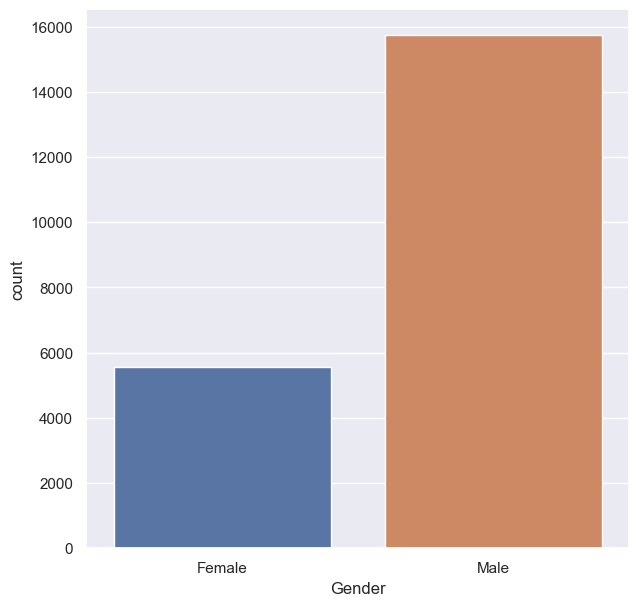

In [72]:
fig, ax = plt.subplots(figsize=(7, 7))
sns.countplot(ax=ax, data=LiverDisease, x=LiverDisease['Gender']);


**3.Analysis Total Bilirubin Feature**

In [73]:
MaxTotalBilirubin1 = LiverDisease['Total_Bilirubin'].max()
MinTotalBilirubin1 = LiverDisease['Total_Bilirubin'].min()
MedianTotalBilirubin1 = LiverDisease['Total_Bilirubin'].median()
AvgTotalBilirubin1 = LiverDisease['Total_Bilirubin'].sum() / len(LiverDisease['Total_Bilirubin'])

In [74]:
print('The Maximum Total Bilirubin In Liver Disease Patients Is {:.1f} . \
      \nThe Minimum Total Bilirubin In Liver Disease Patien Is {:.1f} .\
        \nThe Median Total Bilirubin In Liver Disease Patient Is {:.1f} . \
         \nThe Average Total Bilirubin In Liver Disease Patient Is {:.1f} '\
         .format(MaxTotalBilirubin1, MinTotalBilirubin1, MedianTotalBilirubin1, AvgTotalBilirubin1))

The Maximum Total Bilirubin In Liver Disease Patients Is 75.0 .       
The Minimum Total Bilirubin In Liver Disease Patien Is 0.4 .        
The Median Total Bilirubin In Liver Disease Patient Is 1.4 .          
The Average Total Bilirubin In Liver Disease Patient Is 4.2 


In [75]:
print('{} Are Number Of Patients Has Total Bilirubin Less Than 25  .\
    \n{} Are Number Of Patients Has Total Bilirubin Between 25  And 50  . \
    \n{} Are Number Of Patients Has Total Bilirubin More Than 50 .' 
          .format(len(LiverDisease[LiverDisease['Age'].map(lambda x:  x <25)]),\
              len(LiverDisease[LiverDisease['Age'].map(lambda x: x >=25 and x <=50)]),\
                  len(LiverDisease[LiverDisease['Age'].map(lambda x: x >50 )])))

2546 Are Number Of Patients Has Total Bilirubin Less Than 25  .    
12135 Are Number Of Patients Has Total Bilirubin Between 25  And 50  .     
7234 Are Number Of Patients Has Total Bilirubin More Than 50 .


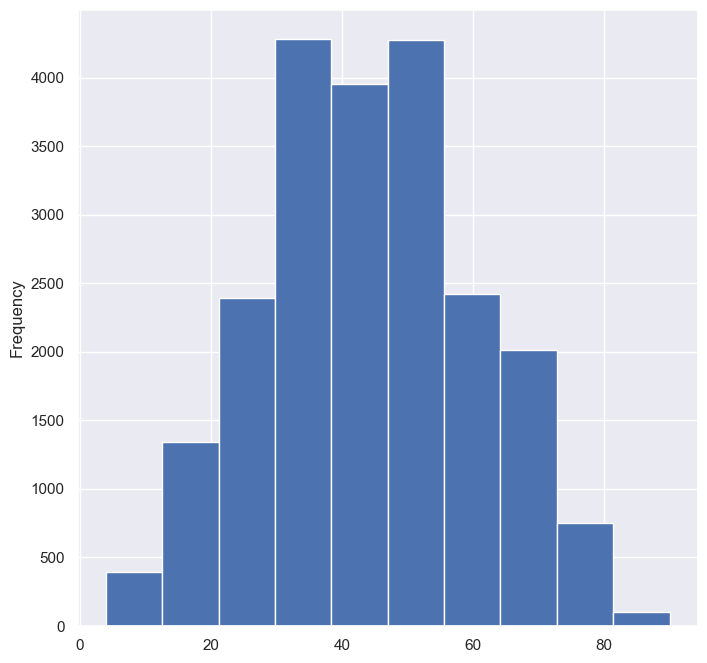

In [76]:
LiverDisease['Age'].plot(kind='hist', figsize=(8, 8), xlabel='Age');

**4.Analysis Direct Bilirubin Feature**


In [77]:
MaxDirectBilirubin1 = LiverDisease['Direct_Bilirubin'].max()
MinDirectBilirubin1 = LiverDisease['Direct_Bilirubin'].min()
MedianDirectBilirubin1 = LiverDisease['Direct_Bilirubin'].median()
AvgDirectBilirubin1 = LiverDisease['Direct_Bilirubin'].sum() / len(LiverDisease['Total_Bilirubin'])

In [78]:
print('The Maximum Direct Bilirubin In Liver Disease Patients Is {:.1f} . \
      \nThe Minimum Direct Bilirubin In Liver Disease Patien Is {:.1f} .\
        \nThe Median Direct Bilirubin In Liver Disease Patient Is {:.1f} . \
         \nThe Average Direct Bilirubin In Liver Disease Patient Is {:.1f} '\
         .format(MaxDirectBilirubin1, MinDirectBilirubin1, MedianDirectBilirubin1, AvgDirectBilirubin1))

The Maximum Direct Bilirubin In Liver Disease Patients Is 19.7 .       
The Minimum Direct Bilirubin In Liver Disease Patien Is 0.1 .        
The Median Direct Bilirubin In Liver Disease Patient Is 0.5 .          
The Average Direct Bilirubin In Liver Disease Patient Is 1.9 


In [79]:
print('{} Are Number Of Patients Has Direct Bilirubin Less Than 1.\
    \n{} Are Number Of Patients Has Direct Bilirubin Between 1 And 10. \
    \n{} Are Number Of Patients Has Direct Bilirubin More Than 10.' 
          .format(len(LiverDisease[LiverDisease['Direct_Bilirubin'].map(lambda x:x <1)]),\
              len(LiverDisease[LiverDisease['Direct_Bilirubin'].map(lambda x: x >=1 and x <=10)]),\
                  len(LiverDisease[LiverDisease['Direct_Bilirubin'].map(lambda x: x >10 )])))

12792 Are Number Of Patients Has Direct Bilirubin Less Than 1.    
7772 Are Number Of Patients Has Direct Bilirubin Between 1 And 10.     
972 Are Number Of Patients Has Direct Bilirubin More Than 10.


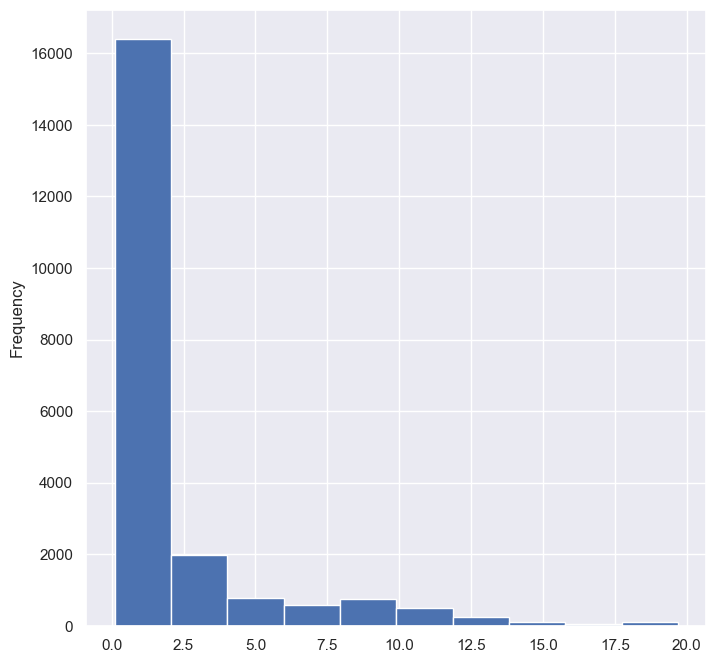

In [80]:
LiverDisease['Direct_Bilirubin'].plot(kind='hist', figsize=(8, 8), xlabel='Direct Bilirubin');

**5.Analysis Alkphos Alkaline Phosphotase Feature**

In [81]:
MaxAAP1 = LiverDisease['Alkphos_Alkaline_Phosphotase'].max()
MinAAP1 = LiverDisease['Alkphos_Alkaline_Phosphotase'].min()
MedianAAP1 = LiverDisease['Alkphos_Alkaline_Phosphotase'].median()
AvgAAP1 = LiverDisease['Alkphos_Alkaline_Phosphotase'].sum() / len(LiverDisease['Alkphos_Alkaline_Phosphotase'])

In [82]:
print('The Maximum Alkphos Alkaline Phosphotase In Liver Disease Patients Is {:.1f} . \
      \nThe Minimum Alkphos Alkaline Phosphotase In Liver Disease Patien Is {:.1f} .\
        \nThe Median Alkphos Alkaline Phosphotase In Liver Disease Patient Is {:.1f} . \
         \nThe Average Alkphos Alkaline Phosphotase In Liver Disease Patient Is {:.1f} '\
         .format(MaxAAP1, MinAAP1, MedianAAP1, AvgAAP1))

The Maximum Alkphos Alkaline Phosphotase In Liver Disease Patients Is 2110.0 .       
The Minimum Alkphos Alkaline Phosphotase In Liver Disease Patien Is 63.0 .        
The Median Alkphos Alkaline Phosphotase In Liver Disease Patient Is 230.0 .          
The Average Alkphos Alkaline Phosphotase In Liver Disease Patient Is 308.6 


In [83]:
print('{} Are Number Of Patients Has Alkphos Alkaline Phosphotase Less Than 100.\
    \n{} Are Number Of Patients Has Alkphos Alkaline Phosphotase Between 100 And 500. \
    \n{} Are Number Of Patients Has Alkphos Alkaline Phosphotase More Than 500.' 
          .format(len(LiverDisease[LiverDisease['Alkphos_Alkaline_Phosphotase'].map(lambda x:x <100)]),\
              len(LiverDisease[LiverDisease['Alkphos_Alkaline_Phosphotase'].map(lambda x: x >=100 and x <=500)]),\
                  len(LiverDisease[LiverDisease['Alkphos_Alkaline_Phosphotase'].map(lambda x: x >500)])))

324 Are Number Of Patients Has Alkphos Alkaline Phosphotase Less Than 100.    
18209 Are Number Of Patients Has Alkphos Alkaline Phosphotase Between 100 And 500.     
2821 Are Number Of Patients Has Alkphos Alkaline Phosphotase More Than 500.


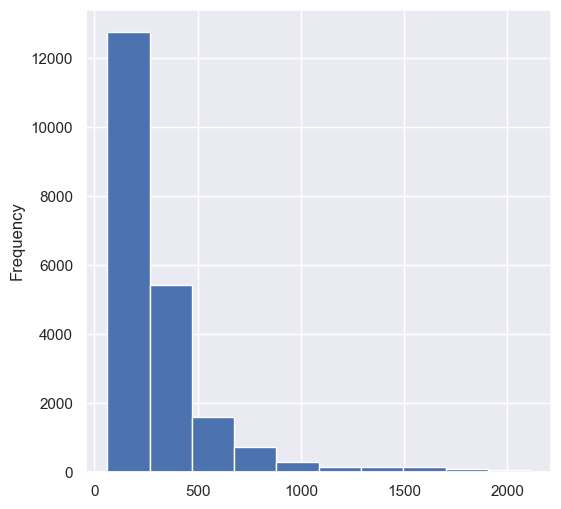

In [84]:
LiverDisease['Alkphos_Alkaline_Phosphotase'].plot(kind='hist', figsize=(6, 6), xlabel='Alkphos Alkaline Phosphotase');

**6.Analysis Sgpt Alamine Aminotransferase Feature**

In [85]:
MaxSGPT1 = LiverDisease['Sgpt_Alamine_Aminotransferase'].max()
MinSGPT1 = LiverDisease['Sgpt_Alamine_Aminotransferase'].min()
MedianSGPT1 = LiverDisease['Sgpt_Alamine_Aminotransferase'].median()
AvgSGPT1 = LiverDisease['Sgpt_Alamine_Aminotransferase'].sum() / len(LiverDisease['Sgpt_Alamine_Aminotransferase'])

In [86]:
print('The Maximum Sgpt Alamine Aminotransferase In Liver Disease Patients Is {:.1f} . \
      \nThe Minimum Sgpt Alamine Aminotransferase In Liver Disease Patien Is {:.1f} .\
        \nThe Median Sgpt Alamine Aminotransferase In Liver Disease Patient Is {:.1f} . \
         \nThe Average Sgpt Alamine Aminotransferase In Liver Disease Patient Is {:.1f} '\
         .format(MaxSGPT1, MinSGPT1, MedianSGPT1, AvgSGPT1))

The Maximum Sgpt Alamine Aminotransferase In Liver Disease Patients Is 2000.0 .       
The Minimum Sgpt Alamine Aminotransferase In Liver Disease Patien Is 12.0 .        
The Median Sgpt Alamine Aminotransferase In Liver Disease Patient Is 41.0 .          
The Average Sgpt Alamine Aminotransferase In Liver Disease Patient Is 98.9 


In [87]:
print('{} Are Number Of Patients Has Sgpt Alamine Aminotransferase Less Than 50.\
    \n{} Are Number Of Patients Has Sgpt Alamine Aminotransferase Between 50 And 500. \
    \n{} Are Number Of Patients Has Sgpt Alamine Aminotransferase More Than 500.' 
          .format(len(LiverDisease[LiverDisease['Sgpt_Alamine_Aminotransferase'].map(lambda x:x <50)]),\
              len(LiverDisease[LiverDisease['Sgpt_Alamine_Aminotransferase'].map(lambda x: x >=50 and x <=500)]),\
                  len(LiverDisease[LiverDisease['Sgpt_Alamine_Aminotransferase'].map(lambda x: x >500)])))

12473 Are Number Of Patients Has Sgpt Alamine Aminotransferase Less Than 50.    
8394 Are Number Of Patients Has Sgpt Alamine Aminotransferase Between 50 And 500.     
693 Are Number Of Patients Has Sgpt Alamine Aminotransferase More Than 500.


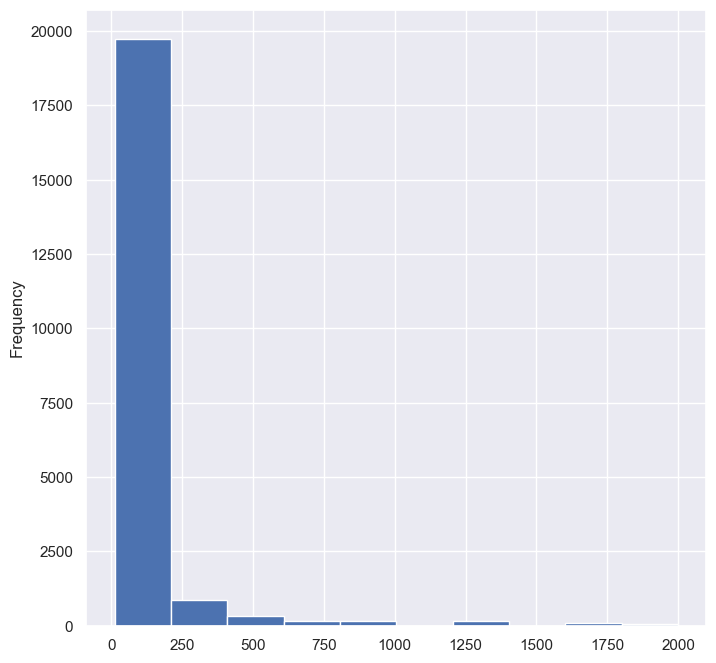

In [88]:
LiverDisease['Sgpt_Alamine_Aminotransferase'].plot(kind='hist', figsize=(8, 8), xlabel='Sgpt Alamine Aminotransferase');

**7.Sgot Aspartate Aminotransferase**

In [89]:
MaxSGOT1 = LiverDisease['Sgot_Aspartate_Aminotransferase'].max()
MinSGOT1 = LiverDisease['Sgot_Aspartate_Aminotransferase'].min()
MedianSGOT1 = LiverDisease['Sgot_Aspartate_Aminotransferase'].median()
AvgSGOT1 = LiverDisease['Sgot_Aspartate_Aminotransferase'].sum() / len(LiverDisease['Sgot_Aspartate_Aminotransferase'])

In [90]:
print('The Maximum Sgot Alamine Aminotransferase In Liver Disease Patients Is {:.1f} . \
      \nThe Minimum Sgot Alamine Aminotransferase In Liver Disease Patien Is {:.1f} .\
        \nThe Median Sgot Alamine Aminotransferase In Liver Disease Patient Is {:.1f} . \
         \nThe Average Sgot Alamine Aminotransferase In Liver Disease Patient Is {:.1f} '\
         .format(MaxSGOT1, MinSGOT1, MedianSGOT1, AvgSGOT1))

The Maximum Sgot Alamine Aminotransferase In Liver Disease Patients Is 4929.0 .       
The Minimum Sgot Alamine Aminotransferase In Liver Disease Patien Is 11.0 .        
The Median Sgot Alamine Aminotransferase In Liver Disease Patient Is 54.0 .          
The Average Sgot Alamine Aminotransferase In Liver Disease Patient Is 137.6 


In [91]:
print('{} Are Number Of Patients Has Sgot Alamine Aminotransferase Less Than 250.\
    \n{} Are Number Of Patients Has Sgot Alamine Aminotransferase Between 250 And 1000. \
    \n{} Are Number Of Patients Has Sgot Alamine Aminotransferase More Than 1000.' 
          .format(len(LiverDisease[LiverDisease['Sgpt_Alamine_Aminotransferase'].map(lambda x:x <250)]),\
              len(LiverDisease[LiverDisease['Sgpt_Alamine_Aminotransferase'].map(lambda x: x >=250 and x <=1000)]),\
                  len(LiverDisease[LiverDisease['Sgpt_Alamine_Aminotransferase'].map(lambda x: x >1000)])))

20090 Are Number Of Patients Has Sgot Alamine Aminotransferase Less Than 250.    
1165 Are Number Of Patients Has Sgot Alamine Aminotransferase Between 250 And 1000.     
305 Are Number Of Patients Has Sgot Alamine Aminotransferase More Than 1000.


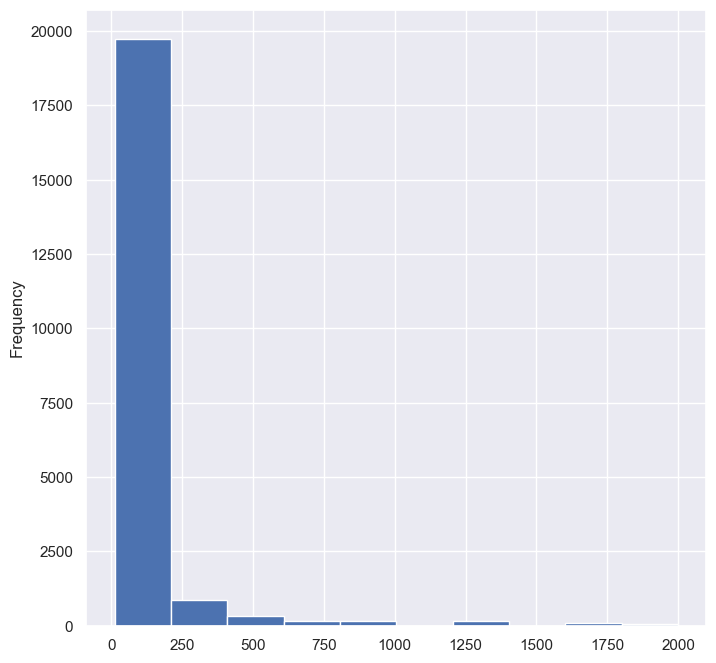

In [92]:
LiverDisease['Sgpt_Alamine_Aminotransferase'].plot(kind='hist', figsize=(8,8), xlabel='Sgpt Alamine Aminotransferase');

**8.Analysis Total Protiens Feature**

In [93]:
MaxTotalProtiens1 = LiverDisease['Total_Protiens'].max()
MinTotalProtiens1 = LiverDisease['Total_Protiens'].min()
MedianTotalProtiens1 = LiverDisease['Total_Protiens'].median()
AvgTotalProtiens1 = LiverDisease['Total_Protiens'].sum() / len(LiverDisease['Total_Protiens'])

In [94]:
print('The Maximum Total Protiens In Liver Disease Patients Is {:.1f} . \
      \nThe Minimum Total Protiens In Liver Disease Patien Is {:.1f} .\
        \nThe Median Total Protiens In Liver Disease Patient Is {:.1f} . \
         \nThe Average Total Protiens In Liver Disease Patient Is {:.1f} '\
         .format(MaxTotalProtiens1, MinTotalProtiens1, MedianTotalProtiens1, AvgTotalProtiens1))

The Maximum Total Protiens In Liver Disease Patients Is 9.6 .       
The Minimum Total Protiens In Liver Disease Patien Is 2.7 .        
The Median Total Protiens In Liver Disease Patient Is 6.6 .          
The Average Total Protiens In Liver Disease Patient Is 6.4 


In [95]:
print('{} Are Number Of Patients Has Total Protiens Less Than 1.\
    \n{} Are Number Of Patients Has Total Protiense Between 1 And 5. \
    \n{} Are Number Of Patients Has Total Protiens More Than 5.' 
          .format(len(LiverDisease[LiverDisease['Total_Protiens'].map(lambda x:x <1)]),\
              len(LiverDisease[LiverDisease['Total_Protiens'].map(lambda x: x >=1 and x <=5)]),\
                  len(LiverDisease[LiverDisease['Total_Protiens'].map(lambda x: x >5)])))

0 Are Number Of Patients Has Total Protiens Less Than 1.    
2080 Are Number Of Patients Has Total Protiense Between 1 And 5.     
19506 Are Number Of Patients Has Total Protiens More Than 5.


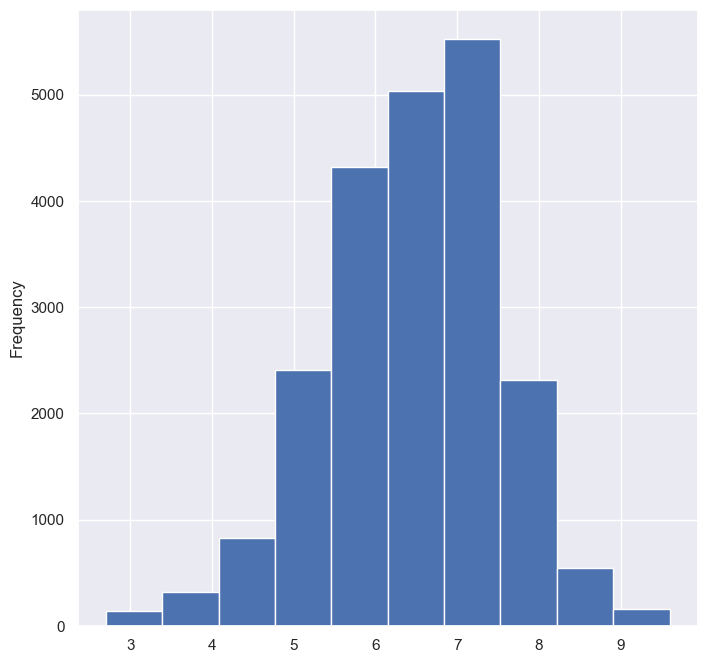

In [96]:
LiverDisease['Total_Protiens'].plot(kind='hist', figsize=(8, 8));

**9.Analysis ALB Albumin Feature**

In [97]:
MaxALBAlbumin1 = LiverDisease['ALB_Albumin'].max()
MinALBAlbumin1 = LiverDisease['ALB_Albumin'].min()
MedianALBAlbumin1 = LiverDisease['ALB_Albumin'].median()
AvgALBAlbumin1 = LiverDisease['ALB_Albumin'].sum() / len(LiverDisease['ALB_Albumin'])

In [98]:
print('The Maximum ALB Albumin In Liver Disease Patients Is {:.1f} . \
      \nThe Minimum ALB Albumin In Liver Disease Patien Is {:.1f} .\
        \nThe Median ALB Albumin In Liver Disease Patient Is {:.1f} . \
         \nThe Average ALB Albumin In Liver Disease Patient Is {:.1f} '\
         .format(MaxALBAlbumin1, MinALBAlbumin1, MedianALBAlbumin1, AvgALBAlbumin1))

The Maximum ALB Albumin In Liver Disease Patients Is 5.5 .       
The Minimum ALB Albumin In Liver Disease Patien Is 0.9 .        
The Median ALB Albumin In Liver Disease Patient Is 3.0 .          
The Average ALB Albumin In Liver Disease Patient Is 3.0 


In [99]:
print('{} Are Number Of Patients Has ALB Albumin Less Than 1.\
    \n{} Are Number Of Patients Has ALB Albumin Between 1 And 5. \
    \n{} Are Number Of Patients Has ALB Albumin More Than 5.' 
          .format(len(LiverDisease[LiverDisease['ALB_Albumin'].map(lambda x:x <1)]),\
              len(LiverDisease[LiverDisease['ALB_Albumin'].map(lambda x: x >=1 and x <=5)]),\
                  len(LiverDisease[LiverDisease['ALB_Albumin'].map(lambda x: x >5)])))

105 Are Number Of Patients Has ALB Albumin Less Than 1.    
21360 Are Number Of Patients Has ALB Albumin Between 1 And 5.     
96 Are Number Of Patients Has ALB Albumin More Than 5.


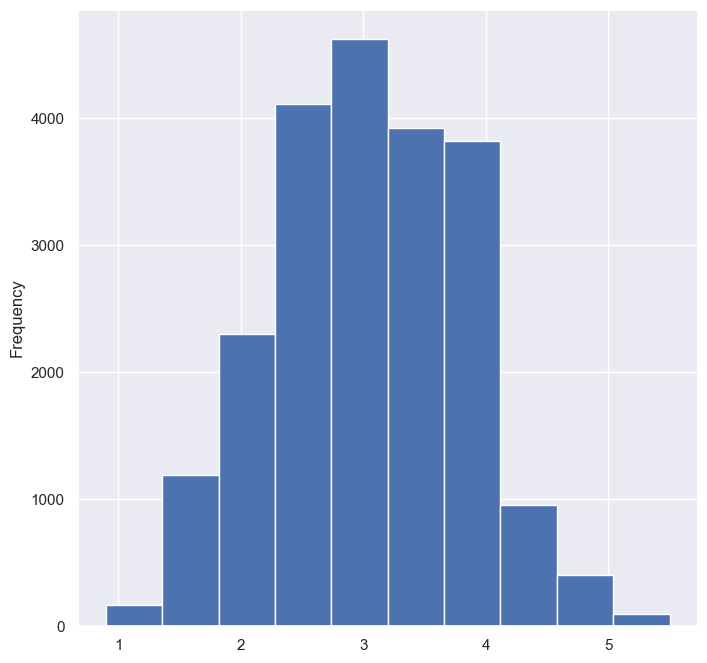

In [100]:
LiverDisease['ALB_Albumin'].plot(kind='hist', figsize=(8,8));

**10.Analysis A/G Ratio Albumin And Globulin Ratio Feature**

In [101]:
MaxAGRatio1 = LiverDisease['A/G_Ratio_Albumin_And_Globulin_Ratio'].max()
MinAGRatio1 = LiverDisease['A/G_Ratio_Albumin_And_Globulin_Ratio'].min()
MedianAGRatio1 = LiverDisease['A/G_Ratio_Albumin_And_Globulin_Ratio'].median()
AvgAGRatio1 = LiverDisease['A/G_Ratio_Albumin_And_Globulin_Ratio'].sum() / len(LiverDisease['A/G_Ratio_Albumin_And_Globulin_Ratio'])

In [102]:
print('The Maximum A/G Ratio Albumin And Globulin Ratio In Liver Disease Patients Is {:.1f} . \
      \nThe Minimum A/G Ratio Albumin And Globulin In Liver Disease Patien Is {:.1f} .\
        \nThe Median A/G Ratio Albumin And Globulin In Liver Disease Patient Is {:.1f} . \
         \nThe Average A/G Ratio Albumin And Globulin In Liver Disease Patient Is {:.1f} '\
         .format(MaxAGRatio1, MinAGRatio1, MedianAGRatio1, AvgAGRatio1))

The Maximum A/G Ratio Albumin And Globulin Ratio In Liver Disease Patients Is 2.8 .       
The Minimum A/G Ratio Albumin And Globulin In Liver Disease Patien Is 0.3 .        
The Median A/G Ratio Albumin And Globulin In Liver Disease Patient Is 0.9 .          
The Average A/G Ratio Albumin And Globulin In Liver Disease Patient Is 0.9 


In [103]:
print('{} Are Number Of Patients Has A/G Ratio Albumin And Globulin Less Than 1.\
    \n{} Are Number Of Patients Has A/G Ratio Albumin And Globulin Between 1 And 2. \
    \n{} Are Number Of Patients Has A/G Ratio Albumin And Globulin More Than 2.' 
          .format(len(LiverDisease[LiverDisease['A/G_Ratio_Albumin_And_Globulin_Ratio'].map(lambda x:x <1)]),\
              len(LiverDisease[LiverDisease['A/G_Ratio_Albumin_And_Globulin_Ratio'].map(lambda x: x >=1 and x <=2)]),\
                  len(LiverDisease[LiverDisease['A/G_Ratio_Albumin_And_Globulin_Ratio'].map(lambda x: x >2)])))

12092 Are Number Of Patients Has A/G Ratio Albumin And Globulin Less Than 1.    
9278 Are Number Of Patients Has A/G Ratio Albumin And Globulin Between 1 And 2.     
177 Are Number Of Patients Has A/G Ratio Albumin And Globulin More Than 2.


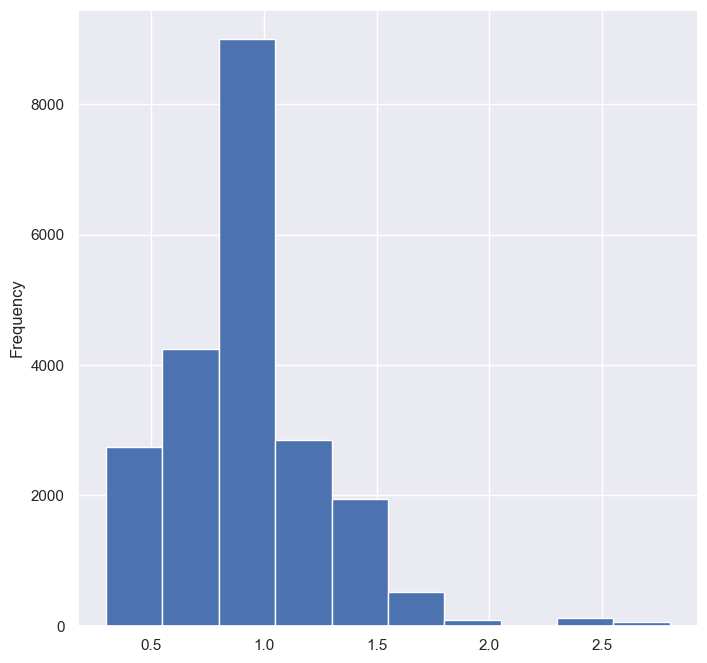

In [104]:
LiverDisease['A/G_Ratio_Albumin_And_Globulin_Ratio'].plot(kind='hist', figsize=(8, 8));

# Data Of Non Liver Disease Patients

In [105]:
NonLiverDisease = Liver[Liver['Liver_Disease'] == 'No']

In [106]:
NonLiverDisease

,Age,Gender,Total_Bilirubin,Direct_Bilirubin,Alkphos_Alkaline_Phosphotase,Sgpt_Alamine_Aminotransferase,Sgot_Aspartate_Aminotransferase,Total_Protiens,ALB_Albumin,A/G_Ratio_Albumin_And_Globulin_Ratio,Liver_Disease
8,17.0,Male,0.9,0.3,202.0,22.0,19.0,7.4,4.1,1.20,No
12,64.0,Male,0.9,0.3,310.0,61.0,58.0,7.0,3.4,0.90,No
15,25.0,Male,0.6,0.1,183.0,91.0,53.0,5.5,2.3,0.70,No
17,33.0,Male,1.6,0.5,165.0,15.0,23.0,7.3,3.5,0.92,No
24,63.0,Male,0.9,0.2,194.0,52.0,45.0,6.0,3.9,1.85,No
...,...,...,...,...,...,...,...,...,...,...,...
30674,60.0,Female,0.7,0.2,145.0,18.0,36.0,7.2,3.9,1.18,No
30679,74.0,Male,0.6,0.1,160.0,42.0,110.0,4.9,2.6,1.10,No
30680,25.0,NaN,NaN,NaN,630.0,25.0,47.0,6.1,2.3,0.60,No
30682,24.0,NaN,NaN,NaN,208.0,17.0,15.0,7.0,3.6,1.00,No


**1.Analysis Age Feature**

In [107]:
MaxAge2 = NonLiverDisease['Age'].max()
MinAge2 = NonLiverDisease['Age'].min()
MedianAge2 = NonLiverDisease['Age'].median()
AvgAge2 = sum(NonLiverDisease['Age']) / len(NonLiverDisease['Age'])

In [108]:
print('The Maximum Age Of Liver Disease Patients Is {:.1f} Years Old. \
      \nThe Minimum Age Of Liver Disease Patien Is {:.1f} Years Old.\
        \nThe Median Age Of Liver Disease Patient Is {:.1f} Years Old. \
         \nThe Average Age Of Liver Disease Patient Is {:.1f} Years Old'\
         .format(MaxAge2, MinAge2, MedianAge2, AvgAge2))

The Maximum Age Of Liver Disease Patients Is 90.0 Years Old.       
The Minimum Age Of Liver Disease Patien Is 4.0 Years Old.        
The Median Age Of Liver Disease Patient Is 45.0 Years Old.          
The Average Age Of Liver Disease Patient Is 44.0 Years Old


In [109]:
print('{} Are Number Of Patients Younger Than 20 Years Old.\
    \n{} Are Number Of Patients Between 20 Years Old And 39 Years Old. \
    \n{} Are Number Of Patients Between 40 Years Old And 59 Years Old. \
      \n{} Are Number Of Patient Equal Or Older Than 60 Years Old'\
          .format(len(NonLiverDisease[NonLiverDisease['Age'].map(lambda x: x <20)]),\
              len(NonLiverDisease[NonLiverDisease['Age'].map(lambda x: x >=20 and x <40)]),\
                  len(NonLiverDisease[NonLiverDisease['Age'].map(lambda x: x >=40 and x <60)]),\
                      len(NonLiverDisease[NonLiverDisease['Age'].map(lambda x: x >=60)])))

534 Are Number Of Patients Younger Than 20 Years Old.    
2961 Are Number Of Patients Between 20 Years Old And 39 Years Old.     
3502 Are Number Of Patients Between 40 Years Old And 59 Years Old.       
1777 Are Number Of Patient Equal Or Older Than 60 Years Old


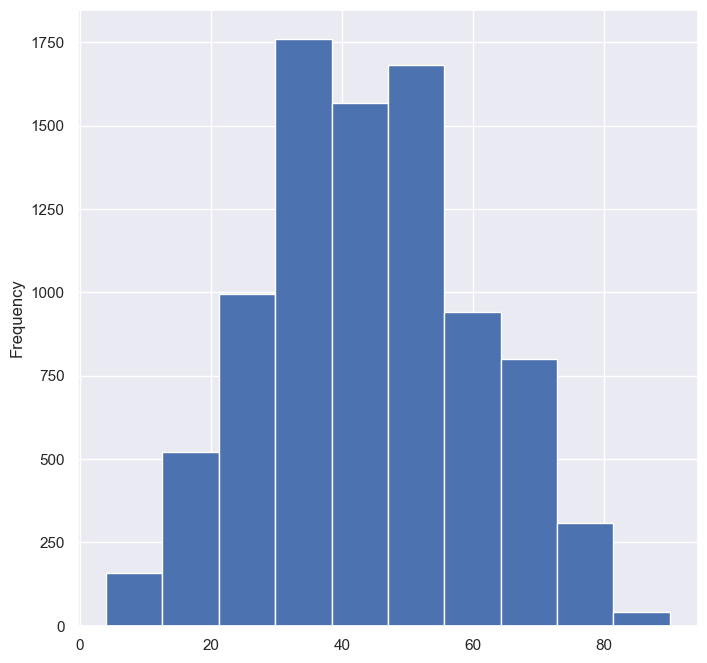

In [110]:
NonLiverDisease['Age'].plot(kind='hist', figsize=(8, 8), xlabel='Age');

**2.Analysis Gender Feature**

In [111]:
print('{} Is Number Of Male Liver Disease Patient. \
    \n{} Is Number Of Female Liver Disease Patient'.format(NonLiverDisease['Gender'].value_counts()['Male'], \
    NonLiverDisease['Gender'].value_counts()['Female']))

6244 Is Number Of Male Liver Disease Patient.     
2250 Is Number Of Female Liver Disease Patient


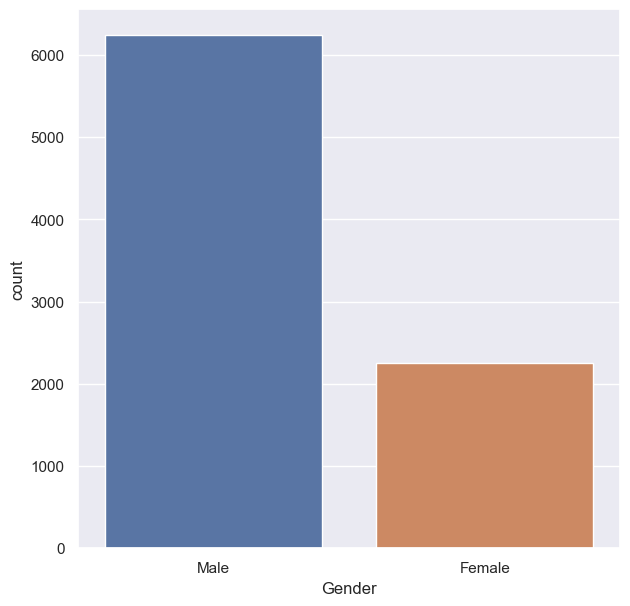

In [112]:
fig, ax = plt.subplots(figsize=(7, 7))
sns.countplot(ax=ax, data=NonLiverDisease, x=NonLiverDisease['Gender']);


**3.Analysis Total Bilirubin Feature**


In [113]:
MaxTotalBilirubin2 = NonLiverDisease['Total_Bilirubin'].max()
MinTotalBilirubin2 = NonLiverDisease['Total_Bilirubin'].min()
MedianTotalBilirubin2 = NonLiverDisease['Total_Bilirubin'].median()
AvgTotalBilirubin2 = NonLiverDisease['Total_Bilirubin'].sum() / len(LiverDisease['Total_Bilirubin'])

In [114]:
print('The Maximum Total Bilirubin In Liver Disease Patients Is {:.1f} . \
      \nThe Minimum Total Bilirubin In Liver Disease Patien Is {:.1f} .\
        \nThe Median Total Bilirubin In Liver Disease Patient Is {:.1f} . \
         \nThe Average Total Bilirubin In Liver Disease Patient Is {:.1f} '\
         .format(MaxTotalBilirubin2, MinTotalBilirubin2, MedianTotalBilirubin2, AvgTotalBilirubin2))

The Maximum Total Bilirubin In Liver Disease Patients Is 7.3 .       
The Minimum Total Bilirubin In Liver Disease Patien Is 0.5 .        
The Median Total Bilirubin In Liver Disease Patient Is 0.8 .          
The Average Total Bilirubin In Liver Disease Patient Is 0.4 


In [115]:
print('{} Are Number Of Patients Has Total Bilirubin Less Than 25  .\
    \n{} Are Number Of Patients Has Total Bilirubin Between 25  And 50  . \
    \n{} Are Number Of Patients Has Total Bilirubin More Than 50 .' 
          .format(len(NonLiverDisease[NonLiverDisease['Age'].map(lambda x:  x <25)]),\
              len(NonLiverDisease[NonLiverDisease['Age'].map(lambda x: x >=25 and x <=50)]),\
                  len(NonLiverDisease[NonLiverDisease['Age'].map(lambda x: x >50 )])))

1026 Are Number Of Patients Has Total Bilirubin Less Than 25  .    
4856 Are Number Of Patients Has Total Bilirubin Between 25  And 50  .     
2892 Are Number Of Patients Has Total Bilirubin More Than 50 .


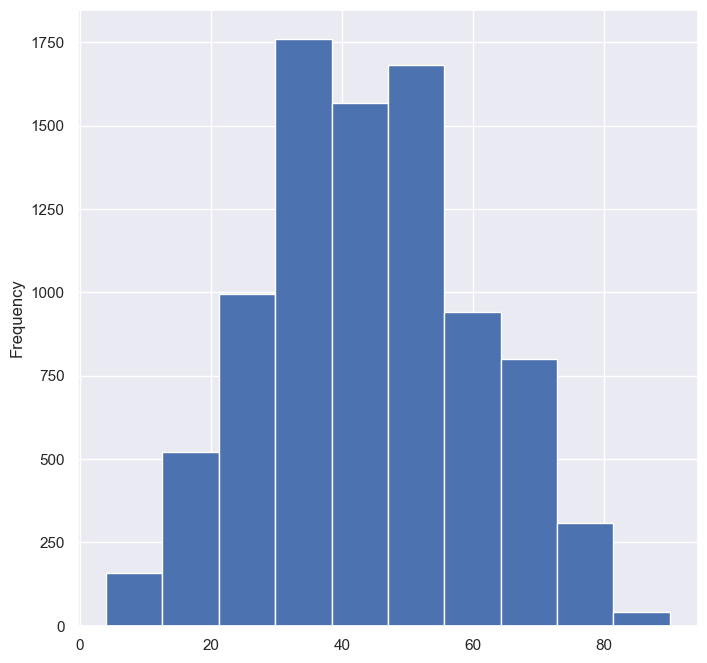

In [116]:
NonLiverDisease['Age'].plot(kind='hist', figsize=(8, 8), xlabel='Age');

**4.Analysis Direct Bilirubin Feature**


In [117]:
MaxDirectBilirubin2 = NonLiverDisease['Direct_Bilirubin'].max()
MinDirectBilirubin2 = NonLiverDisease['Direct_Bilirubin'].min()
MedianDirectBilirubin2 = NonLiverDisease['Direct_Bilirubin'].median()
AvgDirectBilirubin2 = NonLiverDisease['Direct_Bilirubin'].sum() / len(LiverDisease['Total_Bilirubin'])

In [118]:
print('The Maximum Direct Bilirubin In Liver Disease Patients Is {:.1f} . \
      \nThe Minimum Direct Bilirubin In Liver Disease Patien Is {:.1f} .\
        \nThe Median Direct Bilirubin In Liver Disease Patient Is {:.1f} . \
         \nThe Average Direct Bilirubin In Liver Disease Patient Is {:.1f} '\
         .format(MaxDirectBilirubin2, MinDirectBilirubin2, MedianDirectBilirubin2, AvgDirectBilirubin2))

The Maximum Direct Bilirubin In Liver Disease Patients Is 3.6 .       
The Minimum Direct Bilirubin In Liver Disease Patien Is 0.1 .        
The Median Direct Bilirubin In Liver Disease Patient Is 0.2 .          
The Average Direct Bilirubin In Liver Disease Patient Is 0.2 


In [119]:
print('{} Are Number Of Patients Has Direct Bilirubin Less Than 1.\
    \n{} Are Number Of Patients Has Direct Bilirubin Between 1 And 10. \
    \n{} Are Number Of Patients Has Direct Bilirubin More Than 10.' 
          .format(len(NonLiverDisease[NonLiverDisease['Direct_Bilirubin'].map(lambda x:x <1)]),\
              len(NonLiverDisease[NonLiverDisease['Direct_Bilirubin'].map(lambda x: x >=1 and x <=10)]),\
                  len(NonLiverDisease[NonLiverDisease['Direct_Bilirubin'].map(lambda x: x >10 )])))

7916 Are Number Of Patients Has Direct Bilirubin Less Than 1.    
678 Are Number Of Patients Has Direct Bilirubin Between 1 And 10.     
0 Are Number Of Patients Has Direct Bilirubin More Than 10.


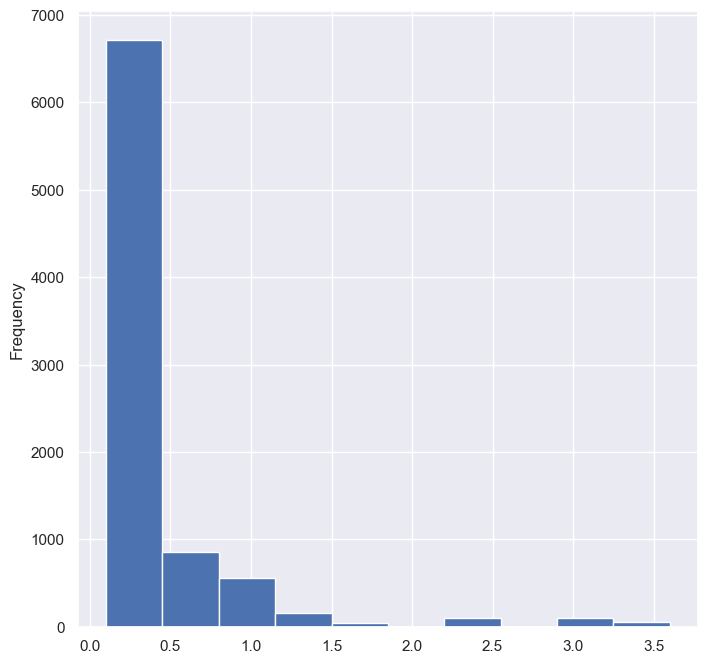

In [120]:
NonLiverDisease['Direct_Bilirubin'].plot(kind='hist', figsize=(8, 8), xlabel='Direct Bilirubin');

**5.Analysis Alkphos Alkaline Phosphotase Feature**

In [121]:
MaxAAP2 = NonLiverDisease['Alkphos_Alkaline_Phosphotase'].max()
MinAAP2 = NonLiverDisease['Alkphos_Alkaline_Phosphotase'].min()
MedianAAP2 = NonLiverDisease['Alkphos_Alkaline_Phosphotase'].median()
AvgAAP2 = NonLiverDisease['Alkphos_Alkaline_Phosphotase'].sum() / len(NonLiverDisease['Alkphos_Alkaline_Phosphotase'])

In [122]:
print('The Maximum Alkphos Alkaline Phosphotase In Liver Disease Patients Is {:.1f} . \
      \nThe Minimum Alkphos Alkaline Phosphotase In Liver Disease Patien Is {:.1f} .\
        \nThe Median Alkphos Alkaline Phosphotase In Liver Disease Patient Is {:.1f} . \
         \nThe Average Alkphos Alkaline Phosphotase In Liver Disease Patient Is {:.1f} '\
         .format(MaxAAP2, MinAAP2, MedianAAP2, AvgAAP2))

The Maximum Alkphos Alkaline Phosphotase In Liver Disease Patients Is 1580.0 .       
The Minimum Alkphos Alkaline Phosphotase In Liver Disease Patien Is 90.0 .        
The Median Alkphos Alkaline Phosphotase In Liver Disease Patient Is 186.0 .          
The Average Alkphos Alkaline Phosphotase In Liver Disease Patient Is 214.1 


In [123]:
print('{} Are Number Of Patients Has Alkphos Alkaline Phosphotase Less Than 100.\
    \n{} Are Number Of Patients Has Alkphos Alkaline Phosphotase Between 100 And 500. \
    \n{} Are Number Of Patients Has Alkphos Alkaline Phosphotase More Than 500.' 
          .format(len(NonLiverDisease[NonLiverDisease['Alkphos_Alkaline_Phosphotase'].map(lambda x:x <100)]),\
              len(NonLiverDisease[NonLiverDisease['Alkphos_Alkaline_Phosphotase'].map(lambda x: x >=100 and x <=500)]),\
                  len(NonLiverDisease[NonLiverDisease['Alkphos_Alkaline_Phosphotase'].map(lambda x: x >500)])))

54 Are Number Of Patients Has Alkphos Alkaline Phosphotase Less Than 100.    
8230 Are Number Of Patients Has Alkphos Alkaline Phosphotase Between 100 And 500.     
257 Are Number Of Patients Has Alkphos Alkaline Phosphotase More Than 500.


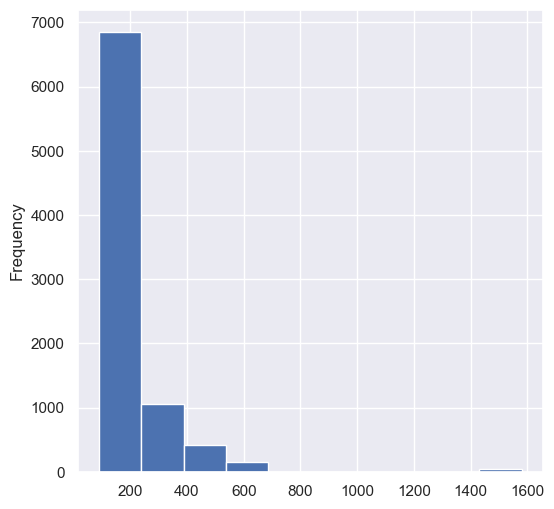

In [124]:
NonLiverDisease['Alkphos_Alkaline_Phosphotase'].plot(kind='hist', figsize=(6, 6), xlabel='Alkphos Alkaline Phosphotase');

**6.Analysis Sgpt Alamine Aminotransferase Feature**

In [125]:
MaxSGPT2 = NonLiverDisease['Sgpt_Alamine_Aminotransferase'].max()
MinSGPT2 = NonLiverDisease['Sgpt_Alamine_Aminotransferase'].min()
MedianSGPT2 = NonLiverDisease['Sgpt_Alamine_Aminotransferase'].median()
AvgSGPT2 = NonLiverDisease['Sgpt_Alamine_Aminotransferase'].sum() / len(NonLiverDisease['Sgpt_Alamine_Aminotransferase'])

In [126]:
print('The Maximum Sgpt Alamine Aminotransferase In Liver Disease Patients Is {:.1f} . \
      \nThe Minimum Sgpt Alamine Aminotransferase In Liver Disease Patien Is {:.1f} .\
        \nThe Median Sgpt Alamine Aminotransferase In Liver Disease Patient Is {:.1f} . \
         \nThe Average Sgpt Alamine Aminotransferase In Liver Disease Patient Is {:.1f} '\
         .format(MaxSGPT2, MinSGPT2, MedianSGPT2, AvgSGPT2))

The Maximum Sgpt Alamine Aminotransferase In Liver Disease Patients Is 181.0 .       
The Minimum Sgpt Alamine Aminotransferase In Liver Disease Patien Is 10.0 .        
The Median Sgpt Alamine Aminotransferase In Liver Disease Patient Is 27.0 .          
The Average Sgpt Alamine Aminotransferase In Liver Disease Patient Is 32.9 


In [127]:
print('{} Are Number Of Patients Has Sgpt Alamine Aminotransferase Less Than 50.\
    \n{} Are Number Of Patients Has Sgpt Alamine Aminotransferase Between 50 And 500. \
    \n{} Are Number Of Patients Has Sgpt Alamine Aminotransferase More Than 500.' 
          .format(len(NonLiverDisease[NonLiverDisease['Sgpt_Alamine_Aminotransferase'].map(lambda x:x <50)]),\
              len(NonLiverDisease[NonLiverDisease['Sgpt_Alamine_Aminotransferase'].map(lambda x: x >=50 and x <=500)]),\
                  len(NonLiverDisease[NonLiverDisease['Sgpt_Alamine_Aminotransferase'].map(lambda x: x >500)])))

7398 Are Number Of Patients Has Sgpt Alamine Aminotransferase Less Than 50.    
1195 Are Number Of Patients Has Sgpt Alamine Aminotransferase Between 50 And 500.     
0 Are Number Of Patients Has Sgpt Alamine Aminotransferase More Than 500.


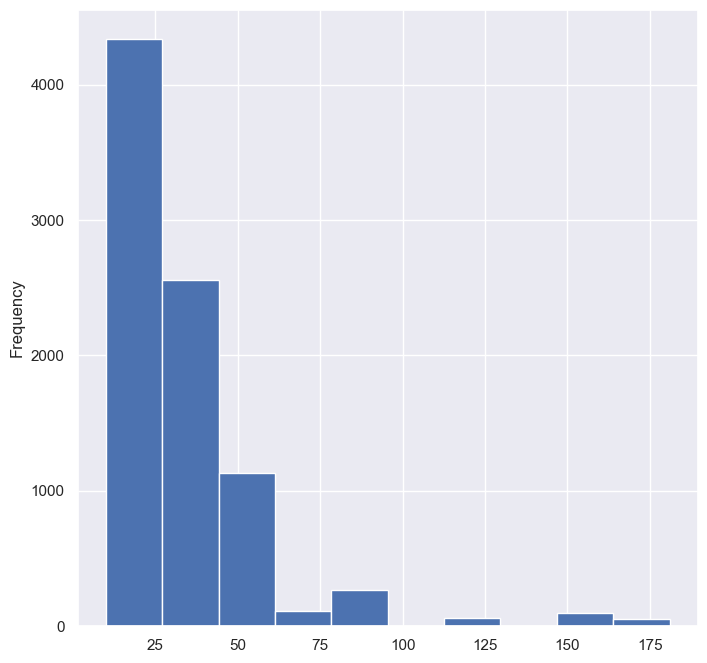

In [128]:
NonLiverDisease['Sgpt_Alamine_Aminotransferase'].plot(kind='hist', figsize=(8, 8), xlabel='Sgpt Alamine Aminotransferase');

**7.Sgot Aspartate Aminotransferase**

In [129]:
MaxSGOT2 = NonLiverDisease['Sgot_Aspartate_Aminotransferase'].max()
MinSGOT2 = NonLiverDisease['Sgot_Aspartate_Aminotransferase'].min()
MedianSGOT2 = NonLiverDisease['Sgot_Aspartate_Aminotransferase'].median()
AvgSGOT2 = NonLiverDisease['Sgot_Aspartate_Aminotransferase'].sum() / len(NonLiverDisease['Sgot_Aspartate_Aminotransferase'])

In [130]:
print('The Maximum Sgot Alamine Aminotransferase In Liver Disease Patients Is {:.1f} . \
      \nThe Minimum Sgot Alamine Aminotransferase In Liver Disease Patien Is {:.1f} .\
        \nThe Median Sgot Alamine Aminotransferase In Liver Disease Patient Is {:.1f} . \
         \nThe Average Sgot Alamine Aminotransferase In Liver Disease Patient Is {:.1f} '\
         .format(MaxSGOT2, MinSGOT2, MedianSGOT2, AvgSGOT2))

The Maximum Sgot Alamine Aminotransferase In Liver Disease Patients Is 400.0 .       
The Minimum Sgot Alamine Aminotransferase In Liver Disease Patien Is 10.0 .        
The Median Sgot Alamine Aminotransferase In Liver Disease Patient Is 29.0 .          
The Average Sgot Alamine Aminotransferase In Liver Disease Patient Is 40.4 


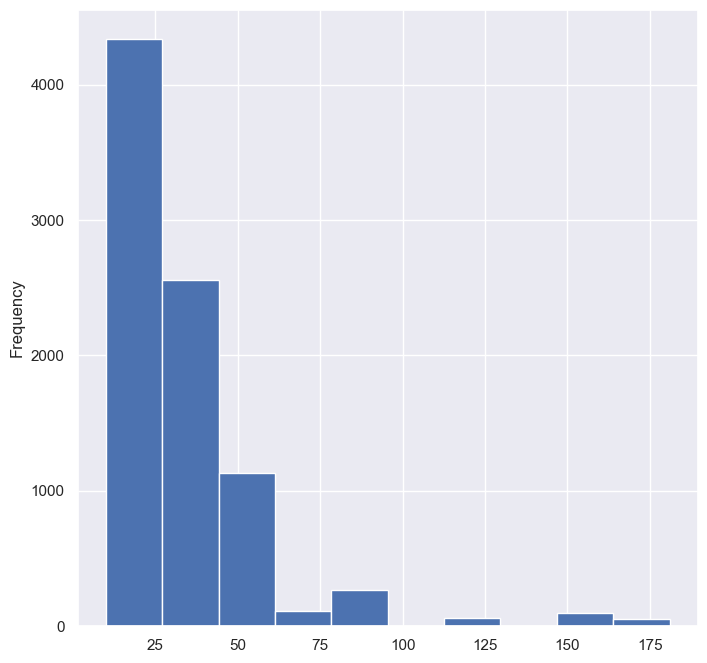

In [131]:
NonLiverDisease['Sgpt_Alamine_Aminotransferase'].plot(kind='hist', figsize=(8,8), xlabel='Sgpt Alamine Aminotransferase');

**8.Analysis Total Protiens Feature**

In [132]:
MaxTotalProtiens2 = NonLiverDisease['Total_Protiens'].max()
MinTotalProtiens2 = NonLiverDisease['Total_Protiens'].min()
MedianTotalProtiens2 = NonLiverDisease['Total_Protiens'].median()
AvgTotalProtiens2= NonLiverDisease['Total_Protiens'].sum() / len(NonLiverDisease['Total_Protiens'])

In [133]:
print('The Maximum Total Protiens In Liver Disease Patients Is {:.1f} . \
      \nThe Minimum Total Protiens In Liver Disease Patien Is {:.1f} .\
        \nThe Median Total Protiens In Liver Disease Patient Is {:.1f} . \
         \nThe Average Total Protiens In Liver Disease Patient Is {:.1f} '\
         .format(MaxTotalProtiens2, MinTotalProtiens2, MedianTotalProtiens2, AvgTotalProtiens2))

The Maximum Total Protiens In Liver Disease Patients Is 9.2 .       
The Minimum Total Protiens In Liver Disease Patien Is 3.7 .        
The Median Total Protiens In Liver Disease Patient Is 6.6 .          
The Average Total Protiens In Liver Disease Patient Is 6.4 


In [134]:
print('{} Are Number Of Patients Has Total Protiens Less Than 1.\
    \n{} Are Number Of Patients Has Total Protiense Between 1 And 5. \
    \n{} Are Number Of Patients Has Total Protiens More Than 5.' 
          .format(len(NonLiverDisease[NonLiverDisease['Total_Protiens'].map(lambda x:x <1)]),\
              len(NonLiverDisease[NonLiverDisease['Total_Protiens'].map(lambda x: x >=1 and x <=5)]),\
                  len(NonLiverDisease[NonLiverDisease['Total_Protiens'].map(lambda x: x >5)])))

0 Are Number Of Patients Has Total Protiens Less Than 1.    
651 Are Number Of Patients Has Total Protiense Between 1 And 5.     
7991 Are Number Of Patients Has Total Protiens More Than 5.


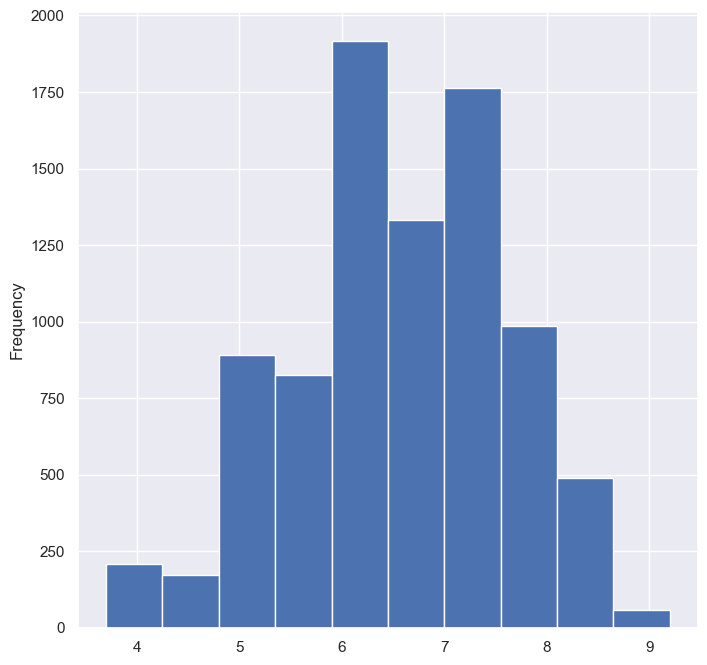

In [135]:
NonLiverDisease['Total_Protiens'].plot(kind='hist', figsize=(8, 8));

**9.Analysis ALB Albumin Feature**

In [136]:
MaxALBAlbumin2 = NonLiverDisease['ALB_Albumin'].max()
MinALBAlbumin2 = NonLiverDisease['ALB_Albumin'].min()
MedianALBAlbumin2 = NonLiverDisease['ALB_Albumin'].median()
AvgALBAlbumin2 = NonLiverDisease['ALB_Albumin'].sum() / len(NonLiverDisease['ALB_Albumin'])

In [137]:
print('The Maximum ALB Albumin In Liver Disease Patients Is {:.1f} . \
      \nThe Minimum ALB Albumin In Liver Disease Patien Is {:.1f} .\
        \nThe Median ALB Albumin In Liver Disease Patient Is {:.1f} . \
         \nThe Average ALB Albumin In Liver Disease Patient Is {:.1f} '\
         .format(MaxALBAlbumin2, MinALBAlbumin2, MedianALBAlbumin2, AvgALBAlbumin2))

The Maximum ALB Albumin In Liver Disease Patients Is 5.0 .       
The Minimum ALB Albumin In Liver Disease Patien Is 1.4 .        
The Median ALB Albumin In Liver Disease Patient Is 3.3 .          
The Average ALB Albumin In Liver Disease Patient Is 3.3 


In [138]:
print('{} Are Number Of Patients Has ALB Albumin Less Than 1.\
    \n{} Are Number Of Patients Has ALB Albumin Between 1 And 4. \
    \n{} Are Number Of Patients Has ALB Albumin More Than 4.' 
          .format(len(NonLiverDisease[NonLiverDisease['ALB_Albumin'].map(lambda x:x <1)]),\
              len(NonLiverDisease[NonLiverDisease['ALB_Albumin'].map(lambda x: x >=1 and x <=4)]),\
                  len(NonLiverDisease[NonLiverDisease['ALB_Albumin'].map(lambda x: x >4)])))

0 Are Number Of Patients Has ALB Albumin Less Than 1.    
6884 Are Number Of Patients Has ALB Albumin Between 1 And 4.     
1752 Are Number Of Patients Has ALB Albumin More Than 4.


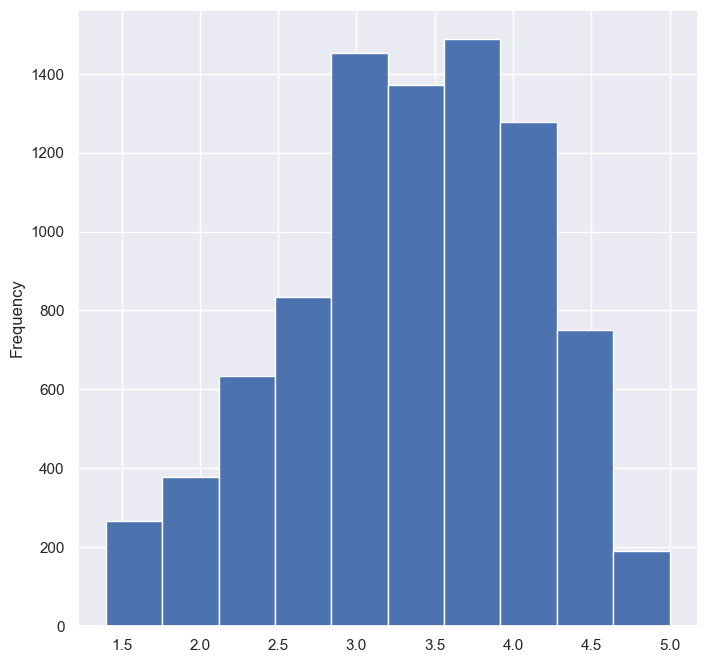

In [139]:
NonLiverDisease['ALB_Albumin'].plot(kind='hist', figsize=(8,8));

**10.Analysis A/G Ratio Albumin And Globulin Ratio Feature**

In [140]:
MaxAGRatio2 = NonLiverDisease['A/G_Ratio_Albumin_And_Globulin_Ratio'].max()
MinAGRatio2 = NonLiverDisease['A/G_Ratio_Albumin_And_Globulin_Ratio'].min()
MedianAGRatio2 = NonLiverDisease['A/G_Ratio_Albumin_And_Globulin_Ratio'].median()
AvgAGRatio2 = NonLiverDisease['A/G_Ratio_Albumin_And_Globulin_Ratio'].sum() / len(NonLiverDisease['A/G_Ratio_Albumin_And_Globulin_Ratio'])

In [141]:
print('The Maximum A/G Ratio Albumin And Globulin Ratio In Liver Disease Patients Is {:.1f} . \
      \nThe Minimum A/G Ratio Albumin And Globulin In Liver Disease Patien Is {:.1f} .\
        \nThe Median A/G Ratio Albumin And Globulin In Liver Disease Patient Is {:.1f} . \
         \nThe Average A/G Ratio Albumin And Globulin In Liver Disease Patient Is {:.1f} '\
         .format(MaxAGRatio2, MinAGRatio2, MedianAGRatio2, AvgAGRatio2))

The Maximum A/G Ratio Albumin And Globulin Ratio In Liver Disease Patients Is 1.9 .       
The Minimum A/G Ratio Albumin And Globulin In Liver Disease Patien Is 0.4 .        
The Median A/G Ratio Albumin And Globulin In Liver Disease Patient Is 1.0 .          
The Average A/G Ratio Albumin And Globulin In Liver Disease Patient Is 1.0 


In [142]:
print('{} Are Number Of Patients Has A/G Ratio Albumin And Globulin Less Than 1.\
    \n{} Are Number Of Patients Has A/G Ratio Albumin And Globulin Between 1 And 2. \
    \n{} Are Number Of Patients Has A/G Ratio Albumin And Globulin More Than 2.' 
          .format(len(NonLiverDisease[NonLiverDisease['A/G_Ratio_Albumin_And_Globulin_Ratio'].map(lambda x:x <1)]),\
              len(NonLiverDisease[NonLiverDisease['A/G_Ratio_Albumin_And_Globulin_Ratio'].map(lambda x: x >=1 and x <=2)]),\
                  len(NonLiverDisease[NonLiverDisease['A/G_Ratio_Albumin_And_Globulin_Ratio'].map(lambda x: x >2)])))

3516 Are Number Of Patients Has A/G Ratio Albumin And Globulin Less Than 1.    
5069 Are Number Of Patients Has A/G Ratio Albumin And Globulin Between 1 And 2.     
0 Are Number Of Patients Has A/G Ratio Albumin And Globulin More Than 2.


# Dealing With Missing Values


In [143]:
TotalMissing = Liver.isnull().sum().sort_values(ascending=False)
PercentMissing = ((Liver.isnull().sum() / Liver.count() * 10)).sort_values(ascending=False)
MissingData = pd.concat([TotalMissing, PercentMissing], axis=1, keys=['Total', 'Percent'])
MissingData.head(10)

,Total,Percent
Gender,902,0.3028
Alkphos_Alkaline_Phosphotase,796,0.2663
Total_Bilirubin,648,0.2157
Direct_Bilirubin,561,0.1862
A/G_Ratio_Albumin_And_Globulin_Ratio,559,0.1855
Sgpt_Alamine_Aminotransferase,538,0.1784
ALB_Albumin,494,0.1636
Total_Protiens,463,0.1532
Sgot_Aspartate_Aminotransferase,462,0.1528
Age,2,0.0007


In [144]:
Impute = SimpleImputer(missing_values=np.nan, strategy='mean')
Liver['Age'] = Impute.fit_transform(np.array(Liver['Age']).reshape(-1, 1))
Liver['Total_Bilirubin'] = Impute.fit_transform(np.array(Liver['Total_Bilirubin']).reshape(-1, 1))
Liver['Direct_Bilirubin'] = Impute.fit_transform(np.array(Liver['Direct_Bilirubin']).reshape(-1, 1))
Liver['Alkphos_Alkaline_Phosphotase'] = Impute.fit_transform(np.array(Liver['Alkphos_Alkaline_Phosphotase']).reshape(-1, 1))
Liver['Sgpt_Alamine_Aminotransferase'] = Impute.fit_transform(np.array(Liver['Sgpt_Alamine_Aminotransferase']).reshape(-1, 1))
Liver['Total_Protiens'] = Impute.fit_transform(np.array(Liver['Total_Protiens']).reshape(-1, 1))
Liver['ALB_Albumin'] = Impute.fit_transform(np.array(Liver['ALB_Albumin']).reshape(-1, 1))
Liver['A/G_Ratio_Albumin_And_Globulin_Ratio'] = Impute.fit_transform(np.array(Liver['A/G_Ratio_Albumin_And_Globulin_Ratio']).reshape(-1, 1))
Liver['Sgot_Aspartate_Aminotransferase'] = Impute.fit_transform(np.array(Liver['Sgot_Aspartate_Aminotransferase']).reshape(-1, 1))

In [145]:
Impute2 = SimpleImputer(missing_values=np.nan, strategy='most_frequent')
Liver['Gender'] = Impute2.fit_transform(np.array(Liver['Gender']).reshape(-1, 1))

# Encoding Categorical Values

In [146]:
LabelEncoder = LabelEncoder()
Liver['Gender'] = LabelEncoder.fit_transform(Liver['Gender'])

In [147]:
Liver.dtypes

Age                                     float32
Gender                                    int64
Total_Bilirubin                         float32
Direct_Bilirubin                        float32
Alkphos_Alkaline_Phosphotase            float32
Sgpt_Alamine_Aminotransferase           float32
Sgot_Aspartate_Aminotransferase         float32
Total_Protiens                          float32
ALB_Albumin                             float32
A/G_Ratio_Albumin_And_Globulin_Ratio    float32
Liver_Disease                            object
dtype: object

# Data Transformation

In [148]:
Liver['Age']= np.sqrt(Liver['Age'])
Liver['Total_Bilirubin']= np.sqrt(Liver['Total_Bilirubin'])
Liver['Direct_Bilirubin']= np.sqrt(Liver['Direct_Bilirubin'])
Liver['Alkphos_Alkaline_Phosphotase']= np.sqrt(Liver['Alkphos_Alkaline_Phosphotase'])
Liver['Sgpt_Alamine_Aminotransferase']= np.sqrt(Liver['Sgpt_Alamine_Aminotransferase'])
Liver['Sgot_Aspartate_Aminotransferase']= np.sqrt(Liver['Sgot_Aspartate_Aminotransferase'])
Liver['Total_Protiens']= np.sqrt(Liver['Total_Protiens'])
Liver['ALB_Albumin']= np.sqrt(Liver['ALB_Albumin'])
Liver['A/G_Ratio_Albumin_And_Globulin_Ratio']= np.sqrt(Liver['A/G_Ratio_Albumin_And_Globulin_Ratio'])

# Normalization 

In [149]:
Norm = MinMaxScaler(feature_range=(0, 1))
Liver['Age']= Norm.fit_transform(np.array(Liver['Age']).reshape(-1,1))
Liver['Total_Bilirubin']= Norm.fit_transform(np.array(Liver['Total_Bilirubin']).reshape(-1,1))
Liver['Direct_Bilirubin']= Norm.fit_transform(np.array(Liver['Direct_Bilirubin']).reshape(-1,1))
Liver['Alkphos_Alkaline_Phosphotase']= Norm.fit_transform(np.array(Liver['Alkphos_Alkaline_Phosphotase']).reshape(-1,1))
Liver['Sgpt_Alamine_Aminotransferase']= Norm.fit_transform(np.array(Liver['Sgpt_Alamine_Aminotransferase']).reshape(-1,1))
Liver['Sgot_Aspartate_Aminotransferase']= Norm.fit_transform(np.array(Liver['Sgot_Aspartate_Aminotransferase']).reshape(-1,1))
Liver['Total_Protiens']= Norm.fit_transform(np.array(Liver['Total_Protiens']).reshape(-1,1))
Liver['ALB_Albumin']= Norm.fit_transform(np.array(Liver['ALB_Albumin']).reshape(-1,1))
Liver['A/G_Ratio_Albumin_And_Globulin_Ratio']= Norm.fit_transform(np.array(Liver['A/G_Ratio_Albumin_And_Globulin_Ratio']).reshape(-1,1))

# Split The DataSet

In [150]:
X = Liver.drop(["Liver_Disease"], inplace=False, axis=1)
y = Liver['Liver_Disease']

In [151]:
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.33, random_state=42)

# Models

In [152]:
class Models:    
    def DecisionTree(X_train, y_train):
        model = DecisionTreeClassifier()
        model .fit(X_train, y_train)
        return model
    
    def RandomForest(X_train, y_train):
        model = RandomForestClassifier()
        model .fit(X_train, y_train)
        return model

    def SVM(X_train, y_train):
        model = SVC()
        model .fit(X_train, y_train)
        return model

    def KNN(X_train, y_train):
        model = KNeighborsClassifier()
        model .fit(X_train, y_train)
        return model
    
    def NaivBayes(X_train, y_train):
        model = GaussianNB()
        model .fit(X_train, y_train)
        return model
    
    def LogistRegression(X_train, y_train):
        model = LogisticRegression()
        model .fit(X_train, y_train)
        return model
    
    def MLP(X_train, y_train):
        model = MLPClassifier()
        model .fit(X_train, y_train)
        return model
    
    def ANN(X_train, y_train):
        model = tf.keras.models.Sequential()
        model.add(tf.keras.layers.Dense(units=10, activation='relu'))
        model.add(tf.keras.layers.Dense(units=8, activation='relu'))
        model.add(tf.keras.layers.Dense(units=6, activation='relu'))
        model.add(tf.keras.layers.Dense(units=1, activation='sigmoid'))
        model.compile(optimizer= tf.keras.optimizers.legacy.Adam(), loss= 'binary_crossentropy' , metrics = ['accuracy'])
        model.fit(X_train, y_train, epochs=100, batch_size = 32, verbose=0)
        return model

In [153]:
class Evaluation:
    def Accuracy(y_test, y_pred):
        return accuracy_score(y_test, y_pred)
    
    def Precision(y_test, y_pred):
        return precision_score(y_test, y_pred, average="macro")
    
    def Recall(y_test, y_pred):
        return recall_score(y_test, y_pred, average="macro")
    
    def F1(y_test, y_pred):
        return f1_score(y_test, y_pred, average="macro")
    
    def ConfusionMatrix(y_test, y_pred):
        return confusion_matrix(y_test, y_pred)
    


**1.Decision Tree**

In [154]:
Decision_Tree = Models.DecisionTree(X_train, y_train)
y_pred = Decision_Tree.predict(X_test)

In [155]:
print('The Accuracy Score Of Decision Tree Is:', Evaluation.Accuracy(y_test, y_pred))

The Accuracy Score Of Decision Tree Is: 0.9910158949550795


In [156]:
print('The Recall Score Of Decision Tree Is:', Evaluation.Recall(y_test, y_pred))

The Recall Score Of Decision Tree Is: 0.9890431601273251


In [157]:
print('The F1 Score Of Decision Tree Is:', Evaluation.F1(y_test, y_pred))

The F1 Score Of Decision Tree Is: 0.9888861793122274


In [158]:
print('The Precision Score Of Decision Tree Is:', Evaluation.Precision(y_test, y_pred))

The Precision Score Of Decision Tree Is: 0.9887295137295138


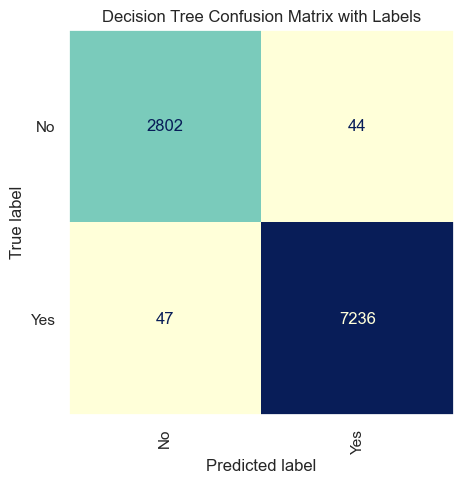

In [159]:
disp = ConfusionMatrixDisplay(confusion_matrix=Evaluation.ConfusionMatrix(y_test, y_pred), display_labels=Decision_Tree.classes_)
fig, ax = plt.subplots(figsize=(5,5))
disp.plot(cmap='YlGnBu', colorbar=False, xticks_rotation='vertical', values_format='d', ax=ax)
plt.title('Decision Tree Confusion Matrix with Labels')
plt.rcParams['font.size'] = '20'
plt.grid(None)
plt.show()

**2.Random Forest**

In [160]:
Random_Forest = Models.RandomForest(X_train, y_train)
y_pred = Random_Forest.predict(X_test)

In [161]:
print('The Accuracy Score Of Random Forest Is:', Evaluation.Accuracy(y_test, y_pred))

The Accuracy Score Of Random Forest Is: 0.996840754269918


In [162]:
print('The Recall Score Of Random Forest Is:', Evaluation.Recall(y_test, y_pred))

The Recall Score Of Random Forest Is: 0.9949132352133778


In [163]:
print('The F1 Score Of Random Forest Is:', Evaluation.F1(y_test, y_pred))

The F1 Score Of Random Forest Is: 0.9960813386277239


In [164]:
print('The Precision Score Of Random Forest:', Evaluation.Precision(y_test, y_pred))

The Precision Score Of Random Forest: 0.9972666815968728


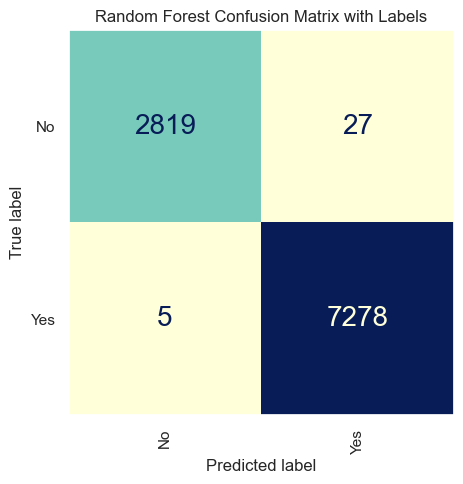

In [165]:
disp = ConfusionMatrixDisplay(confusion_matrix=Evaluation.ConfusionMatrix(y_test, y_pred), display_labels=Random_Forest.classes_)
fig, ax = plt.subplots(figsize=(5,5))
disp.plot(cmap='YlGnBu', colorbar=False, xticks_rotation='vertical', values_format='d', ax=ax)
plt.title('Random Forest Confusion Matrix with Labels')
plt.rcParams['font.size'] = '20'
plt.grid(None)
plt.show()

**3.Naive Bayes**

In [166]:
Naive_Bayes = Models.NaivBayes(X_train, y_train)
y_pred = Naive_Bayes.predict(X_test)

In [167]:
print('The Accuracy Score Of Naive Bayes Is:', Evaluation.Accuracy(y_test, y_pred))

The Accuracy Score Of Naive Bayes Is: 0.6138809359265476


In [168]:
print('The Recall Score Of Naive Bayes Is:', Evaluation.Recall(y_test, y_pred))

The Recall Score Of Naive Bayes Is: 0.6993883656903142


In [169]:
print('The F1 Score Of Naive Bayes Is:', Evaluation.F1(y_test, y_pred))

The F1 Score Of Naive Bayes Is: 0.6090496217929826


In [170]:
print('The F1 Score Of Naive Bayes Is:', Evaluation.F1(y_test, y_pred))

The F1 Score Of Naive Bayes Is: 0.6090496217929826


In [171]:
print('The Precision Score Of Naive Bayes Forest:', Evaluation.Precision(y_test, y_pred))

The Precision Score Of Naive Bayes Forest: 0.6689921868214745


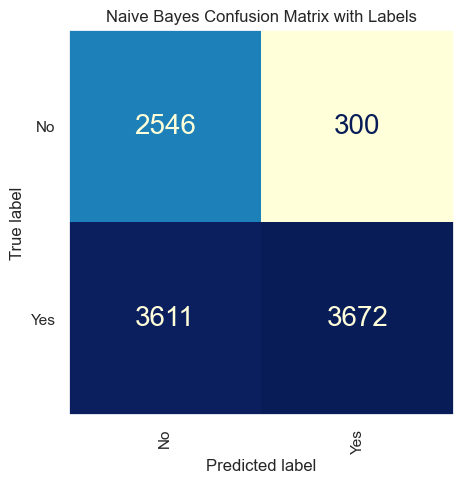

In [172]:
disp = ConfusionMatrixDisplay(confusion_matrix=Evaluation.ConfusionMatrix(y_test, y_pred), display_labels=Naive_Bayes.classes_)
fig, ax = plt.subplots(figsize=(5,5))
disp.plot(cmap='YlGnBu', colorbar=False, xticks_rotation='vertical', values_format='d', ax=ax)
plt.title('Naive Bayes Confusion Matrix with Labels')
plt.rcParams['font.size'] = '20'
plt.grid(None)
plt.show()

**4.Saupport Vector Machine**

In [173]:
SVM = Models.SVM(X_train, y_train)
y_pred = SVM.predict(X_test)

In [174]:
print('The Accuracy Score Of Support Vector Machine Is:', Evaluation.Accuracy(y_test, y_pred))

The Accuracy Score Of Support Vector Machine Is: 0.7190245828808371


In [175]:
print('The Recall Score Of Support Vaector Machine Is:', Evaluation.Recall(y_test, y_pred))

The Recall Score Of Support Vaector Machine Is: 0.5


In [176]:
print('The F1 Score Of Support Vector Machine Is:', Evaluation.F1(y_test, y_pred))

The F1 Score Of Support Vector Machine Is: 0.4182747530438778


In [177]:
print('The Precision Score Of Support Vector Machine Is:', Evaluation.Precision(y_test, y_pred))

The Precision Score Of Support Vector Machine Is: 0.3595122914404186


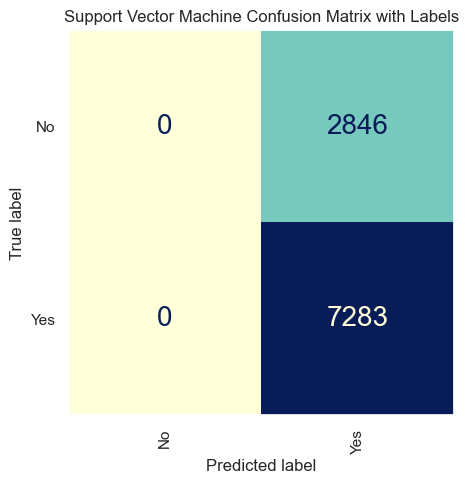

In [178]:
disp = ConfusionMatrixDisplay(confusion_matrix=Evaluation.ConfusionMatrix(y_test, y_pred), display_labels=SVM.classes_)
fig, ax = plt.subplots(figsize=(5,5))
disp.plot(cmap='YlGnBu', colorbar=False, xticks_rotation='vertical', values_format='d', ax=ax)
plt.title('Support Vector Machine Confusion Matrix with Labels')
plt.rcParams['font.size'] = '20'
plt.grid(None)
plt.show()

**5.Logistic Regression**

In [179]:
Logistic_Regression = Models.LogistRegression(X_train, y_train)
y_pred = Logistic_Regression.predict(X_test)

In [180]:
print('The Accuracy Score Of Logistic Regression Is:', Evaluation.Accuracy(y_test, y_pred))

The Accuracy Score Of Logistic Regression Is: 0.7195182150261625


In [181]:
print('The Recall Score Of Logistic Regression Is:', Evaluation.Recall(y_test, y_pred))

The Recall Score Of Logistic Regression Is: 0.572589962724735


In [182]:
print('The F1 Score Of Logistic Regression Is:', Evaluation.F1(y_test, y_pred))

The F1 Score Of Logistic Regression Is: 0.5726483842110874


In [183]:
print('The Precision Score Of Random Tree Forest IS:', Evaluation.Precision(y_test, y_pred))

The Precision Score Of Random Tree Forest IS: 0.6273524099240931


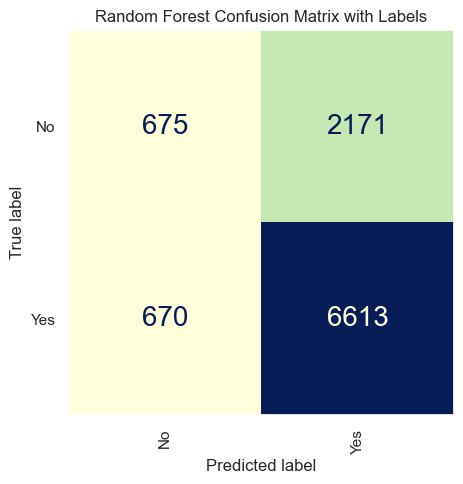

In [184]:
disp = ConfusionMatrixDisplay(confusion_matrix=Evaluation.ConfusionMatrix(y_test, y_pred), display_labels=Logistic_Regression.classes_)
fig, ax = plt.subplots(figsize=(5,5))
disp.plot(cmap='YlGnBu', colorbar=False, xticks_rotation='vertical', values_format='d', ax=ax)
plt.title('Random Forest Confusion Matrix with Labels')
plt.rcParams['font.size'] = '20'
plt.grid(None)
plt.show()

**6.K-Nearest Neighbors**

In [185]:
KNN = Models.KNN(X_train, y_train)
y_pred = KNN.predict(X_test)

In [186]:
print('The Accuracy Score Of K-Nearest Neighbors Is:', Evaluation.Accuracy(y_test, y_pred))

The Accuracy Score Of K-Nearest Neighbors Is: 0.9243755553361634


In [187]:
print('The Recall Score Of K-Nearest Neighbors Is:', Evaluation.Recall(y_test, y_pred))

The Recall Score Of K-Nearest Neighbors Is: 0.905027051608647


In [188]:
print('The F1 Score Of K-Nearest Neighbors Is:', Evaluation.F1(y_test, y_pred))

The F1 Score Of K-Nearest Neighbors Is: 0.9061565534412717


In [189]:
print('The Precision Score Of K-Nearest Neighbors IS:', Evaluation.Precision(y_test, y_pred))

The Precision Score Of K-Nearest Neighbors IS: 0.9073072739428413


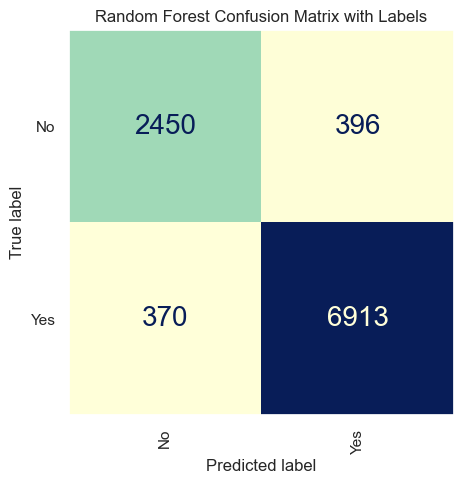

In [190]:
disp = ConfusionMatrixDisplay(confusion_matrix=Evaluation.ConfusionMatrix(y_test, y_pred), display_labels=KNN.classes_)
fig, ax = plt.subplots(figsize=(5,5))
disp.plot(cmap='YlGnBu', colorbar=False, xticks_rotation='vertical', values_format='d', ax=ax)
plt.title('Random Forest Confusion Matrix with Labels')
plt.rcParams['font.size'] = '20'
plt.grid(None)
plt.show()

**7.Multilayer Perceptron Neural Network**

In [191]:
MLP = Models.MLP(X_train, y_train)
y_pred = MLP.predict(X_test)

In [192]:
print('The Accuracy Score Of Multilayer Perceptron Neural Network Is:', Evaluation.Accuracy(y_test, y_pred))

The Accuracy Score Of Multilayer Perceptron Neural Network Is: 0.7559482673511699


In [193]:
print('The Recall Score Of Multilayer Perceptron Neural Network Is:', Evaluation.Recall(y_test, y_pred))

The Recall Score Of Multilayer Perceptron Neural Network Is: 0.6382740484125905


In [194]:
print('The F1 Score Of Multilayer Perceptron Neural Network Is:', Evaluation.F1(y_test, y_pred))

The F1 Score Of Multilayer Perceptron Neural Network Is: 0.6510786274049889


In [195]:
print('The Precision Score Of Multilayer Perceptron Neural Network Is:', Evaluation.Precision(y_test, y_pred))

The Precision Score Of Multilayer Perceptron Neural Network Is: 0.697247814390235


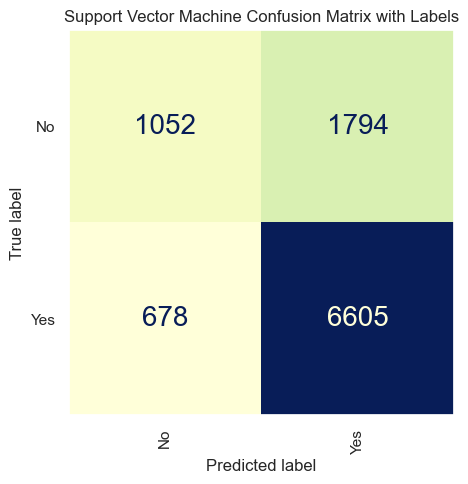

In [196]:
disp = ConfusionMatrixDisplay(confusion_matrix=Evaluation.ConfusionMatrix(y_test, y_pred), display_labels=MLP.classes_)
fig, ax = plt.subplots(figsize=(5,5))
disp.plot(cmap='YlGnBu', colorbar=False, xticks_rotation='vertical', values_format='d', ax=ax)
plt.title('Support Vector Machine Confusion Matrix with Labels')
plt.rcParams['font.size'] = '20'
plt.grid(None)
plt.show()

**9.Artificial Neural Network**

In [197]:
y_train2 = LabelEncoder.fit_transform(y_train)
y_test2 = LabelEncoder.fit_transform(y_test)

In [198]:
with tf.device('cpu'):
    ANN = Models.ANN(X_train, y_train2)
    y_pred = ANN.predict(X_test)

Metal device set to: Apple M1

systemMemory: 8.00 GB
maxCacheSize: 2.67 GB

317/317 [==============================] - 0s 263us/step


In [199]:
print('The Accuracy Score Of Artificial Neural Network Is:', Evaluation.Accuracy(y_test2, y_pred> 0.5))

The Accuracy Score Of Artificial Neural Network Is: 0.7640438345345049


In [200]:
print('The Recall Score Of Artificial Neural Network Is:', Evaluation.Recall(y_test2, y_pred> 0.5))

The Recall Score Of Artificial Neural Network Is: 0.6854320687699742


In [201]:
print('The F1 Score Of Artificial Neural Network Is:', Evaluation.F1(y_test2, y_pred> 0.5))

The F1 Score Of Artificial Neural Network Is: 0.6935143307561925


In [202]:
print('The Precision Score Of Artificial Neural Network IS:', Evaluation.Precision(y_test2, y_pred> 0.5))

The Precision Score Of Artificial Neural Network IS: 0.7057902480708811


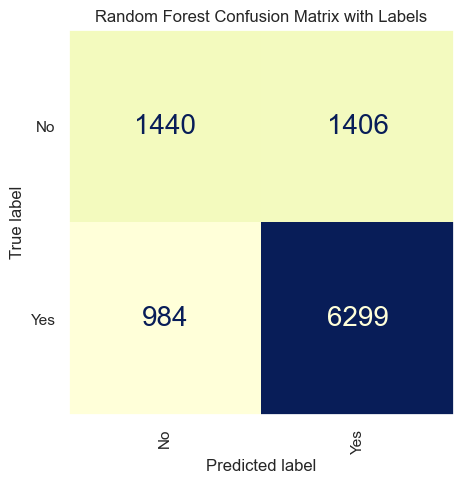

In [203]:
disp = ConfusionMatrixDisplay(confusion_matrix=Evaluation.ConfusionMatrix(y_test2, y_pred > 0.5), display_labels=['No', 'Yes'])
fig, ax = plt.subplots(figsize=(5,5))
disp.plot(cmap='YlGnBu', colorbar=False, xticks_rotation='vertical', values_format='d', ax=ax)
plt.title('Random Forest Confusion Matrix with Labels')
plt.rcParams['font.size'] = '20'
plt.grid(None)
plt.show()